<p style="font-size:32px;text-align:center"> <b>Predictive Equipment Failures</b> </p>

# 1. Introduction
A stripper well is an oil or gas well that is nearing the end of its economically useful life. In the United states most of the wells are classified as stripper well (nearly 80%). Despite of producing low volumes at well level, these stripper wells are responsible for a significant percentage of domestic oil production. In the year of 2015 10% of U.S oil production is accounted from stripper wells (<a href='https://www.eia.gov/todayinenergy/detail.php?id=26872'>eia article</a>). Because of low operational cost and low capital intensity of stripper well and providing a steady cash flow to fund operations, these are attractive to oil stripping companies. 

### Problem Statement

In case of any mechanical failure due to several reasons, repair cost raises along with the loss in oil production which directly effects to the cash flows in stripper well oil productions. ConocoPhillips has documented these failure events that occurred on surface equipment and downhole equipment. Total 107 sensors are used to collect variety of physical information both on surface and below the ground for each failure events. This case study is focuses on predicting the failures that occurs both on the surface and below the ground using the sensors data. This information will be used to send crews out to the well location to fix the surface equipment or send a workover rig to the well to pull downhole equipment and address the failure. This can minimize the cost associated with failures.

### Data Overview

- Data can be obtained from here. <a href='https://drive.google.com/file/d/1_bUwIHOero3szLzCQTREa3RCLMQJHkEL/view?usp=sharing'>Click here</a>

- Total 172 features are given in this dataset as below 
    - Id
    - Target
    - 107 Sensor data (170 features)

- Total 107 senson are used. 100 sensors has single readings and remaining 7 sensors has time based readings, i.e each sensor among these 7 has 10 time based readings. So total 70 features from these 7 sensors.

- This is a binary classification task where 'target' column has value 0 or 1. 'Target' value 0 indicates surface related failures and value 1 indicates downhole equipment failure occurred. 

### Performance matrix

- For this case study we will use F1-score as performace matrix.

# 2. Data Introduction

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os

import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
from collections import Counter
pd.set_option('display.max_columns', None)
from sklearn.preprocessing import MinMaxScaler 
from sklearn.manifold import TSNE
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.model_selection import train_test_split

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from tabulate import tabulate
from sklearn.metrics import roc_auc_score

In [2]:
# Import the given training dataset
project_data = pd.read_csv('equip_failures_training_set.csv')
project_data.head(5)

,id,target,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,1,0,76698,na,2130706438,280,0,0,0,0,0,0,37250,1432864,3664156,1007684,25896,0,2551696,0,0,0,0,0,4933296,3655166,1766008,1132040,0,0,0,0,1012,268,0,0,0,0,0,469014,4239660,703300,755876,0,5374,2108,4114,12348,615248,5526276,2378,4,0,0,2328746,1022304,415432,287230,310246,681504,1118814,3574,0,0,6700214,0,10,108,50,2551696,97518,947550,799478,330760,353400,299160,305200,283680,na,na,na,178540,76698.08,6700214,6700214,6599892,43566,68656,54064,638360,6167850,1209600,246244,2,96,0,5245752,0,916567.68,6,1924,0,0,0,118196,1309472,3247182,1381362,98822,11208,1608,220,240,6700214,na,10476,1226,267998,521832,42

In [3]:
print('Total rows: ', project_data.shape[0])
print('Total columns : ', project_data.shape[1])

Total rows:  60000
Total columns :  172


Total 172 features are present and 60000 data points.

In [4]:
# Check the column types of our dataset
project_data.dtypes.head(10)

id                         int64
target                     int64
sensor1_measure            int64
sensor2_measure           object
sensor3_measure           object
sensor4_measure           object
sensor5_measure           object
sensor6_measure           object
sensor7_histogram_bin0    object
sensor7_histogram_bin1    object
dtype: object

All the values from sensor should be a numerial value. But a lot of columns has 'na' as string. First replace these 'na' with nan for all columns in dataset and then change the column data type to numeric.

In [5]:
# Lot of columns values are 'na' change this nan
project_data = project_data.replace('na',np.nan)

In [6]:
# Change the column type from object to init
for col in project_data.columns:
    project_data[col] = pd.to_numeric(project_data[col])
project_data.dtypes.head(10)

id                          int64
target                      int64
sensor1_measure             int64
sensor2_measure           float64
sensor3_measure           float64
sensor4_measure           float64
sensor5_measure           float64
sensor6_measure           float64
sensor7_histogram_bin0    float64
sensor7_histogram_bin1    float64
dtype: object

In [7]:
project_data.head(5)

,id,target,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,1,0,76698,NaN,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,703300.0,755876.0,0.0,5374.0,2108.0,4114.0,12348.0,615248.0,5526276.0,2378.0,4.0,0.0,0.0,2328746.0,1022304.0,415432.0,287230.0,310246.0,681504.0,1118814.0,3574.0,0.0,0.0,6700214.0,0.0,10.0,108.0,50.0,2551696.0,97518.0,947550.0,799478.0,330760.0,353400.0,299160.0,305200.0,283680.0,NaN,NaN,NaN,178540.0,76698.08,6700214.0,6700214.0,6599892.0,43566.0,68656.0,54064.

In [162]:
project_data.describe()

,id,target,sensor1_measure,sensor2_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor38_measure,sensor39_measure,sensor40_measure,sensor41_measure,sensor42_measure,sensor43_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor68_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
count,60000.000000,60000.000000,6.000000e+04,13671.000000,5.666500e+04,4.513900e+04,57500.000000,57500.000000,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.935500e+04,5.937100e+04,5.937100e+04,5.560000e+04,5.935800e+04,5.937100e+04,5.935800e+04,5.941100e+04,5.935800e+04,5.941100e+04,57277.000000,5.937100e+04,5.937100e+04,5.937100e+04,57500.000000,57499.000000,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.9329

# 3. Exploratory Data Analysis

## 3.1 Target - Distribuition

Number of equipment failures in downhole  1000 , ( 1.6666666666666667 %)
Number of equipment failure on surface  59000 , ( 98.33333333333333 %)


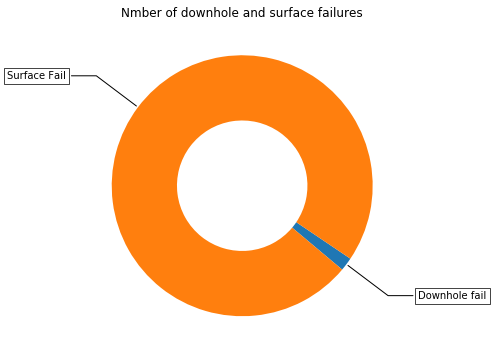

In [12]:
# https://matplotlib.org/gallery/pie_and_polar_charts/pie_and_donut_labels.html#sphx-glr-gallery-pie-and-polar-charts-pie-and-donut-labels-py

fail_counts = target.value_counts()
print("Number of equipment failures in downhole ", fail_counts[1], ", (", (fail_counts[1]/(fail_counts[1]+fail_counts[0]))*100,"%)")
print("Number of equipment failure on surface ", fail_counts[0], ", (", (fail_counts[0]/(fail_counts[1]+fail_counts[0]))*100,"%)")

fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(aspect="equal"))
recipe = ["Downhole fail", "Surface Fail"]

fail_data = [fail_counts[1], fail_counts[0]]

wedges, texts = ax.pie(fail_data, wedgeprops=dict(width=0.5), startangle=-40)

bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(xycoords='data', textcoords='data', arrowprops=dict(arrowstyle="-"),
          bbox=bbox_props, zorder=0, va="center")

for i, p in enumerate(wedges):
    ang = (p.theta2 - p.theta1)/2. + p.theta1
    y = np.sin(np.deg2rad(ang))
    x = np.cos(np.deg2rad(ang))
    horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
    connectionstyle = "angle,angleA=0,angleB={}".format(ang)
    kw["arrowprops"].update({"connectionstyle": connectionstyle})
    ax.annotate(recipe[i], xy=(x, y), xytext=(1.35*np.sign(x), 1.4*y),
                 horizontalalignment=horizontalalignment, **kw)

ax.set_title("Nmber of downhole and surface failures")

plt.show()

The data is highly imbalanced. Among 60000 data points only 1000 datapoints has target value as 1, i.e equipment failure in downhole. So while training we need to take care of our model, it should not get underfit towards 0's.

## 3.2 Analyse Time based sensor data

Here we have total 7 time based sensors and total 10 bins per sensor. Hence total 7*10 = 70 features present.

In [11]:
# Get all time based sensor column names (including all time bins)
hist_col =  [l for l in project_data.columns if 'histogram' in l]

# Get the sensors with time based data
hist_sensor =  [l.split("_")[0] for l in project_data.columns if 'histogram' in l]
hist_sensor = list(set(hist_sensor))

# sort the sensor names
dic = {}
for i, v in enumerate(hist_sensor):
    dic[int(hist_sensor[i].split('sensor')[1])] = v

hist_sensor_sort = []
for i in sorted(dic):
    hist_sensor_sort.append(dic[i])
print('Below sensors have time based readings.')
hist_sensor_sort

Below sensors have time based readings.


['sensor7',
 'sensor24',
 'sensor25',
 'sensor26',
 'sensor64',
 'sensor69',
 'sensor105']

### 3.2.1 Univariate analysis of all time based sensors

Histogram data of sensor7


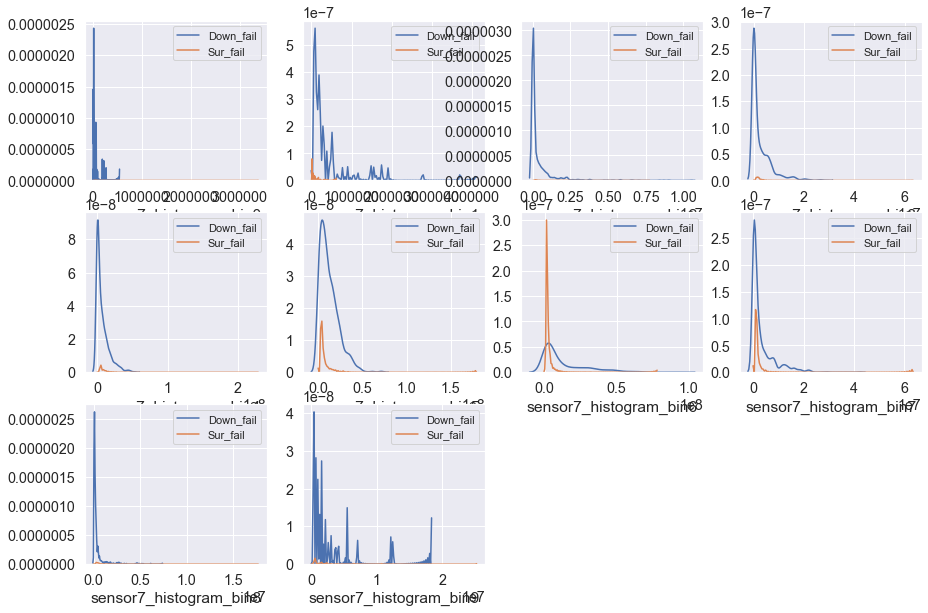

Histogram data of sensor24


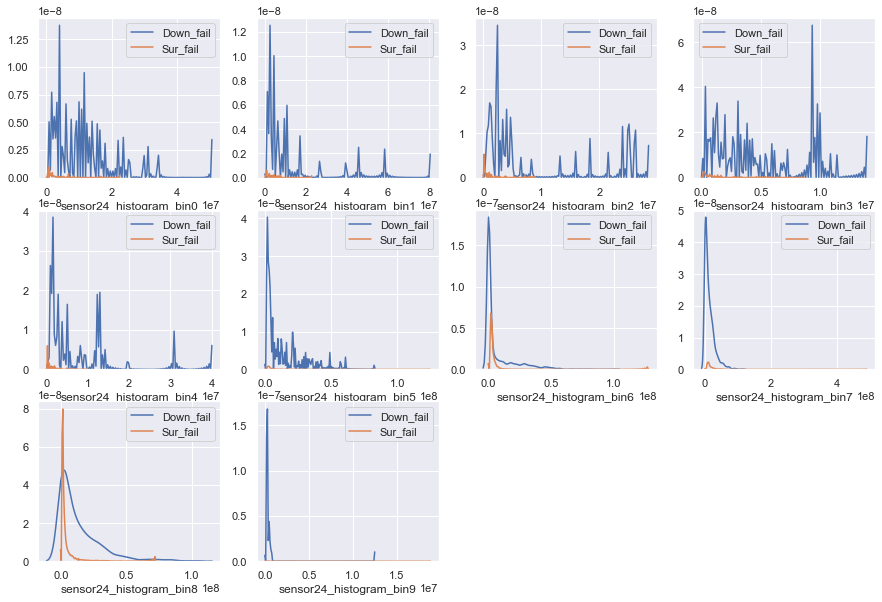

Histogram data of sensor25


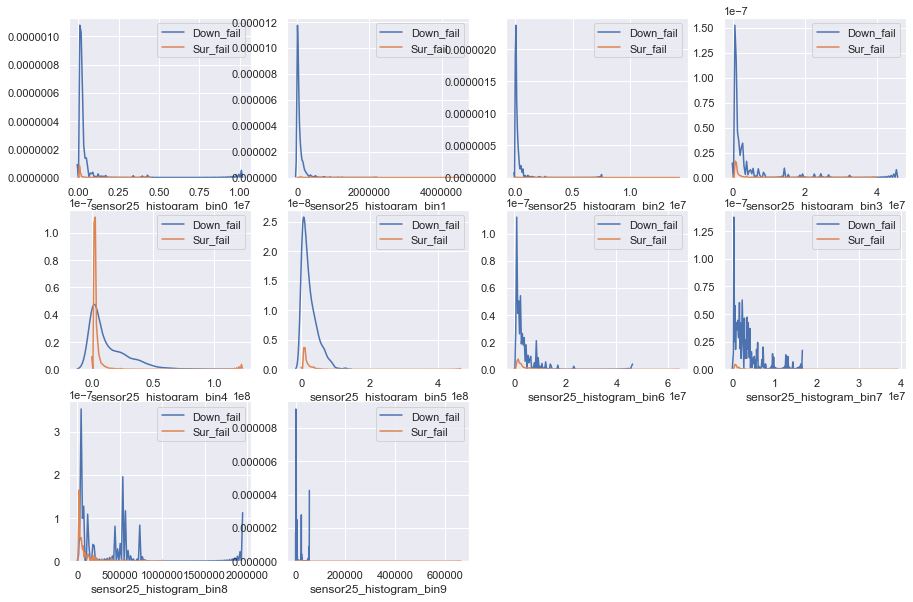

Histogram data of sensor26


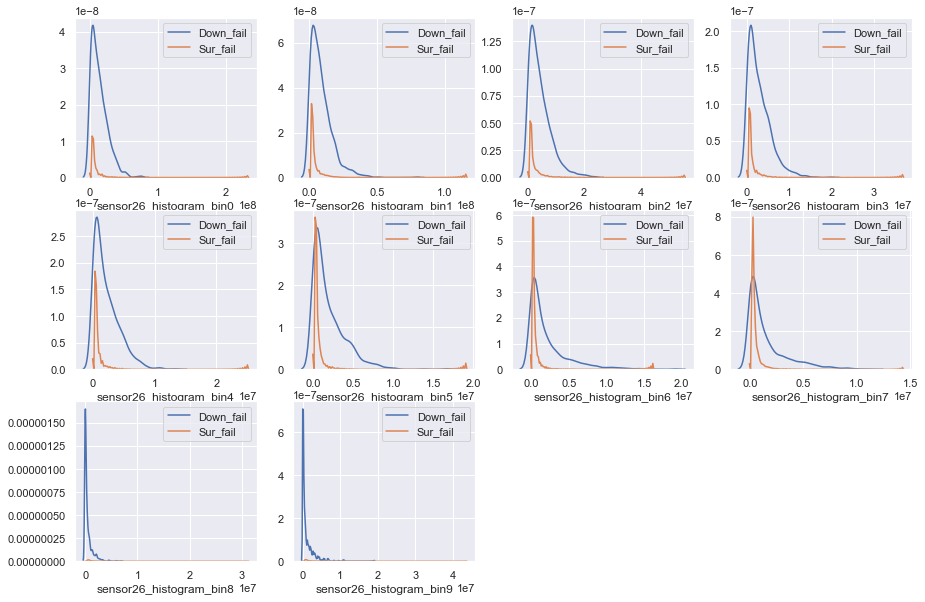

Histogram data of sensor64


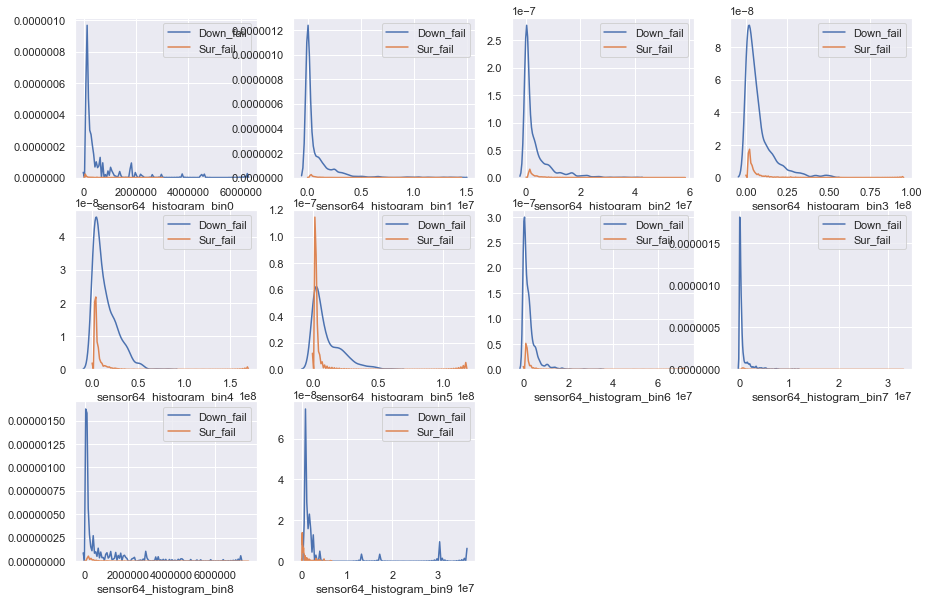

Histogram data of sensor69


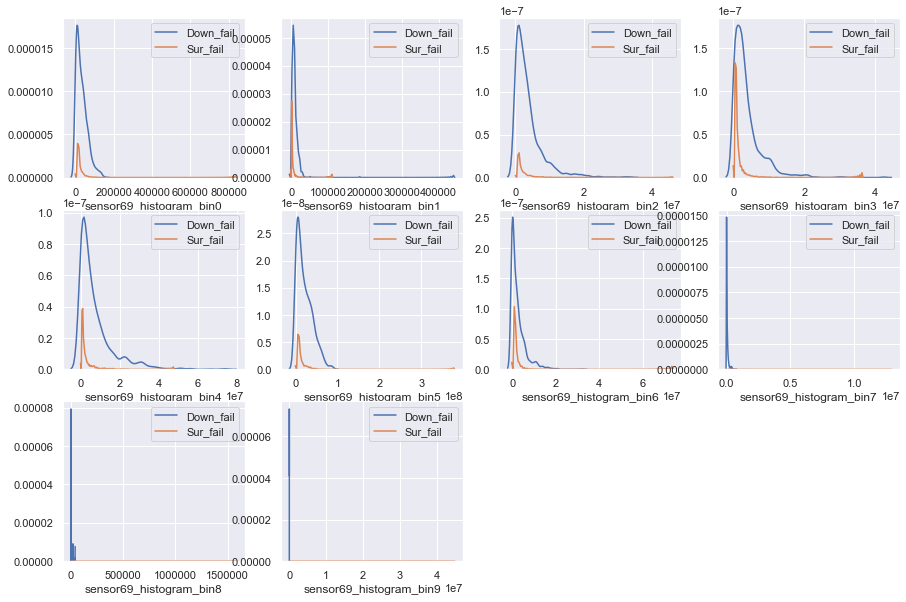

Histogram data of sensor105


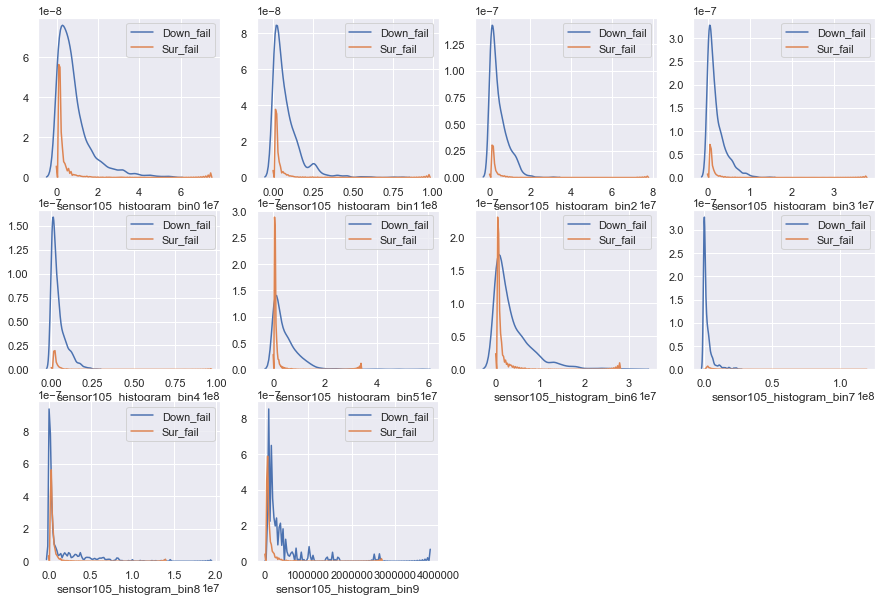

In [41]:
# Check for all time based sensor PDF to understand the time distribution more

for i in range(len(hist_sensor_sort)):
    print('Histogram data of {}'.format(hist_sensor_sort[i]))
    col = [l for l in hist_col if hist_sensor_sort[i] in l]
    temp = project_data[col]
    temp['target'] = project_data.iloc[:,1]
    
    ncols=4
    nrows=3
    fig, axs = plt.subplots(figsize=(15,10), ncols=4, nrows=3)
    sns.set(font_scale = 1.0)
    for i,ax in zip(range(10),axs.flat):
        temp_down = temp[temp['target']==1].iloc[:,i]
        temp_sur = temp[temp['target']==0].iloc[:,i]
        sns.distplot(temp_down, hist=False, ax=ax, label='Down_fail')
        sns.distplot(temp_sur, hist=False, ax=ax, label='Sur_fail')
    handles, labels = ax.get_legend_handles_labels()
    plt.legend(handles, labels, loc='upper center')
    fig.delaxes(axs[nrows-1][ncols-2])
    fig.delaxes(axs[nrows-1][ncols-1])
    plt.show()
    

#### Observation
- From the above univariate analysis we can see below time bins of sensors has more probability density when there is a downhole failure than surface failure.
          'sensor7_histogram_bin5','sensor24_histogram_bin8','sensor25_histogram_bin5','sensor26_histogram_bin5',
          'sensor64_histogram_bin3','sensor69_histogram_bin4','sensor105_histogram_bin0'
- Here we have selected one bin from each sensors which has least overlapping between PDF of downhole and surface failure.
- Lets keep this bins saved and perform a bivariant analysis on all time based sensors amoung their bins.

### 3.2.2 Bivariate analysis of selected features of time based sensors

Here we have ploted pairplot of the selected features from the above univariate analysis. 

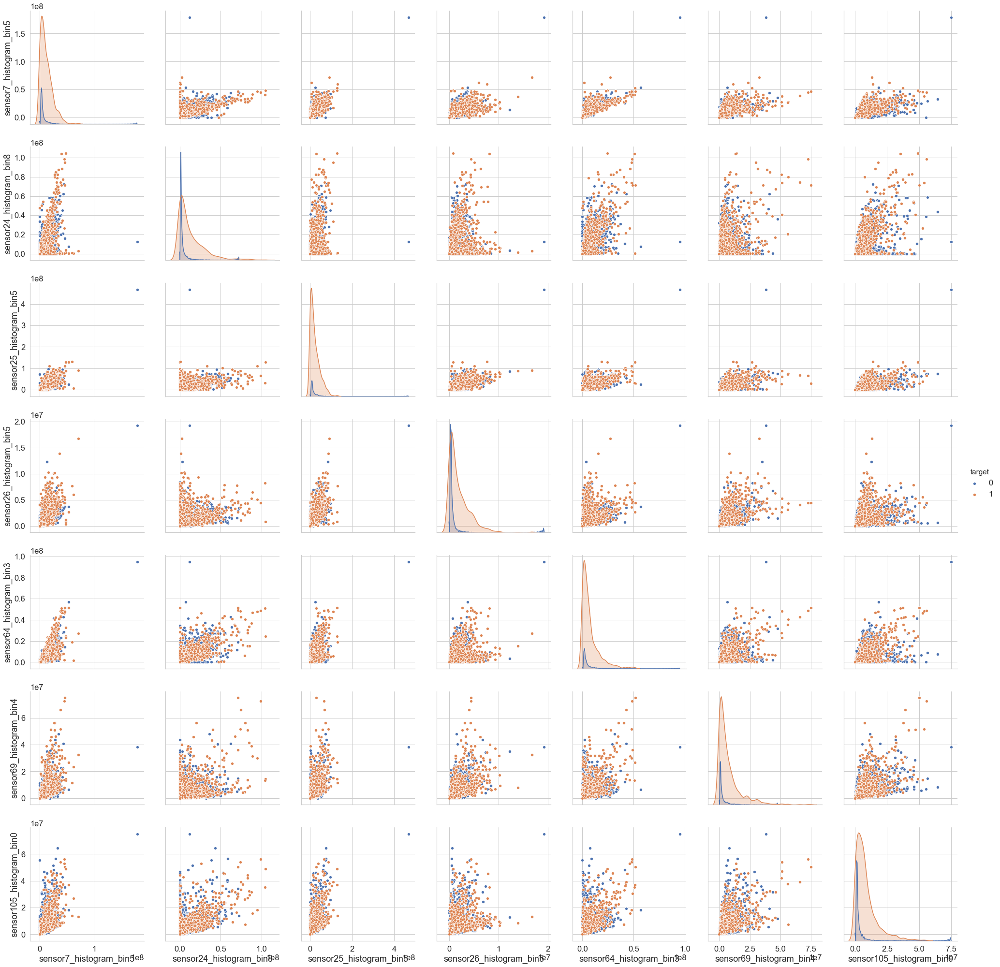

In [1080]:
# Pair plot for all selected features

col_name = ['sensor7_histogram_bin5','sensor24_histogram_bin8','sensor25_histogram_bin5','sensor26_histogram_bin5',
           'sensor64_histogram_bin3','sensor69_histogram_bin4','sensor105_histogram_bin0']

temp = project_data[col_name]
temp['target'] = project_data.iloc[:,1]

sns.set_style("whitegrid");
sns.set(font_scale = 1.5)
sns.pairplot(temp, hue='target', size=4, vars=col_name);
plt.show()

#### Observation
- Although we have imbalanced dataset, we can see in the above pairplot that most of the data points belongs to target 1 (orange color) i.e downhole failure. This implies for surface failure these features has very less data greater than zero or not Nan.
- From the above pair plot of 7 features, 'sensor7_histogram_bin5' and 'sensor26_histogram_bin5' features have high density of surface failures clustered together (blue color) near 0.5e8 on 'sensor7_histogram_bin5' axis.

### 3.2.3 Analyse Temoral nature of Time based sensors

- To analyse the temporal nature of all 7 sensors we will flatten all 10 time based sensor readings thoughout all data points for each sensors i.e in case of 'sensor7' we will add 10 time bins data in a list and extend this list for all 60000 datapoints. So At the end we will have 60000*10 = 600000 data points. These datapoints we will plot in line graph where left Y axis will the sensor values and x axis will be datapoint counts.
- Now to plot the target values in the same plot we will multiply each target value of 60000 datapoints with 10 and then extend for all atapoints. Hence again here too we will have 600000 data points. These target values we will plot in right Y axis.
- This new sensor and target data will be stored in a temp dataframe.

In [1083]:
# Define function to plot temporal nature of Time based sensors

def time_details(sensor, data):
    col = [l for l in hist_col if sensor in l]
    temp=[]
    for i in range(len(data)):
        a = list(data.iloc[i][col].values)
        temp.extend(a)
    
    temp1 = []
    for i in range(len(data)):
        b = [data.iloc[i]['target']] * 10
        temp1.extend(b)

    temp2 = pd.DataFrame(temp)
    temp2['2nd'] = temp1
    temp2.columns = ['sensor','target']
    return temp2

# For each time based sensor create temporary datframe as mentioned above and plot the same.

def time_based_plot(df):
    for sensor in hist_sensor_sort:
        temp = time_details(sensor, df)
        sns.set(font_scale = 1.5)
        fig = plt.figure(figsize=(20,5))
        ax1 = fig.add_subplot(111)
        ax2 = ax1.twinx()
        ax1.set_ylabel('{} reading'.format(sensor))
        ax2.set_ylabel('failure type')
        ax1.set_xlabel('Sensor time')

        temp['sensor'].plot(color=['red'],ax=ax1)
        temp['target'].plot(color=['blue'],ax=ax2)
        lines_1, label1 = ax1.get_legend_handles_labels()
        lines_2, label2 = ax2.get_legend_handles_labels()
        lines = lines_1 + lines_2
        labels = label1 + label2 

        ax2.legend(lines, labels, loc=1,fontsize=15)
        plt.title('Time analysis on bin based sensors')
        plt.show()

- Note that as per the above function we will have total 600000 datapoints. Plotting all in a single graph will not be interpretable. Hence after performing multiple range of the datasets we found 800 to 900 datapoints have five downhole failures in original dataframe. So we have ploted the range of 800 to 900 datapoints below.
- Plotting other consecutive rows giving less number of downhole failure. These rows are chosen just for interpretting the data easily.

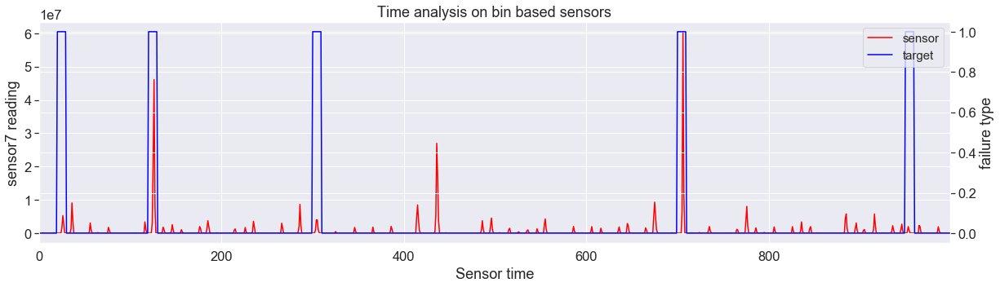

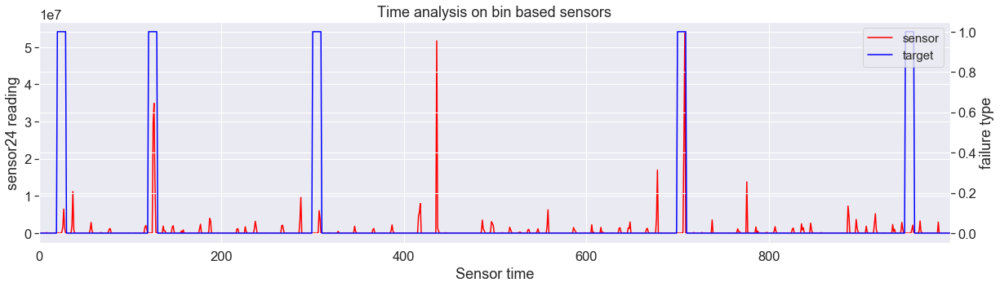

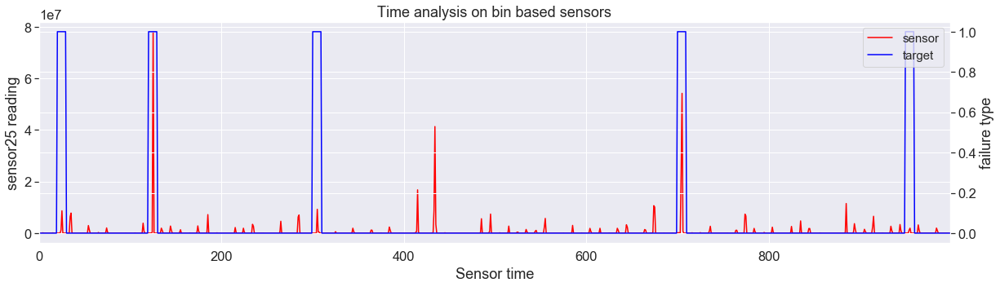

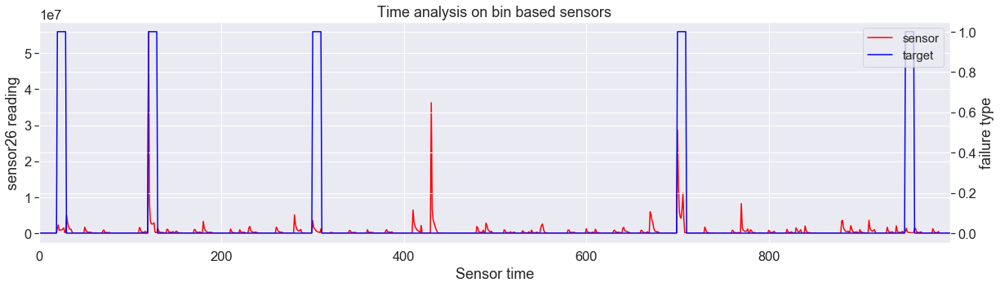

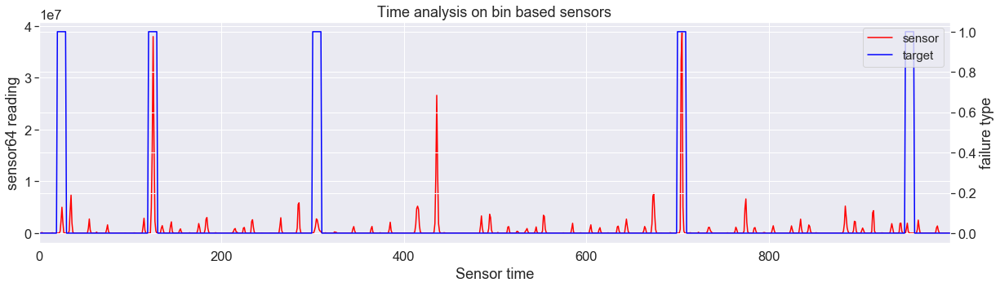

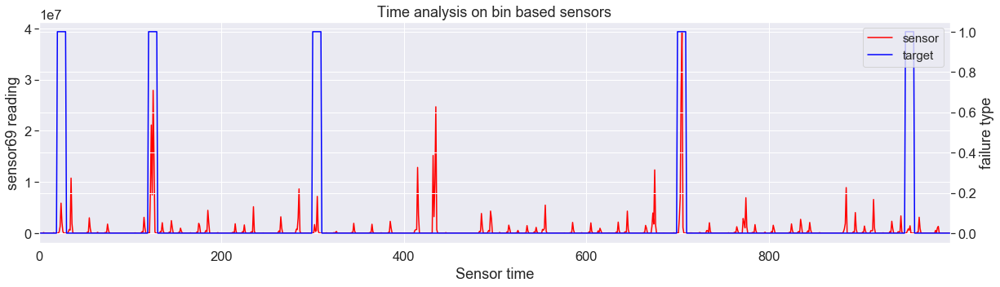

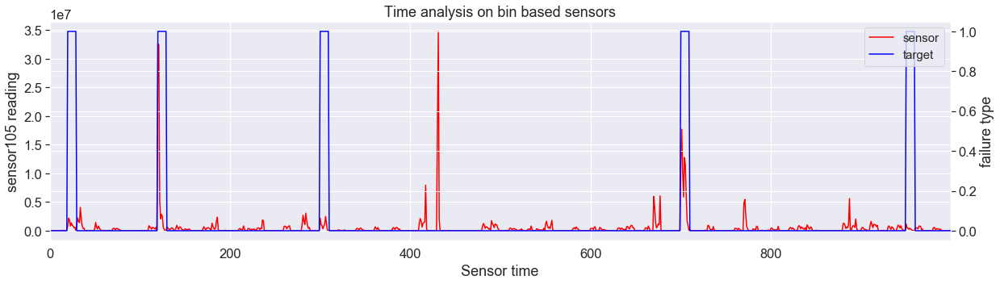

In [1084]:
# Data points between 800 to 900 rows of original dataframe is used to draw the below plots

time_based_plot(project_data[800:900])

#### Observation
- From the above plots we can see whenever there is a hike or peak in sensor reading the failure type moves to 1 i.e downhole failure.
- 'Sensor7', 'sensor24', 'sensor25' and 'sesor64' have miximum hike for downhole failure than 'sensor26', 'sensor69' and 'sensor105'.
- Other than downhole failures we can see all sensor values are very less for all 7 sensors hence failure type shows value as 0 i.e surface failure.

In the Above plots we have very less downhole failure i.e among 100 data points we had only 5 downhole failuer and 95 surface failure. 
In Below step we will try to sample 30 points from downhole failure and 70 points from surface failure and we will concat both the sample randomly and then try to plot the temporal nature as shown above.

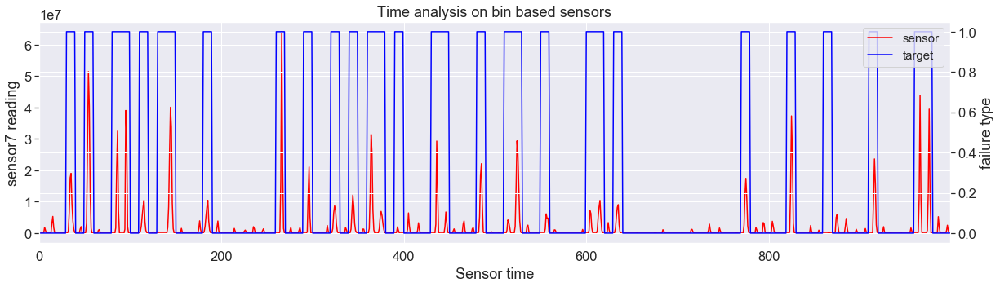

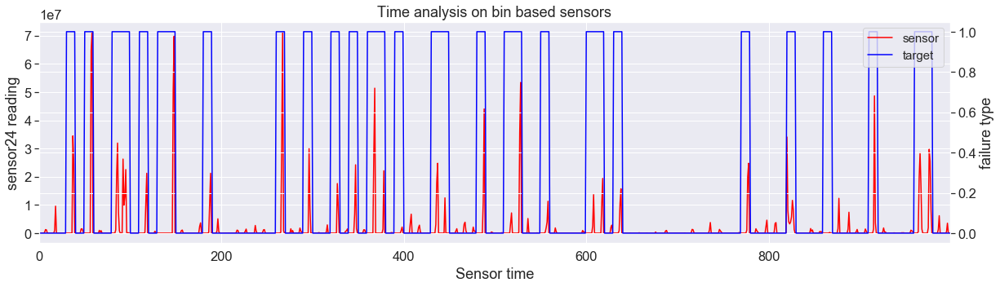

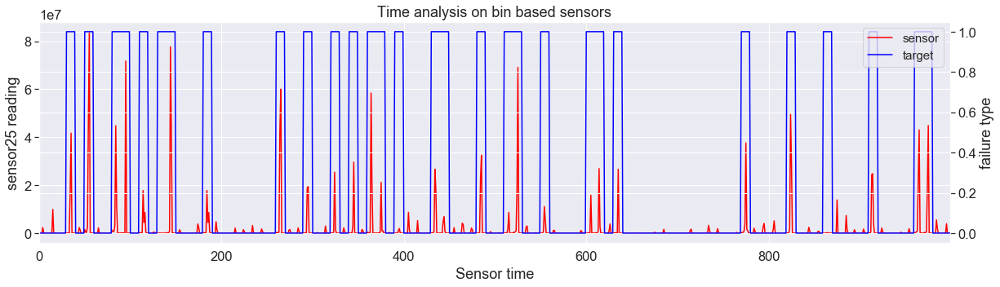

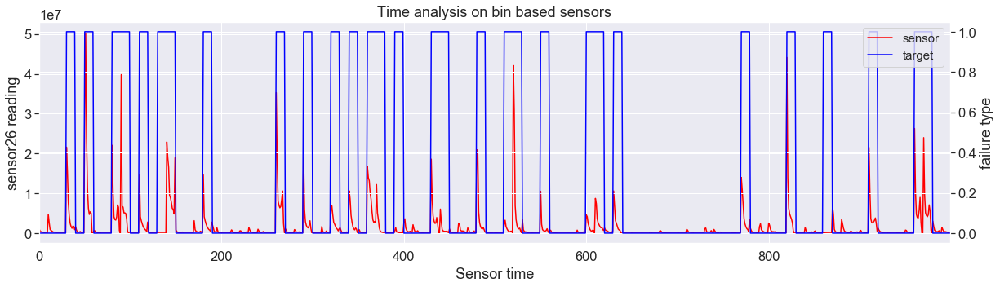

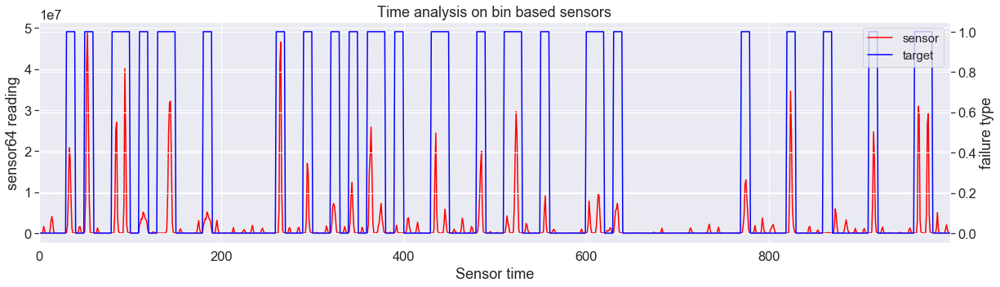

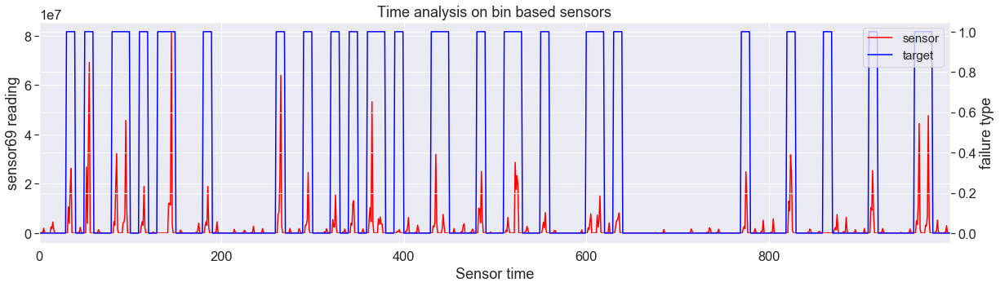

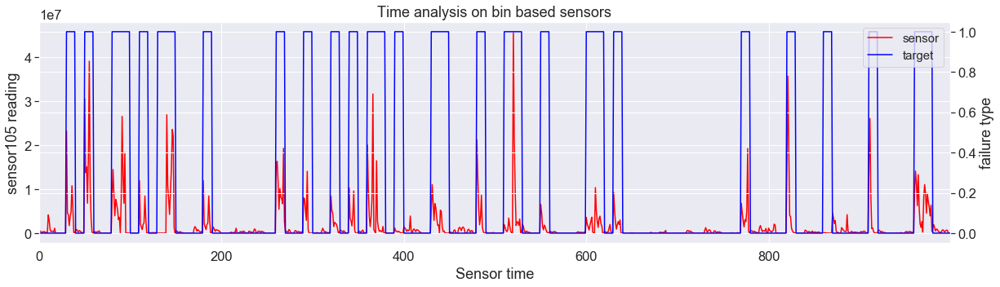

In [1085]:
# generate smaples of downhole and surface failures of 30 and 70 datapoints respectively and plot the temporal behaviour of these datapoints.
temp1 = project_data[project_data['target']==1].sample(n=30)
temp2 = project_data[project_data['target']==0].sample(n=70)
temp1 = pd.concat([temp1, temp2])
temp1 = temp1.sample(frac=1).reset_index(drop=True)

time_based_plot(temp1)

### Observation
- As seen in our previous plot here too we can see increasing sensor value indicates downhole failure.
- 'Sensor24' and 'sensor105' are more interpretable whenever there is a downhole failure.
- In 'sessor105' surface failure has very low sensor values compared to other sensors.

## 3.3 Analyse Non Time based sensor data

### 3.3.1 Univariate analysis of Non time based sensors

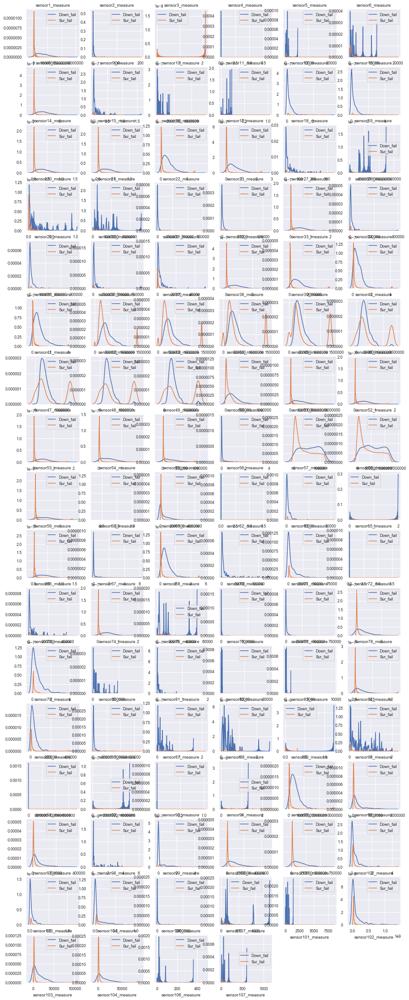

In [1098]:
# Get the non time based sensor column names
col_name  = [x for x in list(project_data.columns.values) if x not in hist_col]
col_name = [x for x in col_name if x not in ['id','target']]    
    
fig, axs = plt.subplots(figsize=(15,40), ncols=6, nrows=17)
sns.set(font_scale = 0.8)
for i,ax in zip(col_name,axs.flat):
    temp_down = project_data[project_data['target']==1][i]
    temp_sur = project_data[project_data['target']==0][i]
    sns.distplot(temp_down, hist=False, ax=ax, label='Down_fail').set_title(i)
    sns.distplot(temp_sur, hist=False, ax=ax, label='Sur_fail')
handles, labels = ax.get_legend_handles_labels()
plt.legend(handles, labels, loc='upper center')
fig.delaxes(axs[16][4])
fig.delaxes(axs[16][5])
plt.show()

#### Observation
- From all the above univariate analysis we have selected few sensors where downhole and surface failures are least overlapping.
    -'sensor1_measure','sensor8_measure','sensor14_measure','sensor17_measure','sensor27_measure',
     'sensor32_measure','sensor35_measure','sensor48_measure','sensor53_measure','sensor67_measure'
- Lets draw the CDF & PDF of these selected features.

### CDF and PDF of selected sensor features

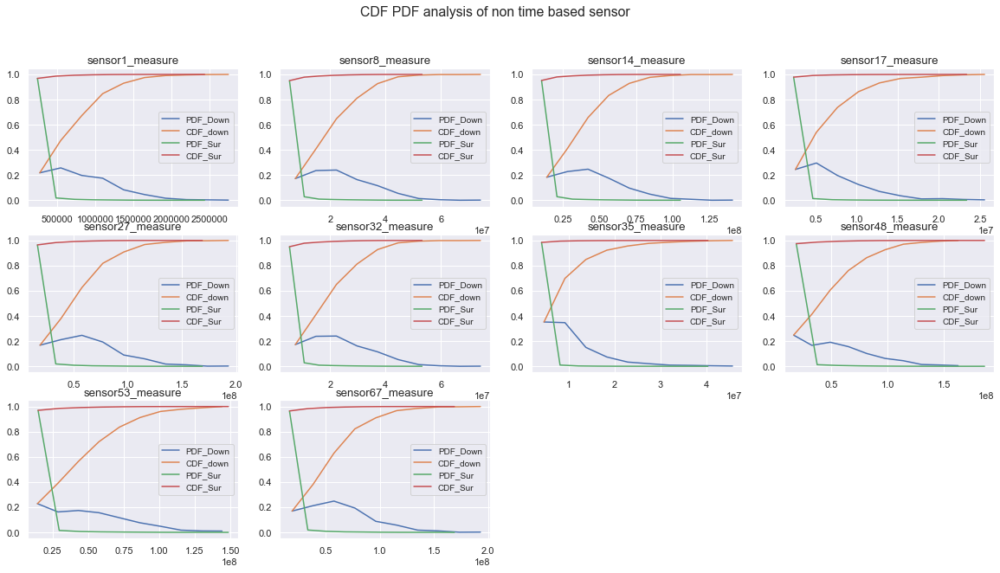

In [1123]:
col_name = ['sensor1_measure','sensor8_measure','sensor14_measure','sensor17_measure','sensor27_measure',
'sensor32_measure','sensor35_measure','sensor48_measure','sensor53_measure','sensor67_measure']


fig, axs = plt.subplots(figsize=(20,10), ncols=4, nrows=3)
sns.set(font_scale = 1.1)
for i,ax in zip(col_name,axs.flat):
    temp_down = project_data[project_data['target']==1][[i,'target']]
    temp_down = temp_down[~np.isnan(temp_down[i])];
    temp_sur = project_data[project_data['target']==0][[i,'target']]
    temp_sur = temp_sur[~np.isnan(temp_sur[i])];
    
    counts, bin_edges = np.histogram(temp_down[i], bins=10, density = True)
    pdf = counts/(sum(counts))
    cdf = np.cumsum(pdf)
    ax.plot(bin_edges[1:], pdf, label='PDF_Down')
    ax.plot(bin_edges[1:], cdf, label='CDF_down')
    
    counts, bin_edges = np.histogram(temp_sur[i], bins=10, density = True)
    pdf = counts/(sum(counts))
    cdf = np.cumsum(pdf)
    ax.plot(bin_edges[1:], pdf, label='PDF_Sur')
    ax.plot(bin_edges[1:], cdf, label='CDF_Sur')
    
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, labels,fontsize='10')
    ax.set_title(i)
fig.delaxes(axs[2][2])
fig.delaxes(axs[2][3])
fig.suptitle('CDF PDF analysis of non time based sensor')
plt.show()


### Observation
- From our previous analysis we noticed maximum of sensor values are near to zero for surface failures and same can be seen here too. All PDF's of surface failure has very high initial density and moving forward with the sensor values the density has reduced drastically. 
- For downhole failure all PDF has initial density between 2 to 3. For few of the sensors ('sensor8', 'sensor14','sensor27' and 'sensor32') the density has increased further unlike the other sensors.
- CDF of all sensors for downhole failure shows that more than 85% of data has value below mean of the sensor values.

### 3.3.2 Line Plot of non Time based sensor data

- Here we will line plot of all non time based sensors along with targets.
- In left Y axis we will plot Sessor values, in right Y axis we will plot the target value i.e 0 or 1.

In [1033]:
# Define function to line plot of each passed feature with target value

def plot_all_sensor(col_name, temp1):
    for sensor in col_name:
        #temp = time_details(sensor,temp1)
        sns.set(font_scale = 1.5)
        fig = plt.figure(figsize=(20,4))
        ax1 = fig.add_subplot(111)
        ax2 = ax1.twinx()
        ax1.set_ylabel('{} '.format(sensor))
        ax2.set_ylabel('failure type')
        ax1.set_xlabel('Sensor time')

        temp1[sensor].plot(color=['red'],ax=ax1)
        temp1['target'].plot(color=['blue'],ax=ax2)

        lines_1, label1 = ax1.get_legend_handles_labels()
        lines_2, label2 = ax2.get_legend_handles_labels()
        lines = lines_1 + lines_2
        labels = label1 + label2 

        ax2.legend(lines, labels, loc=1,fontsize=15)

        plt.title('Non time based Sensor data analysis')

        plt.show()

- As we have 60000 data points, for interpretabilty of downhole and surface failures together we will take random samples from whole dataset for downhole and surface failures.
- Lets have 30% of data of downhole failure and 70% data of surface failure. Note this percentage taken is for better visualization and interpretability.

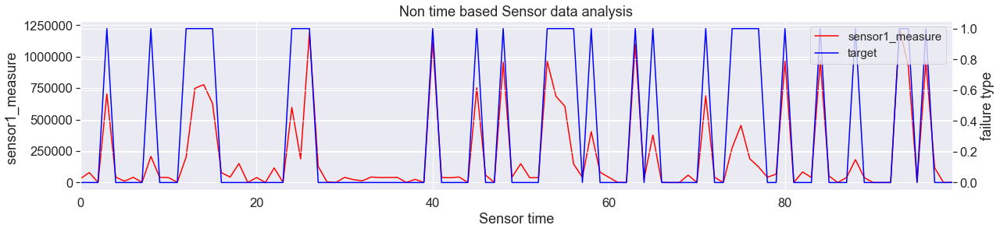

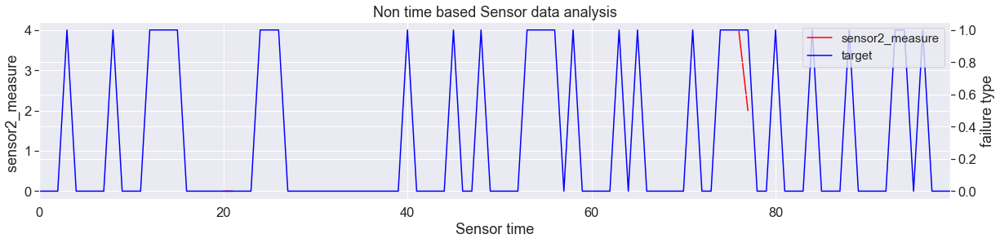

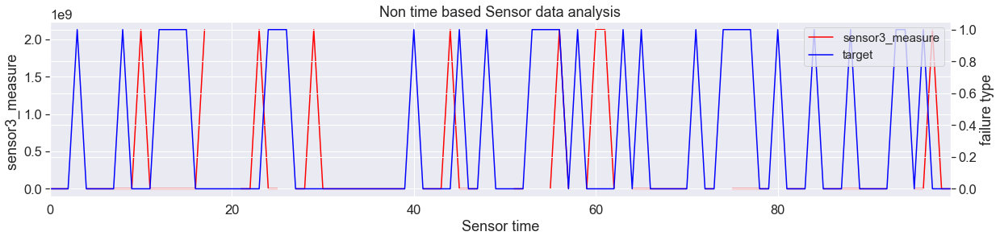

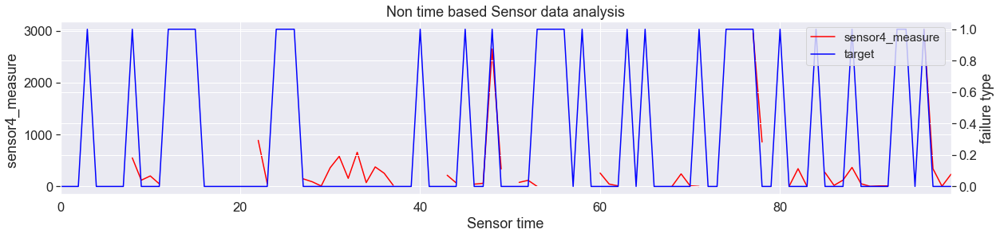

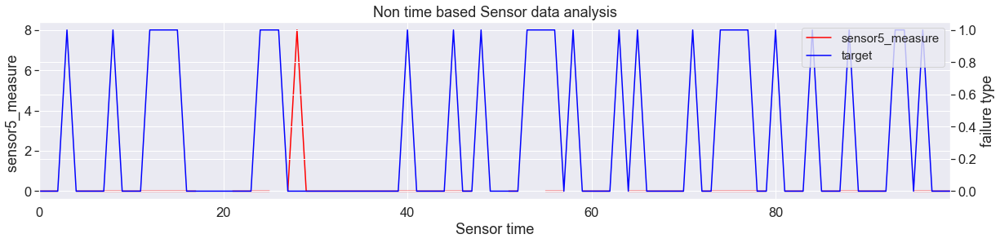

...

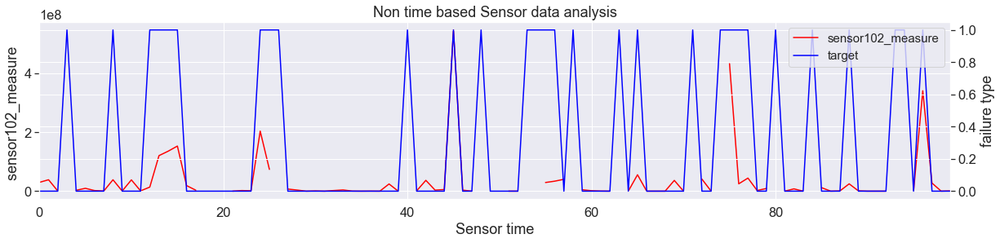

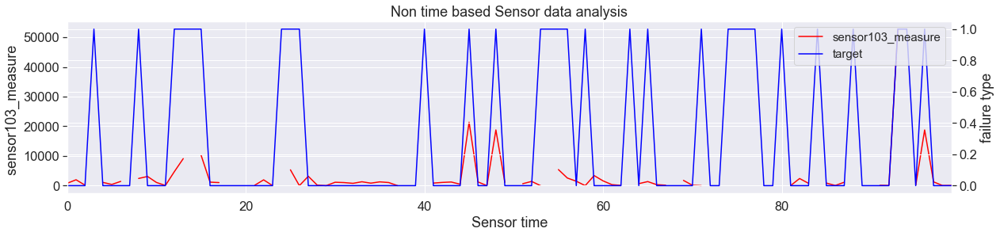

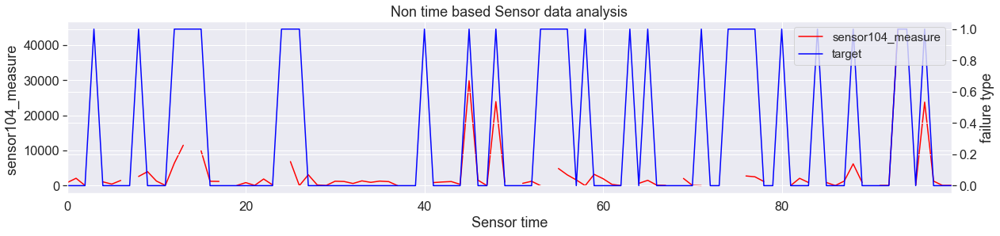

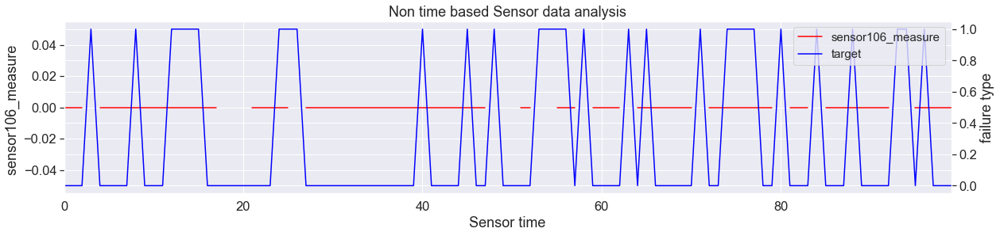

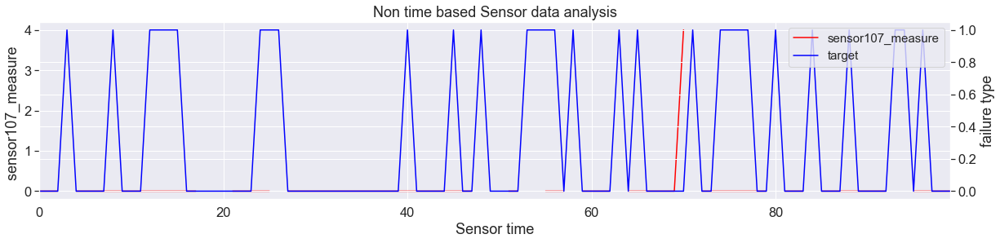

In [1030]:
temp1 = project_data[project_data['target']==1].sample(n=30)
temp2 = project_data[project_data['target']==0].sample(n=70)
temp1 = pd.concat([temp1, temp2])
temp1 = temp1.sample(frac=1).reset_index(drop=True)

col_name  = [x for x in list(project_data.columns.values) if x not in hist_col]
col_name = [x for x in col_name if x not in ['id','target']]

plot_all_sensor(col_name, temp1)

- In the above line plot we have total 100 sensor plots. We have chossen 10 sensors from all which has distinguishable values for downhole and surface failures.
- Below we have shown all the line plots of these selected sensors.

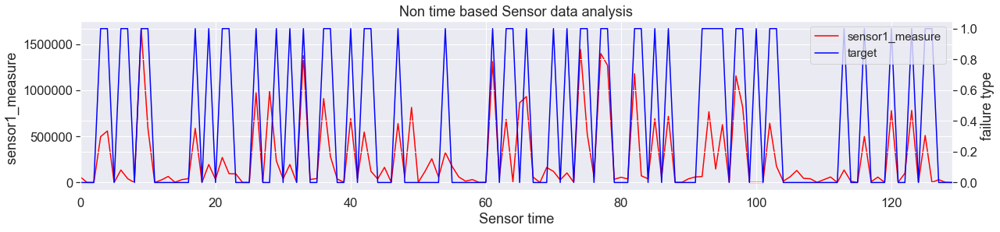

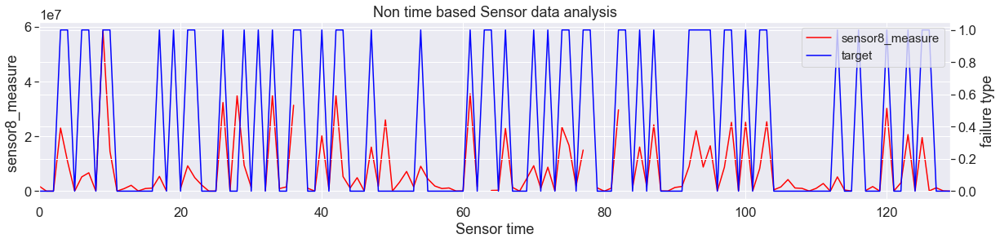

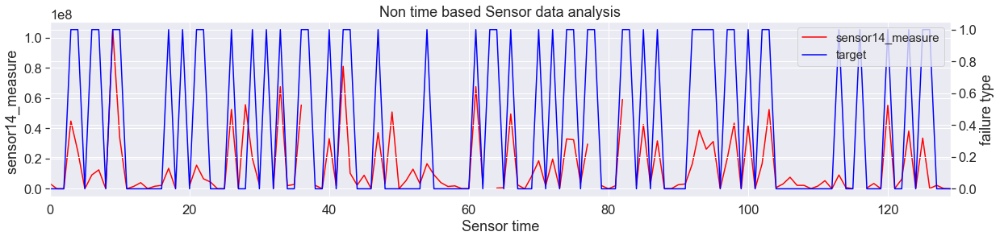

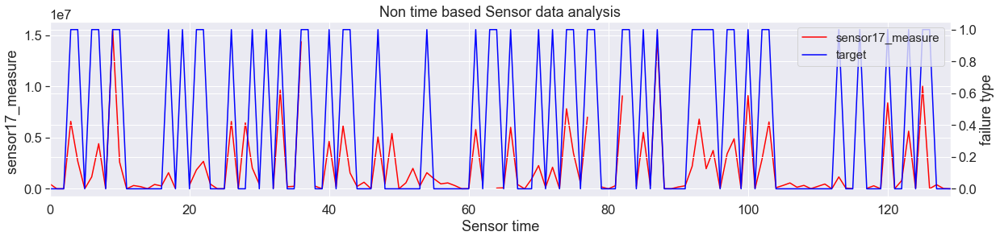

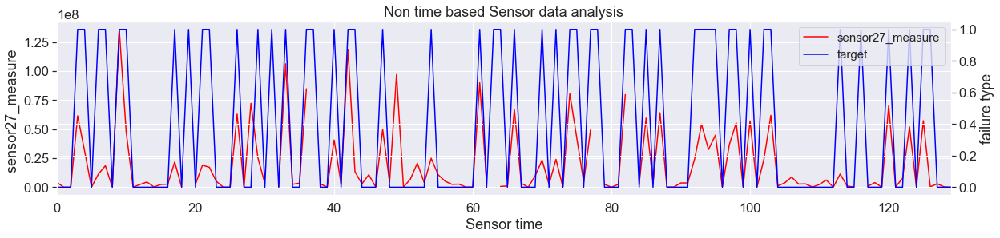

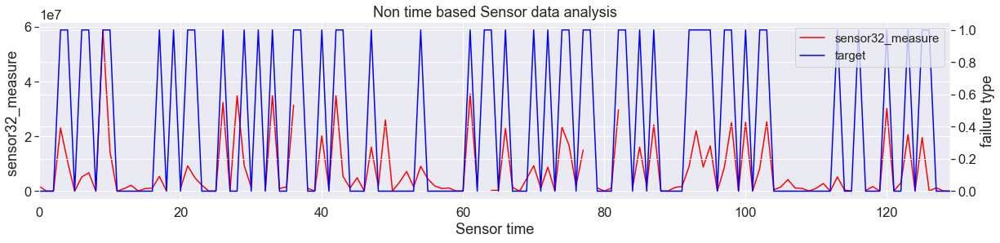

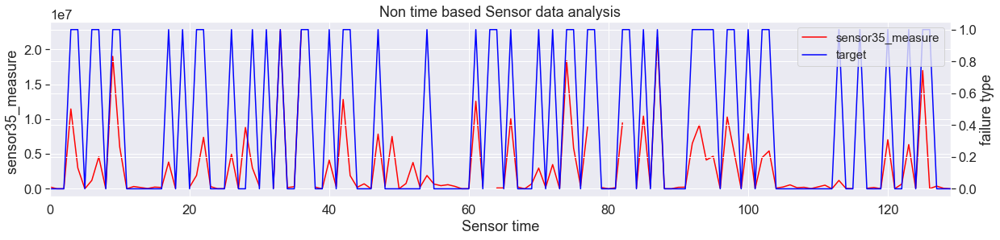

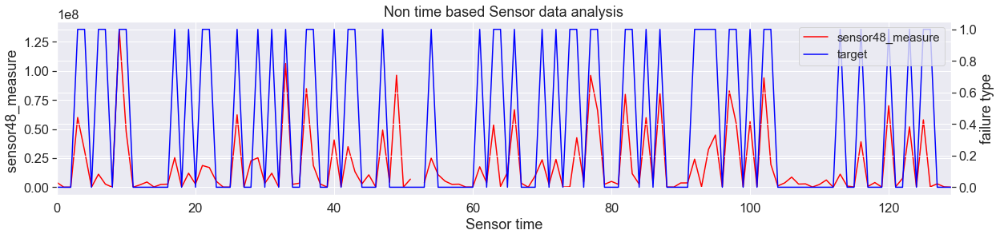

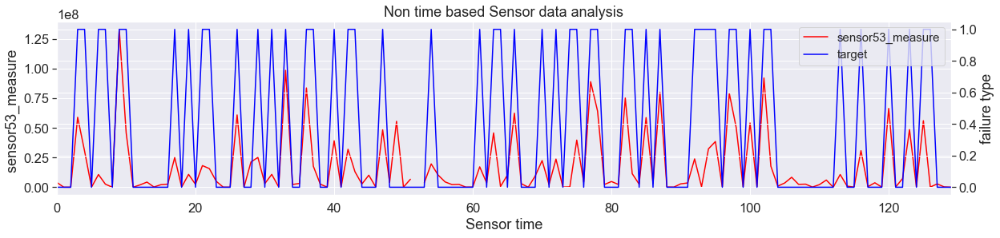

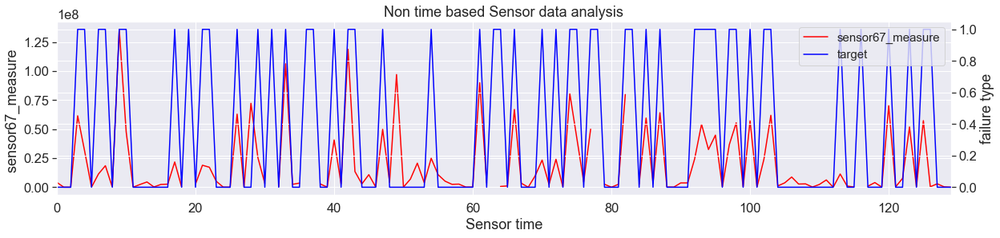

In [1034]:
col_name = ['sensor1_measure','sensor8_measure','sensor14_measure','sensor17_measure','sensor27_measure',
'sensor32_measure','sensor35_measure','sensor48_measure','sensor53_measure','sensor67_measure']

temp1 = project_data[project_data['target']==1].sample(n=50)
temp2 = project_data[project_data['target']==0].sample(n=80)
temp1 = pd.concat([temp1, temp2])
temp1 = temp1.sample(frac=1).reset_index(drop=True)

plot_all_sensor(col_name, temp1)

### Observation
- Similar to time based sensors here as well we can find most cases sensor values increased suddenly for downhole failures for all 10 sensors.
- 'sensor17' has most of its peach value for downhole failure and low values for surface failure compared to other sensors.

### 3.3.3 Boxplot of the selected non Time based sensors

Plot boxplot of all ten sensors we selected in the above step.

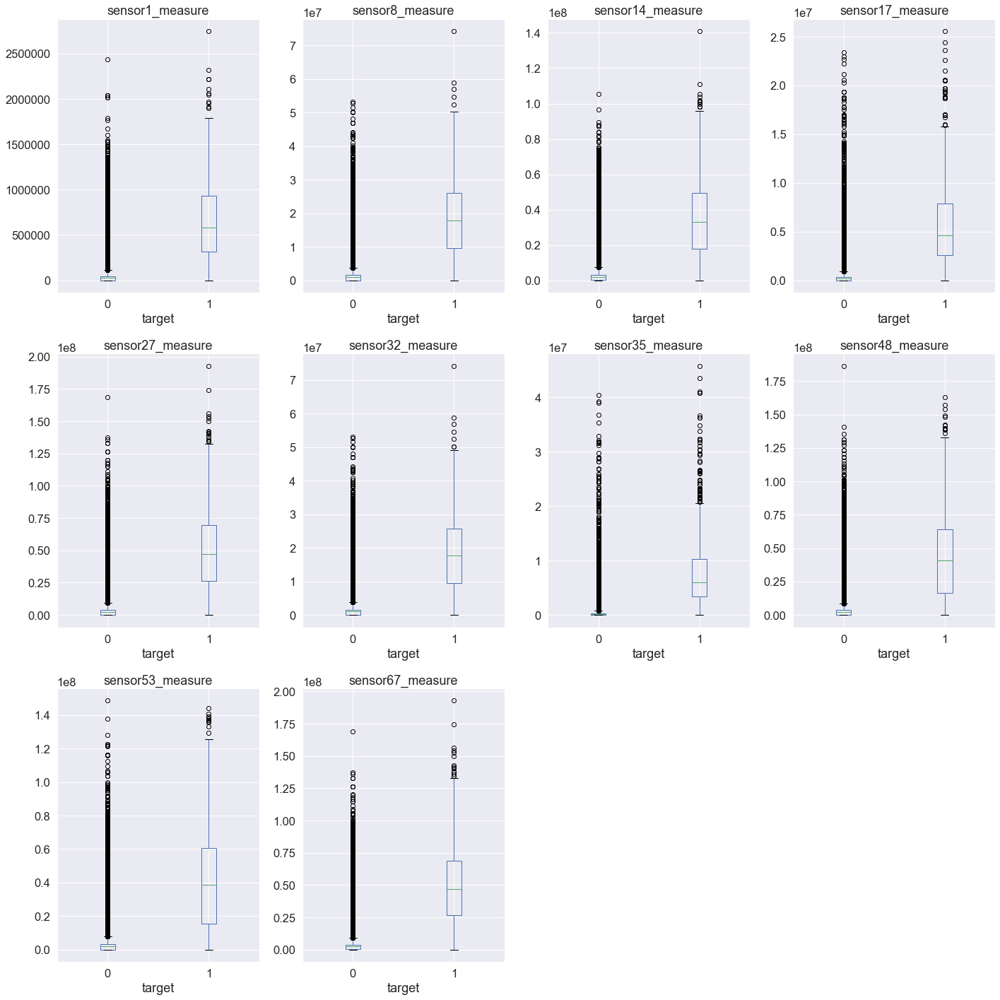

In [1076]:
col_name = ['sensor1_measure','sensor8_measure','sensor14_measure','sensor17_measure','sensor27_measure',
'sensor32_measure','sensor35_measure','sensor48_measure','sensor53_measure','sensor67_measure']

temp = project_data[col_name]
temp['target']=project_data[['target']]

fig, axes = plt.subplots(figsize=(20,20), ncols=4, nrows=3)
for i,ax in zip(range(len(col_name)), axes.flat ):
    el = col_name[i]
    temp.boxplot(el, by="target", ax=ax)
        
plt.suptitle(' ')
fig.delaxes(axes[2,2])
fig.delaxes(axes[2,3])
plt.tight_layout() 
plt.show()

### Observation
- Here we can find in all box plots the maximum value of surface failure is below than 25% percentile value of downholw failures. Hence in the above line plot we found that for every downhole failure sensor data increased suddenly.
- Also the IQR range of surface failure for all the above sensors is near to zero.

## 3.4 Analyse Nan values in all sensor data

Lets analyse the Nan value presence in all sensor with both failure types.

In [12]:
# Print the sensors name and percentage of nan value pressent in it in descending order

na_data = project_data.iloc[:,2:].isna().sum().sort_values(ascending = False)/project_data.shape[0]
na_data.head(10)

sensor43_measure    0.821067
sensor42_measure    0.812033
sensor41_measure    0.795667
sensor40_measure    0.772217
sensor68_measure    0.772150
sensor2_measure     0.772150
sensor39_measure    0.733483
sensor38_measure    0.659150
sensor37_measure    0.454617
sensor36_measure    0.383900
dtype: float64

In [914]:
# Analyse all sensor with NAN values and their surface and downhole failure counts

def plot_nan_dist(col_name):
    temp2 = pd.DataFrame(columns=['target','sensor_na','total','Avg','sensor'])
    for c in col_name:
        temp = project_data[[c]]
        temp['sensor_na'] = temp.isna().sum(axis=1).apply(lambda x:0 if x==0 else 1)
        temp = temp[['sensor_na']]
        temp['target']= project_data.iloc[:,1]
        col1= 'target'
        col2='sensor_na'
        col3='total'
        temp1 = pd.DataFrame(temp.groupby(col1)[col2].agg(lambda x: x.eq(1).sum())).reset_index()

        # Pandas dataframe grouby count: https://stackoverflow.com/a/19385591/4084039
        temp1['total'] = pd.DataFrame(temp.groupby(col1)[col2].agg({'total':'count'})).reset_index()['total']
        temp1['Avg'] = pd.DataFrame(temp.groupby(col1)[col2].agg({'Avg':'mean'})).reset_index()['Avg']
        temp1['sensor'] = c
        temp1.sort_values(by=['total'],inplace=True, ascending=False)
        temp2 = temp2.append(temp1)

    sns.set(font_scale = 1.0)
    fig = plt.figure(figsize=(20,5))
    ax1 = fig.add_subplot(111)
    ax2 = ax1.twinx()
    ax1.set_ylabel('Total Surface failure')
    ax2.set_ylabel('Total downhole failure')
    ax1.set_xlabel('Sensor Name')

    width=0.2

    p1= temp2[temp2['target']==0][[col3]].plot(kind='bar',color=['yellow'],width=width,ax=ax1,position=1)
    p2 =temp2[temp2['target']==0][[col2]].plot(kind='bar',color=['green'],width=width,ax=ax1,position=1)
    p3 =temp2[temp2['target']==1][[col3]].plot(kind='bar',color=['orange'],width=width,ax=ax2,position=0)
    p4 =temp2[temp2['target']==1][[col2]].plot(kind='bar',color=['blue'],width=width,ax=ax2,position=0)

    lines_1,_ = ax1.get_legend_handles_labels()
    lines_2,_ = ax2.get_legend_handles_labels()
    lines = lines_1 + lines_2
    labels = ['Total surface fail','Nan surface failure'] + ['Total downhole fail','Nan downhole failure']

    ax2.legend(lines, labels, loc=0,fontsize=15)

    ax2.set_xticklabels(list(temp2[temp2['target']==0]['sensor'].values))
    plt.title('Nan value count in surface and downhole failures')
    plt.show()

Here we have ploted all sensors (including tim based sensors) with their Nan count for downhole failure and surface failure.

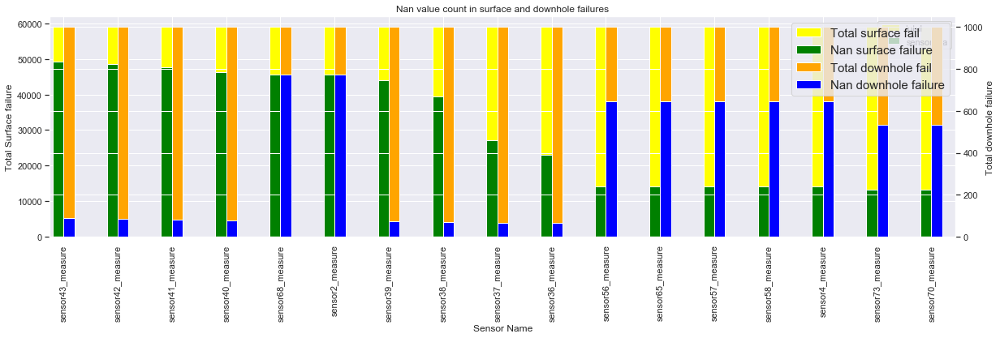

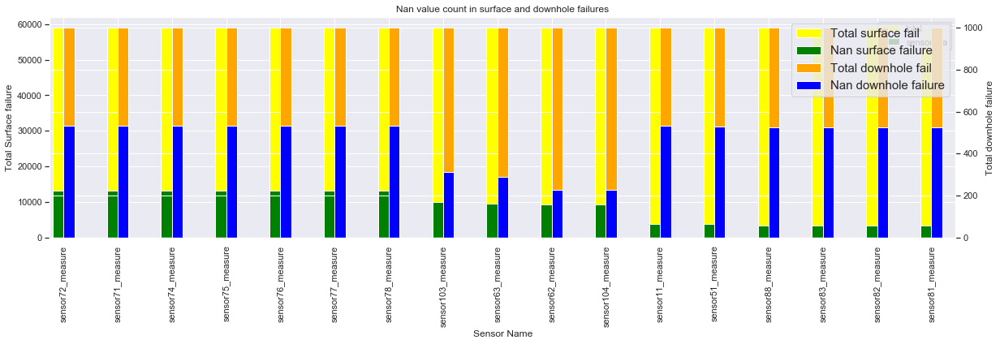

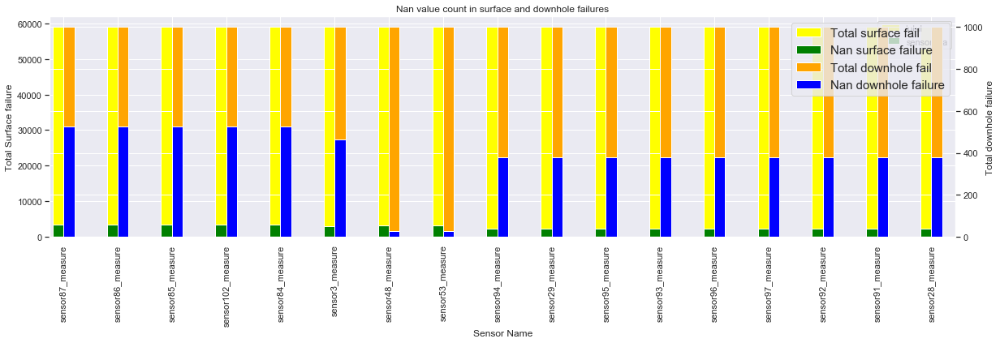

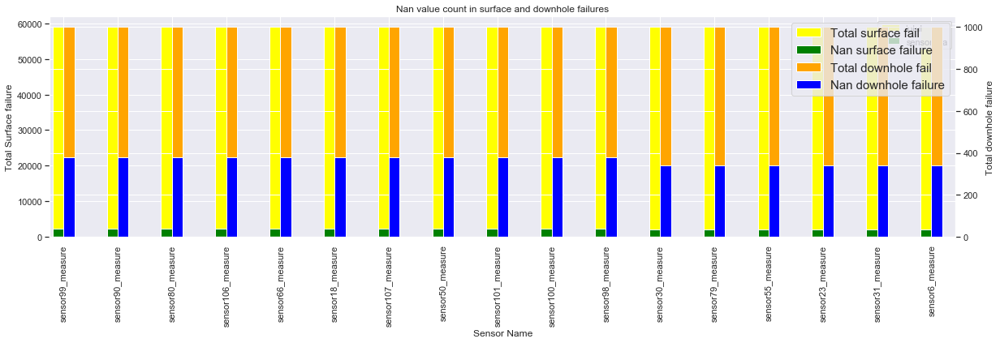

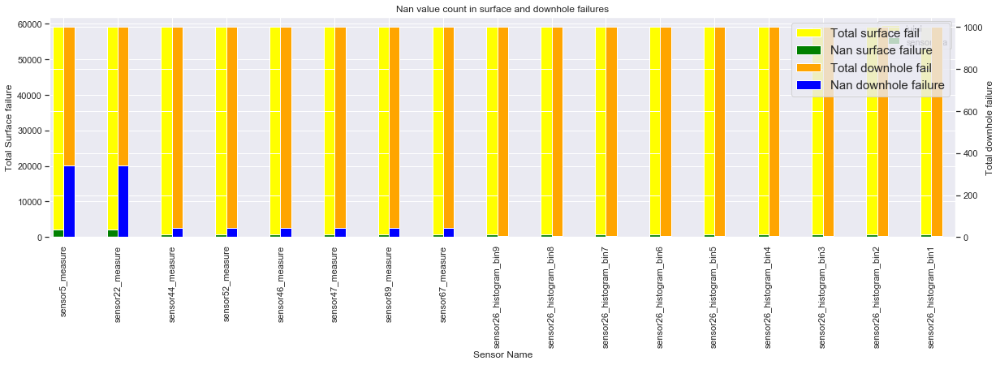

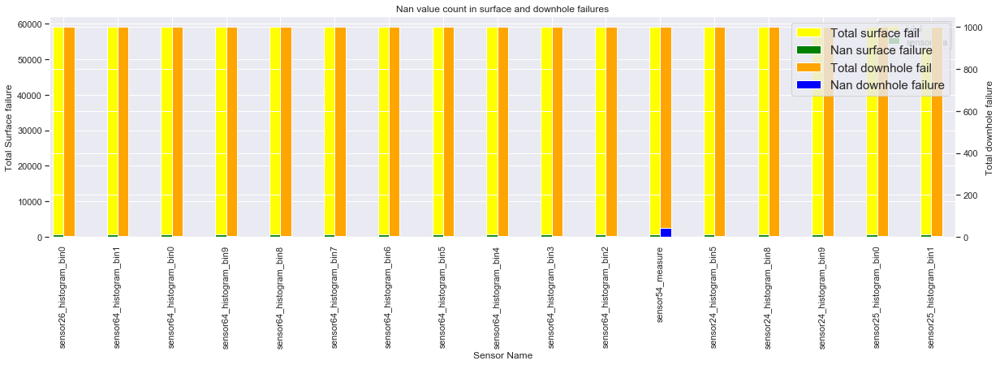

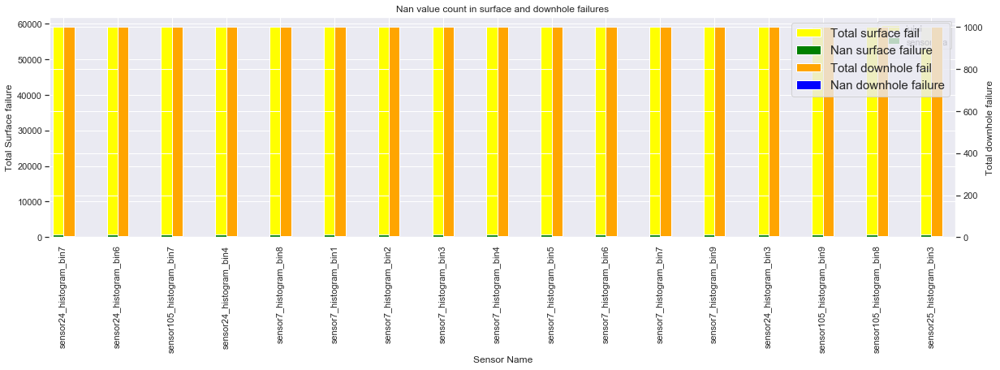

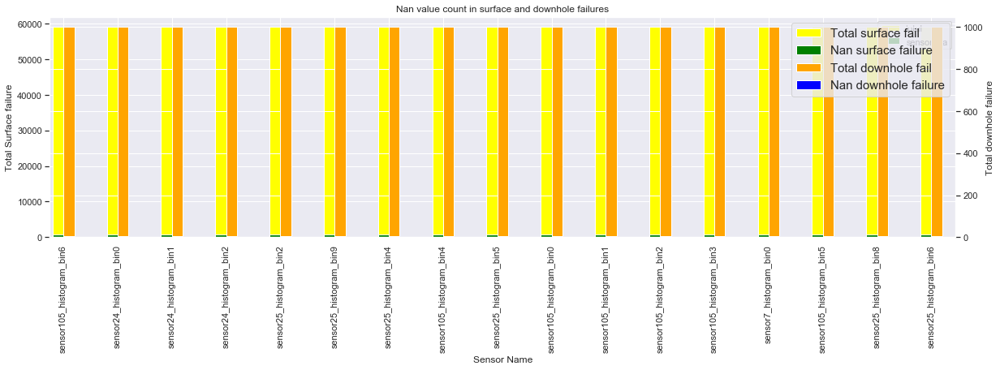

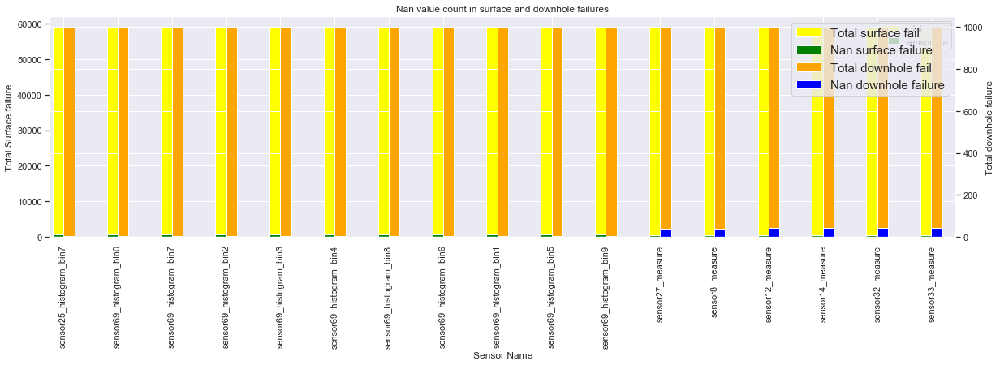

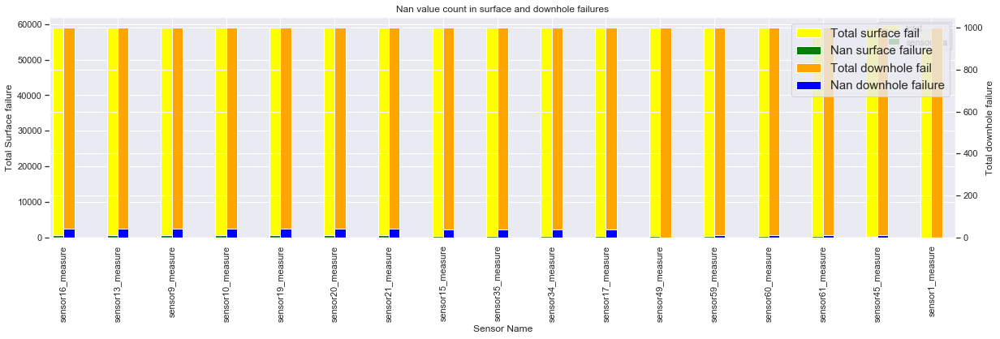

In [915]:
# As we have total 170 sensor features, we will plot 10 bar plots with each 17 sensor data.

for i in range(10):
    col_name = na_data.index[(i*17):(i*17)+17]
    plot_nan_dist(col_name)

### Observation
- Here we have ploted all sensors in descending order of Nan value presence.
- 'sensor43' has most no of Nan values (nearly 83% of total data) whereas 'sensor1' has 0 number of Nan values.
- We can see first 70 features (sensors) has a large number of Nan values. 
- Most of the features has very less Nan values. Hence we can not conclude any relationship between the failure type and Nan value presence.

## 3.5 Get Sensor details

Here we will try to get all detail infomation of all sensors. Below are the details we have calculated.
   - Max of sensor data
   - Min of sensor data
   - Max of surface failure
   - Min of surface failure
   - Max of Downhole failure
   - min of Downhole failure
   - Mean of sensor data
   - Median of sensor data
   - Mean of surface failure
   - Median of surface failure
   - Mean of Downhole failure
   - Median of Downhole failure
   - 25 percentile 
   - 50 percentile
   - 75 percentile

In [871]:
# reference https://www.kaggle.com/garteb/eda-of-sensors-data-phase-1

def get_sensor_details(col_name, df1):
    temp = pd.DataFrame()
    columns=['Sensor','Max','Min','Max_sur_fail','Min_sur_fail','Max_down_fail','Min_down_fail','Mean','Median',
             'Mean_sur_fail','Median_sur_fail','Mean_down_fail','Median_down_fail','Qt_0.25','Qt_0.5','Qt_0.75']
    for col in col_name:
        #print(col)
        A, B, C = df1[col].quantile([0.25,0.5,0.75]).values
        temp_s = df1[df1['target']==0][col]
        temp_d = df1[df1['target']==1][col]
        temp2 = pd.Series([col, max(df1[col]), min(df1[col]), max(temp_s), min(temp_s), max(temp_d), min(temp_d), 
                           df1[col].mean() ,df1[col].median(),temp_s.mean(),temp_s.median(),temp_d.mean(),temp_d.median(),
                           A, B, C], name='Details')
        temp2.index = columns
        temp = temp.append(temp2)
    temp = temp[columns]
    return temp

col_name = project_data.iloc[:,2:].columns
detail_sensor = get_sensor_details(col_name, project_data)

In [875]:
detail_sensor.head(16)

,Sensor,Max,Min,Max_sur_fail,Min_sur_fail,Max_down_fail,Min_down_fail,Mean,Median,Mean_sur_fail,Median_sur_fail,Mean_down_fail,Median_down_fail,Qt_0.25,Qt_0.5,Qt_0.75
Details,sensor1_measure,2.746564e+06,0.0,2.434708e+06,0.0,2.746564e+06,0.0,5.933650e+04,30776.0,4.916977e+04,30416.0,6.591737e+05,584994.0,834.0,30776.0,48668.0
Details,sensor2_measure,NaN,NaN,NaN,NaN,4.800000e+01,0.0,7.131885e-01,0.0,6.987055e-01,0.0,1.563319e+00,0.0,0.0,0.0,0.0
Details,sensor3_measure,2.130707e+09,0.0,2.130707e+09,0.0,2.130706e+09,0.0,3.560143e+08,152.0,3.588573e+08,150.0,5.940968e+07,865.0,16.0,152.0,964.0
Details,sensor4_measure,8.584298e+09,0.0,8.584298e+09,0.0,NaN,NaN,1.906206e+05,126.0,1.921137e+05,124.0,2.262214e+03,648.0,24.0,126.0,430.0
Details,sensor5_measure,2.105000e+04,0.0,2.105000e+04,0.0,5.386000e+03,0.0,6.819130e+00,0.0,6.664802e+00,0.0,2.013050e+01,0.0,0.0,0.0,0.0
Details,sensor6_measure,2.007000e+04,0.0,2.007000e+04,0.0,1.128400e+04,0.0,1.100682e+01,0.0,1.049784e+01,0.0,5.490744e+01,0.0,0.0,0.0,0.0
Details,sensor7_histogram_bin0,3.376892e+06,0.0,3.376892e+06,0.0,5.448660e+05,0.0,2.216364e+02,0.0,1.885413e+02,0.0,2.159926e+03,0.0,0.0,0.0,0.0
Details,sensor7_histogram_bin1,4.109372e+06,0.0,6.182120e+05,0.0,4.109372e+06,0.0,9.757223e+02,0.0,1.201361e+02,0.0,5.108507e+04,0.0,0.0,0.0,0.0
Details,sensor7_histogram_bin2,1.055286e+07,0.0,7.771682e+06,0.0,1.055286e+07,0.0,8.606015e+03,0.0,1.915646e+03,0.0,4.004426e+05,2208.0,0.0,0.0,0.0
Details,sensor7_histogram_bin3,6.340207e+07,0.0,6.340207e+07,0.0,2.904730e+07,0.0,8.859128e+04,0.0,4.540666e+04,0.0,2.617797e+06,402419.0,0.0,0.0,0.0


From the above information we can identify below few points.
- Difference between max and min is very large. Hence we need to perform normalization or standardization.
- Mean of surface failure and median of surface failure is lesser than mean of downhole failure and median of downhole failure. This is the same we understood from time based and non time based sensor analysis where we noticed that for dowhole failure sensor values are increasing suddenly.
- Also as per the IQR values (25 perntile and 75 percentile), mean values for surface and downhole failures are much higher. Hence while imputing Nan values we have to use median insted of mean value.

## 3.6 Correlation

Plot correlation matrix of all 170 features

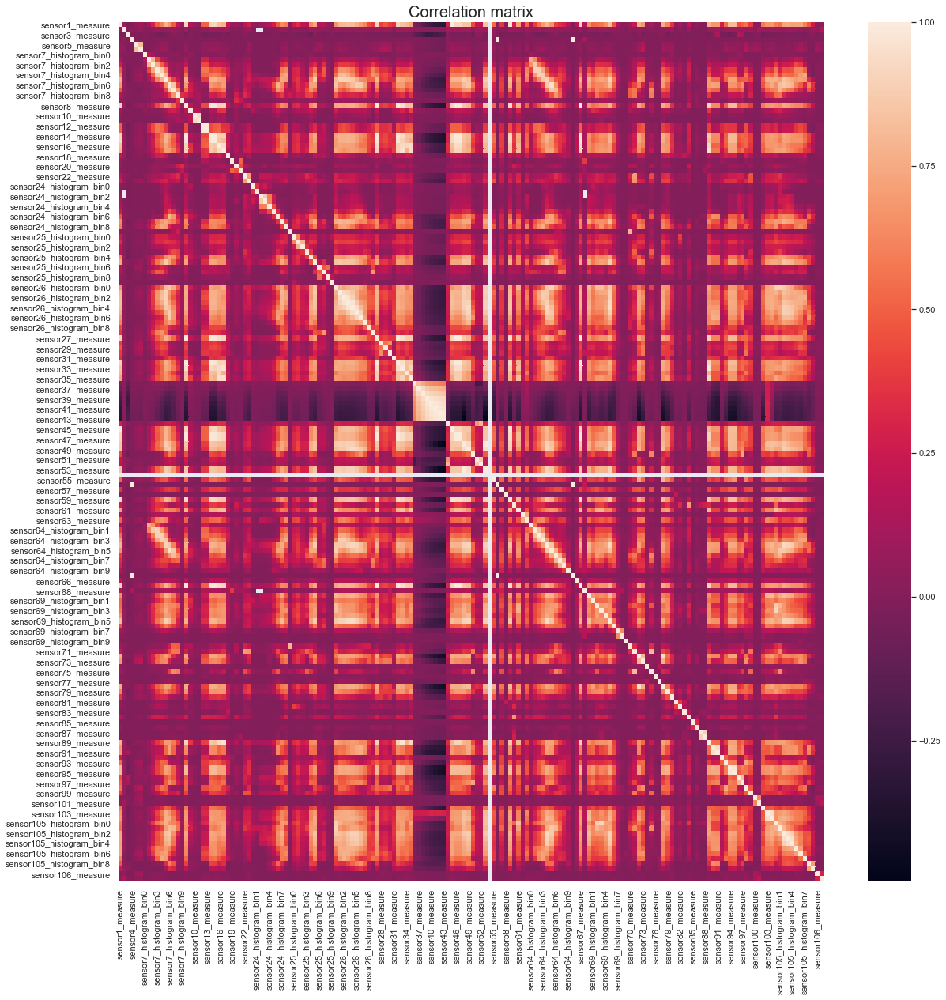

In [921]:
col_name = project_data.iloc[:,2:].columns
corr= project_data[col_name].corr()
plt.figure(figsize=(20,20))

sns.heatmap(corr)
plt.title('Correlation matrix', fontsize=20)
plt.show()

### Observation
- Here we can find lot of correlation. 'Sensor14' and 'sensor44' has high positive correlation.
- Again sensor37 to Sensor43 has negative correlation with almost all sensors (dark colored for negative correlation).
- Compared to non time based sensors, time based sensors has less correlation with other sensors.

# 4. Data preprocessing

Lets check Nan value count in each sensor data.

In [70]:
# Check the missing value count
project_data.isna().sum().head(10)

id                            0
target                        0
sensor1_measure               0
sensor2_measure           46329
sensor3_measure            3335
sensor4_measure           14861
sensor5_measure            2500
sensor6_measure            2500
sensor7_histogram_bin0      671
sensor7_histogram_bin1      671
dtype: int64

In [71]:
# Total missing fields accross all features
print('Total missing values accross all features :', sum(project_data.isna().sum()))

Total missing values accross all features : 850015


As per our analysis (from 3.4) check the nan value presence in all sensors.

In [72]:
na_data.head(10)

sensor43_measure    0.821067
sensor42_measure    0.812033
sensor41_measure    0.795667
sensor40_measure    0.772217
sensor68_measure    0.772150
sensor2_measure     0.772150
sensor39_measure    0.733483
sensor38_measure    0.659150
sensor37_measure    0.454617
sensor36_measure    0.383900
dtype: float64

Lets drop the top 8 sensor data where more than 50% data are missing as imputing these missing value may lead us to biased dataset.

In [73]:
col_name = list(na_data.index[0:8])
# Drop sensor54_measure feature
data = project_data.drop(columns=col_name, axis=1)

In [1575]:
drop_columns = list(na_data.index[0:8])

In [74]:
data.shape

(60000, 164)

Impute all missing values with median as we already found that our dataset has a wide range of data present where high values are very less. Considering mean will give us high value which can make our dataset biased.

In [75]:
# Fill nan values with column median
data = data.iloc[:,2:].fillna(data.median())
target = project_data.iloc[:,1]
data.head(5)

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,76698,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,703300.0,755876.0,0.0,5374.0,2108.0,4114.0,12348.0,615248.0,5526276.0,2378.0,4.0,0.0,0.0,2328746.0,1022304.0,415432.0,287230.0,310246.0,681504.0,1118814.0,3574.0,0.0,0.0,6700214.0,0.0,10.0,108.0,50.0,2551696.0,97518.0,947550.0,799478.0,330760.0,353400.0,178540.0,76698.08,6700214.0,6700214.0,6599892.0,43566.0,68656.0,54064.0,638360.0,6167850.0,1209600.0,246244.0,2.0,96.0,0.0,5245752.00,0.0,916567.68,6.0,1924.0,0.0,0.0,0.0,118196.0,1309472.0,3247182.0,1381362.0,98822.0,11208.0,1608.0,220.0,240.0,6700214.0,10476.0

As the sensor data are highly distributed, perform normalization to keep all values within 0 to 1 range.

In [1574]:
df.shape

(60000, 162)

In [76]:
# Normalize the training data
df = data.values
scaler = MinMaxScaler()
scaler.fit(df)
df = scaler.transform(df)
data = pd.DataFrame(df, columns=data.columns,index=data.index)
data.head(5)

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor54_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure
0,0.027925,9.999998e-01,3.261769e-08,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000163,0.007996,0.038972,0.015907,0.001463,0.0,0.034368,0.0,0.000000,0.0,0.000000,0.00000,0.035022,0.029911,0.022660,0.044285,0.0,0.0,0.0,0.0,0.001274,0.002297,0.0,0.0,0.0,0.0,0.000000,0.003754,0.033205,0.001436,0.007229,0.0,0.000531,0.000465,2.893584e-04,0.000271,5.000101e-03,0.011813,3.681733e-05,1.021497e-07,0.0,0.0,0.010000,0.008791,0.007444,0.007777,0.012332,0.035479,0.058892,0.000250,0.000000,0.000000,0.034739,0.000000,0.000033,0.000133,0.000979,0.034368,0.030469,0.021086,0.017480,0.252354,0.269627,0.172130,0.027925,0.034739,0.034739,0.035415,0.043479,0.001693,0.446972,0.527780,0.041502,0.0,0.050171,2.329835e-10,0.004486,0.0,0.037208,0.0,0.016536,0.000046,0.026223,0.0

Check if any value is constant through out all data point for any features.

In [77]:
# Check if any features has a constant value
temp = data.nunique().reset_index()
temp.columns = ['column','unique_values']
temp[temp.unique_values == 1]

,column,unique_values
82,sensor54_measure,1


Drop feature 'sensor54_measure' as it has costant value through out the whole dataset.

In [78]:
# Drop sensor54_measure feature
data.drop(columns=['sensor54_measure'], axis=1, inplace=True)

In [1570]:
drop_columns.append('sensor54_measure')

In [1571]:
drop_columns

['sensor43_measure',
 'sensor42_measure',
 'sensor41_measure',
 'sensor40_measure',
 'sensor68_measure',
 'sensor2_measure',
 'sensor39_measure',
 'sensor38_measure',
 'sensor54_measure']

In [79]:
data.shape

(60000, 161)

# 5. Visualization using Dimention reduction technique t-SNE

In [32]:
# performs t-sne with different perplexity values and their repective plots..

def perform_tsne(X_data, y_data, perplexities, n_iter=1000, img_name_prefix='t-sne'):
        
    for index,perplexity in enumerate(perplexities):
        # perform t-sne
        print('\nperforming tsne with perplexity {} and with {} iterations at max'.format(perplexity, n_iter))
        X_reduced = TSNE(verbose=0, perplexity=perplexity).fit_transform(X_data)
        
        # prepare the data for seaborn         
        #print('Creating plot for this t-sne visualization..')
        df = pd.DataFrame({'x':X_reduced[:,0], 'y':X_reduced[:,1] ,'label':y_data})
        
        # draw the plot in appropriate place in the grid
        sns.lmplot(data=df, x='x', y='y', hue='label', fit_reg=False, size=8,\
                   palette="Set1",markers=['1','2'])
        plt.title("perplexity : {} and max_iter : {}".format(perplexity, n_iter))
        img_name = img_name_prefix + '_perp_{}_iter_{}.png'.format(perplexity, n_iter)
        #print('saving this plot as image in present working directory...')
        plt.savefig(img_name)
        plt.show()


Perform  t-SNE for different value of perplexity (2,10,30,50) with no of iteration as 1000.


performing tsne with perplexity 2 and with 1000 iterations at max


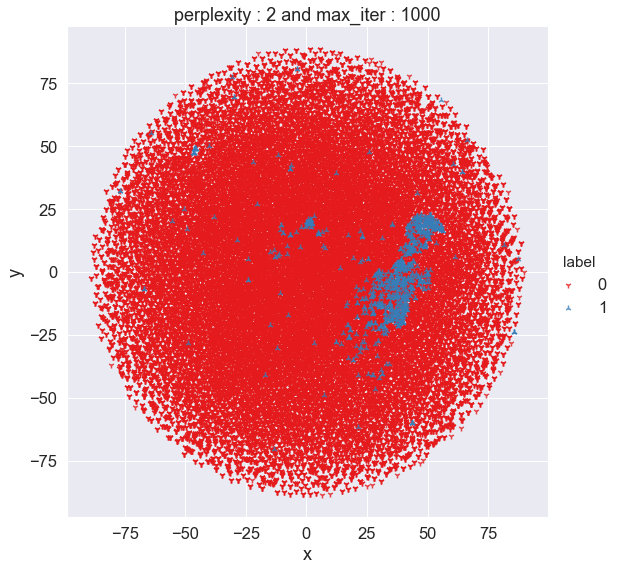


performing tsne with perplexity 10 and with 1000 iterations at max


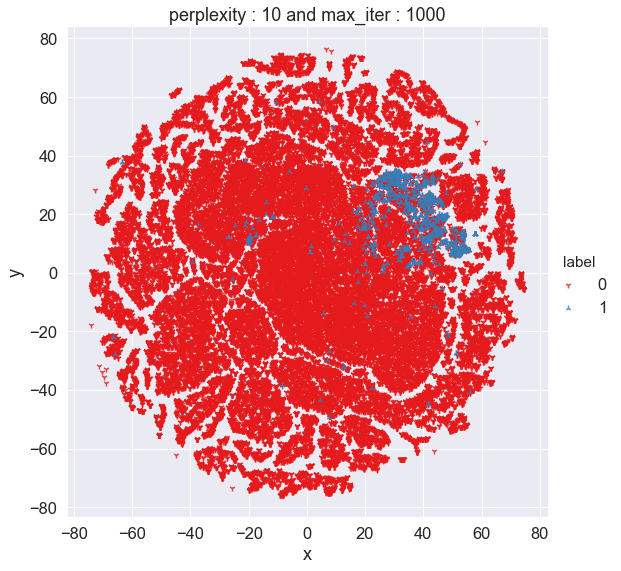


performing tsne with perplexity 30 and with 1000 iterations at max


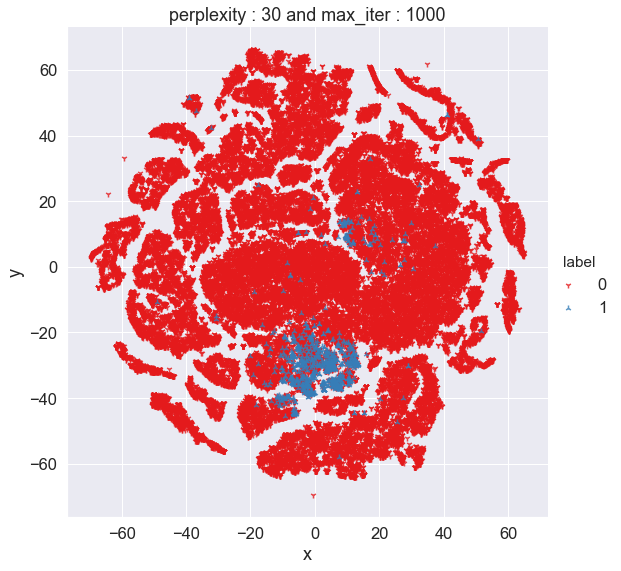


performing tsne with perplexity 50 and with 1000 iterations at max


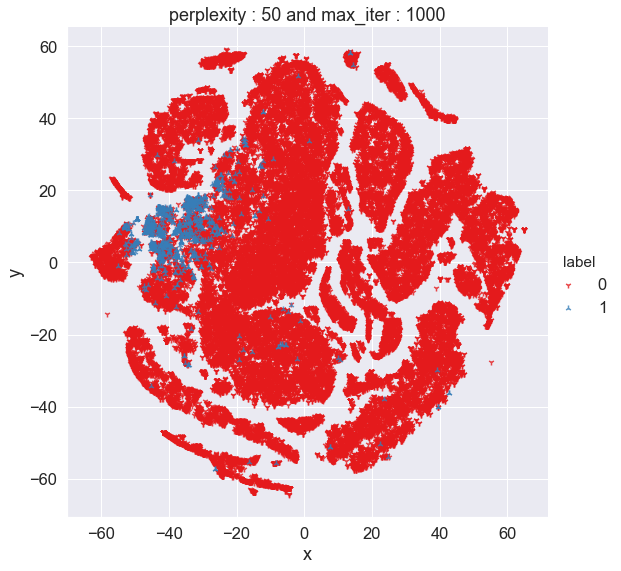

In [33]:
perform_tsne(X_data = data,y_data=target, perplexities =[2,10,30,50])

    - From the above t-SNE we can see all target value 1 (downhole failure) is clustered together but overlapped with target value 0 (surface failure). Hence separating two target values using dimention reduction will not help.

# 6. Feature engineering

Try feature engineering using 7 time based sensors - total 70 features

Define functions for bivariate analysis on the new generated features.

In [22]:
# Define function for violin plot for new features with target values

def bivariate_plot(df, title, time):
    sns.set(font_scale = 1.5)
    if time =='TB':
        fig, axs = plt.subplots(figsize =(25, 15), ncols=4, nrows=2) 
        tar = df['target']
        col_name = list(df.columns.values)[1:]
        for i,ax in zip(col_name,axs.flat):
            sns.violinplot(ax = ax, x = tar,  y = df[i]).set_title(i)
        fig.delaxes(axs[1][3])
        handles, labels = ax.get_legend_handles_labels()
        plt.legend(handles, labels, loc='upper center')
        plt.suptitle(title)
        
    elif time =='NT':
        plt.figure(figsize =(5,5)) 
        tar = df['target']
        col_name = list(df.columns.values)[1]
        sns.violinplot(x = tar,  y = df[col_name])
        plt.title(title)  
    
    plt.show()

In [23]:
# Define function to line plot of new passed dataframe along with target value

def plot_sensor_with_time(df, title):
    col_name = list(df.columns.values)[1:]
    for sensor in col_name:
        sns.set(font_scale = 1.5)
        fig = plt.figure(figsize=(20,4))
        ax1 = fig.add_subplot(111)
        ax2 = ax1.twinx()
        ax1.set_ylabel('{} '.format(sensor))
        ax2.set_ylabel('failure type')
        ax1.set_xlabel('Sensor time')

        df[sensor].plot(color=['red'],ax=ax1)
        df['target'].plot(color=['blue'],ax=ax2)
        lines_1, label1 = ax1.get_legend_handles_labels()
        lines_2, label2 = ax2.get_legend_handles_labels()
        lines = lines_1 + lines_2
        labels = label1 + label2 
        ax2.legend(lines, labels, loc=1,fontsize=15)
        plt.title(title)
        plt.show()

## 6.1 Maximum change over time

Calculate the max difference among all 10 time bins for all 7 sensors and store it in new dataframe MaxChange.

In [80]:
def get_max(xs):
    l = [x for x in xs]
    return (max(l)-min(l))

col_name = []
MaxChange = project_data[['target']]
for i in range(len(hist_sensor_sort)):
    col = [l for l in hist_col if hist_sensor_sort[i] in l]
    col1 = hist_sensor_sort[i]+'_MaxC'
    col_name.append(col1)
    MaxChange[col1] = data[col].apply(get_max, axis=1)

In [81]:
MaxChange.head(4)

,target,sensor7_MaxC,sensor24_MaxC,sensor25_MaxC,sensor26_MaxC,sensor64_MaxC,sensor69_MaxC,sensor105_MaxC
0,0,0.038972,0.033205,0.011813,0.058892,0.027562,0.012483,0.017378
1,0,0.018302,0.006052,0.008209,0.015936,0.010922,0.008252,0.008468
2,0,0.020031,0.013870,0.014723,0.007536,0.009360,0.006622,0.010013
3,0,0.000020,0.000054,0.000043,0.000027,0.000043,0.001230,0.000076


Perform bivariate analysis on Maximum Change Over time.

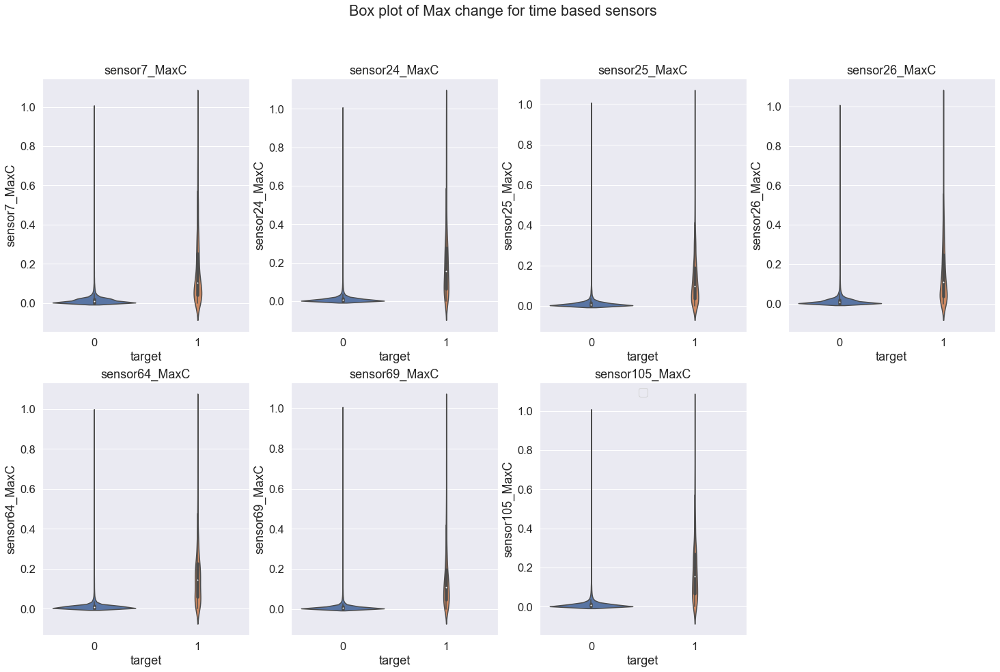

In [26]:
# plot violin plot for each sensor on max change
title = 'Box plot of Max change for time based sensors'

bivariate_plot(MaxChange, title, time='TB')

### Observation
- From the above violin plots, maximum change for all 7 sensors has high IQR range for downhole failure than surface failure.
- All cases we can see median of surface failure is very near to zero whereas median for downhole failure is more than 0.1.
- Sensor105 has the highest range of IQR among all 7 sensors. its 25percentile value at zero and 75 percentile value at 0.3.

Lets plot lineplot for Sensor value in left Y axis and failure type in right Y axis on some randomly sampled data from new dataframe MaxChange.

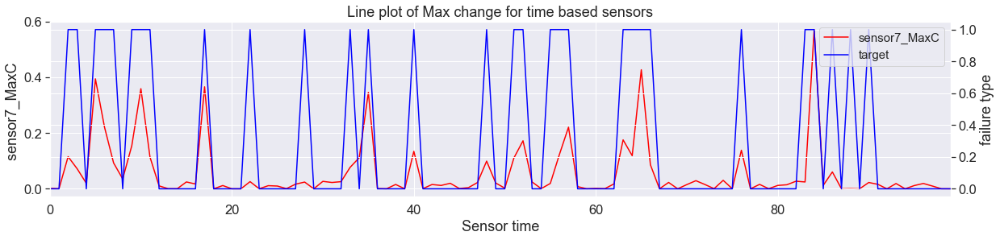

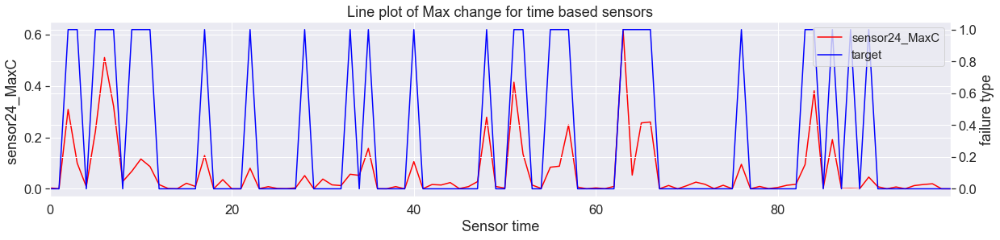

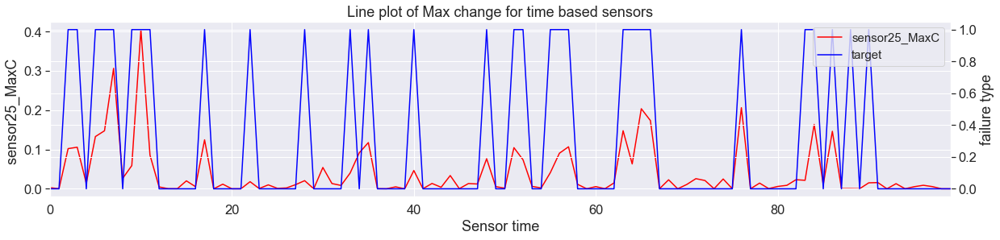

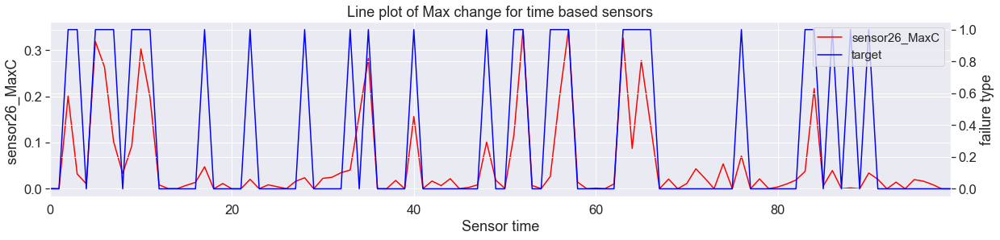

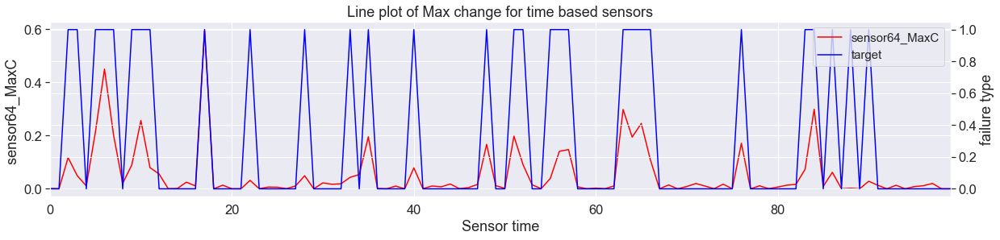

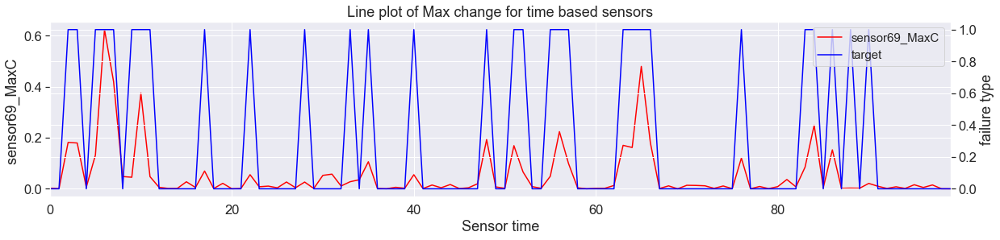

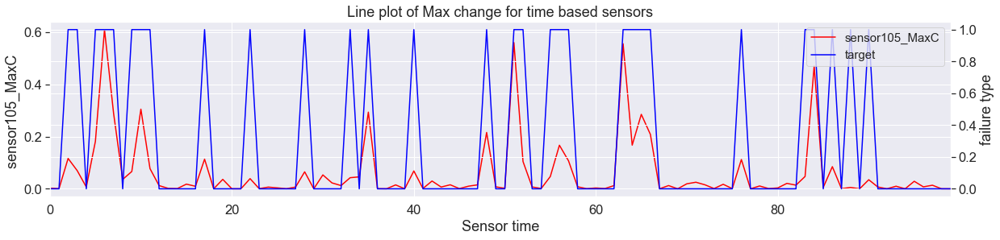

In [1209]:
temp1 = MaxChange[MaxChange['target']==1].sample(n=30)
temp2 = MaxChange[MaxChange['target']==0].sample(n=70)
temp = pd.concat([temp1, temp2])
temp = temp.sample(frac=1).reset_index(drop=True)

title = 'Line plot of Max change for time based sensors'
plot_sensor_with_time(temp, title)

### Observation
- From this new generated features we can easily understand the difference between surface failure and downhole failure.
- Maximum change for Sensor7 and sensor64 has very low values for surface failure compared to other sensors.
- Maximum change for sensor105 has very high peaks for every downhole failures.

## 6.2 Moving average

Calculate the moving average for all 7 sensors and store it in new dataframe MoveAvg.

In [82]:
def get_avg(xs):
    l = [x for x in xs]
    return (sum(l)/len(l))

col_name = []
MoveAvg = project_data[['target']]
for i in range(len(hist_sensor_sort)):
    col = [l for l in hist_col if hist_sensor_sort[i] in l]
    col1 = hist_sensor_sort[i]+'_MoveAvg'
    col_name.append(col1)
    MoveAvg[col1] = data[col].apply(get_avg, axis=1)

In [83]:
MoveAvg.head(4)

,target,sensor7_MoveAvg,sensor24_MoveAvg,sensor25_MoveAvg,sensor26_MoveAvg,sensor64_MoveAvg,sensor69_MoveAvg,sensor105_MoveAvg
0,0,0.006450,0.004562,0.001841,0.014097,0.006019,0.006397,0.009070
1,0,0.003197,0.001165,0.001615,0.005786,0.002536,0.003429,0.004503
2,0,0.002741,0.002118,0.001750,0.004779,0.002022,0.002418,0.004394
3,0,0.000005,0.000006,0.000011,0.000007,0.000009,0.000129,0.000010


Perform bivariate analysis on Maximum Change Over time.

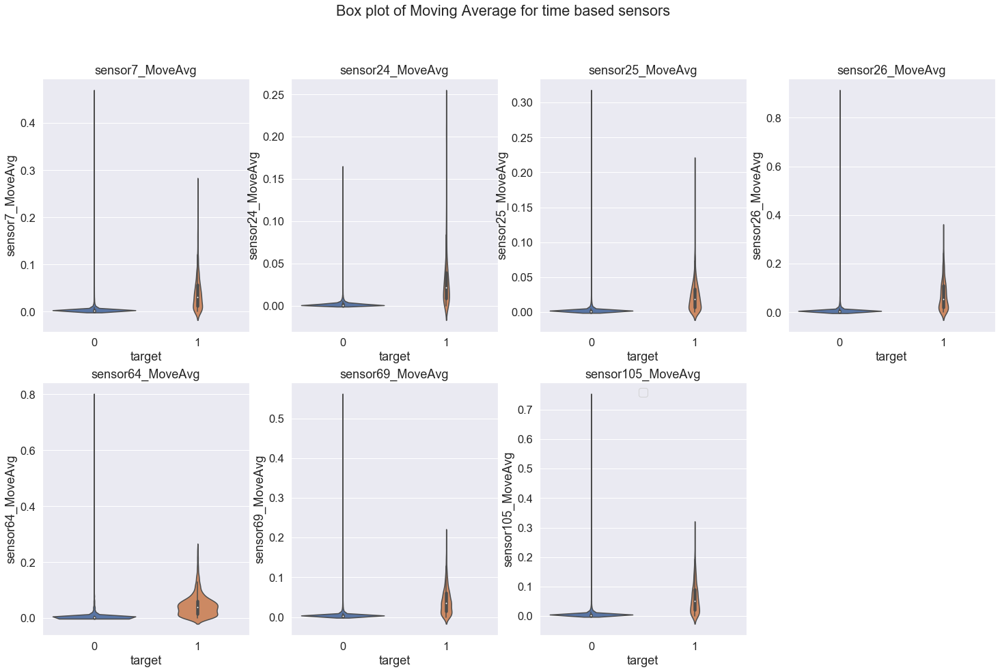

In [39]:
# plot violin plot for each sensor on Moving average
title = 'Box plot of Moving Average for time based sensors'

bivariate_plot(MoveAvg, title, time='TB')

### Observation
- Similar to max change over time , Moving average for all 7 sensors has high IQR range for downhole failure than surface failure.
- All cases we can see median of surface failure is very near to zero whereas median for downhole failure is near to 0.05.
- Sensor64 has the most of the avg values at 0.05.
- Sensor26 has the highest 75percentile value among all sensors. Its 25 percentile is at 0.02 and 75 percentile is at 0.12.

Lets plot lineplot for Sensor value in left Y axis and failure type in right Y axis on some randomly sampled data from new dataframe MoveAvg.

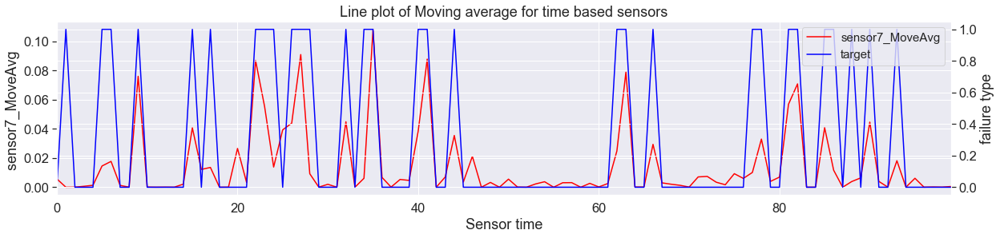

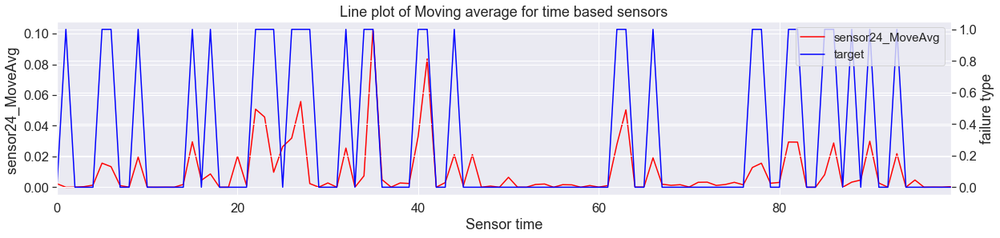

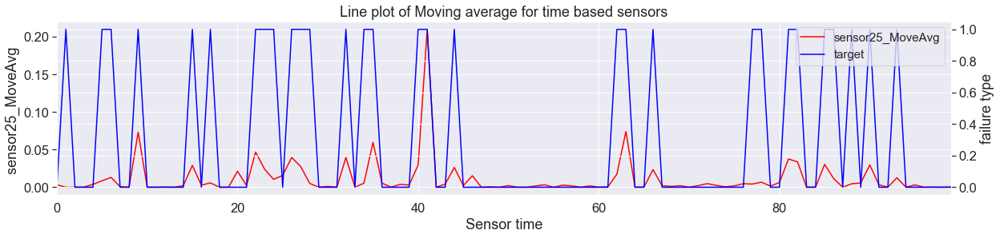

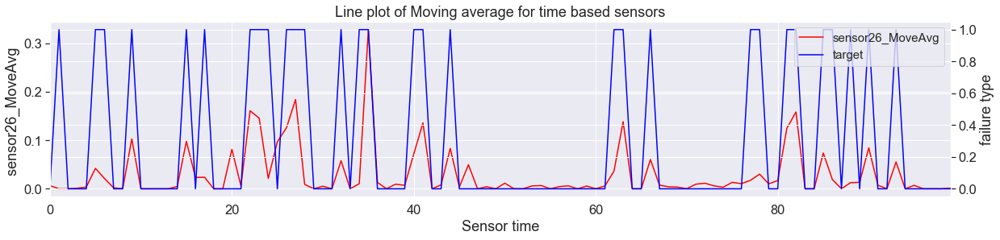

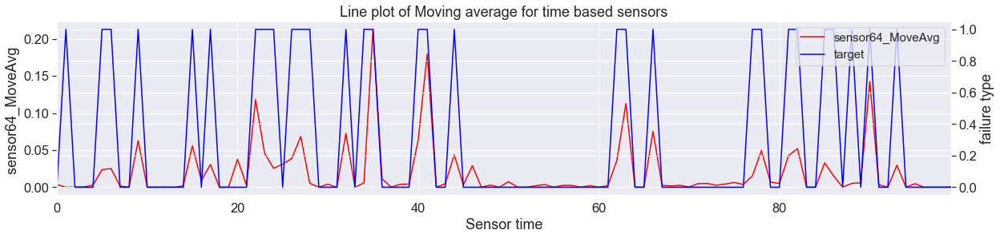

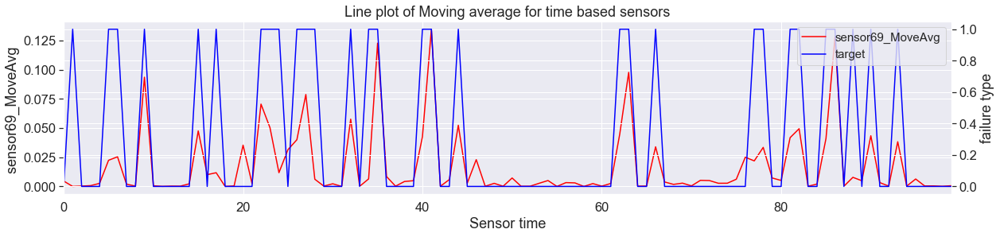

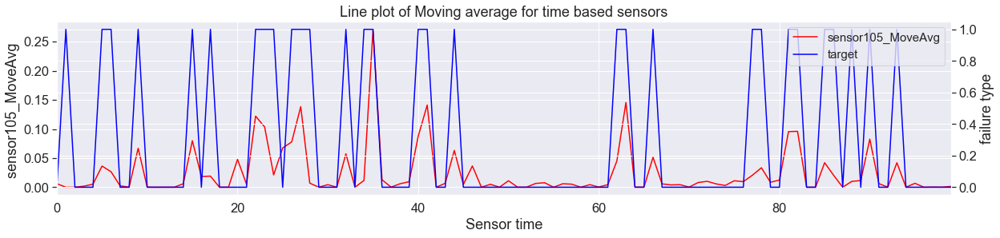

In [42]:
temp1 = MoveAvg[MoveAvg['target']==1].sample(n=30)
temp2 = MoveAvg[MoveAvg['target']==0].sample(n=70)
temp = pd.concat([temp1, temp2])
temp = temp.sample(frac=1).reset_index(drop=True)

title = 'Line plot of Moving average for time based sensors'
plot_sensor_with_time(temp, title)

### Observation
- From this new generated features we can easily understand the difference between surface failure and downhole failure.
- Moving average for Sensor25 has very low values for surface failure compared to other sensors.
- Moving average for sensor69 has very high peaks for every downhole failures.

## 6.3 Average of non time based sensors

Lets calculate the average of the below non time based sensors from EDA (refer 3.2.2) and store it in a new dataframe AvgChangeNT.
    - 'sensor1_measure','sensor8_measure','sensor14_measure','sensor17_measure','sensor27_measure',
      'sensor32_measure','sensor35_measure','sensor48_measure','sensor53_measure','sensor67_measure'

In [1572]:
non_TB_feature = ['sensor1_measure','sensor8_measure','sensor14_measure','sensor17_measure','sensor27_measure',
'sensor32_measure','sensor35_measure','sensor48_measure','sensor53_measure','sensor67_measure']

In [84]:
col_name = ['sensor1_measure','sensor8_measure','sensor14_measure','sensor17_measure','sensor27_measure',
'sensor32_measure','sensor35_measure','sensor48_measure','sensor53_measure','sensor67_measure']

def get_avg(xs):
    l = [x for x in xs]
    return sum(l)/len(l)

AvgChangeNT = project_data[['target']]
col1 = 'AvgChangeNT'
AvgChangeNT[col1] = data[col_name].apply(get_avg, axis=1)

In [85]:
AvgChangeNT.head(4)

,target,AvgChangeNT
0,0,0.033984
1,0,0.016641
2,0,0.013342
3,0,0.000065


Perform bivariate analysis on average value of non time based sensor data.

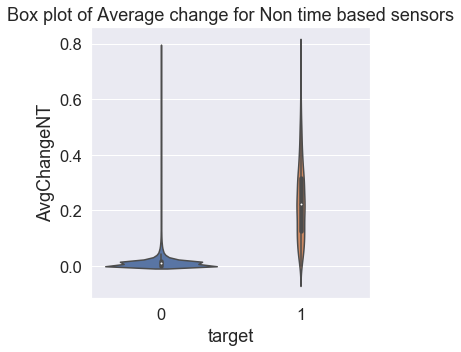

In [29]:
# plot violin plot for each sensor on max change
title = 'Box plot of Average change for Non time based sensors'

bivariate_plot(AvgChangeNT, title, time= 'NT')

### Observation
- Here the we have used selected non time based sensor as per our analysis from EDA.
- Median value for downhole failure is more than 0.2 whereas for surface failure it is at 0.01.
- 75 percentile value of surface failure is 0.05, and 75 percentile value for downhole failure is 0.32.

Lets plot lineplot for Sensor value in left Y axis and failure type in right Y axis on some randomly sampled data from new dataframe AvgChangeNT.

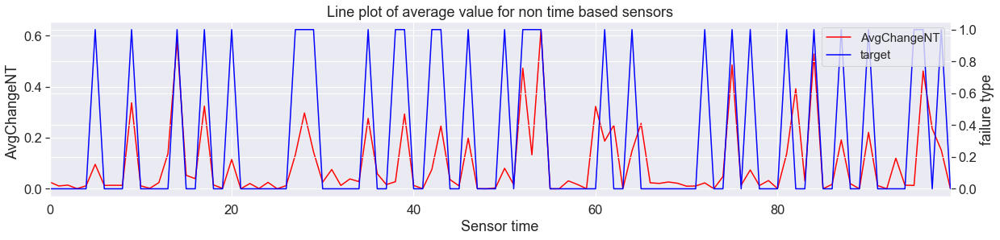

In [1224]:
temp1 = AvgChangeNT[AvgChangeNT['target']==1].sample(n=30)
temp2 = AvgChangeNT[AvgChangeNT['target']==0].sample(n=70)
temp = pd.concat([temp1, temp2])
temp = temp.sample(frac=1).reset_index(drop=True)

title = 'Line plot of average value for non time based sensors'
plot_sensor_with_time(temp, title)

### Observation
- As discussed in EDA this new generated features as well shows high value for downhole failure.
- Most of the surface failure has AvgChangeNT value near to zero.

## 6.4 Merge new features to our dataset

Lets merge MaxChange and AvgChangeNT dataframe with original dataframe.

In [86]:
df1 = MaxChange.iloc[:,1:]
df2 = MoveAvg.iloc[:,1:]
df3 = AvgChangeNT.iloc[:,1:]

processed_data = pd.concat([data, df1, df2, df3], axis=1)
processed_data.head(5)

,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor7_histogram_bin0,sensor7_histogram_bin1,sensor7_histogram_bin2,sensor7_histogram_bin3,sensor7_histogram_bin4,sensor7_histogram_bin5,sensor7_histogram_bin6,sensor7_histogram_bin7,sensor7_histogram_bin8,sensor7_histogram_bin9,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor24_histogram_bin0,sensor24_histogram_bin1,sensor24_histogram_bin2,sensor24_histogram_bin3,sensor24_histogram_bin4,sensor24_histogram_bin5,sensor24_histogram_bin6,sensor24_histogram_bin7,sensor24_histogram_bin8,sensor24_histogram_bin9,sensor25_histogram_bin0,sensor25_histogram_bin1,sensor25_histogram_bin2,sensor25_histogram_bin3,sensor25_histogram_bin4,sensor25_histogram_bin5,sensor25_histogram_bin6,sensor25_histogram_bin7,sensor25_histogram_bin8,sensor25_histogram_bin9,sensor26_histogram_bin0,sensor26_histogram_bin1,sensor26_histogram_bin2,sensor26_histogram_bin3,sensor26_histogram_bin4,sensor26_histogram_bin5,sensor26_histogram_bin6,sensor26_histogram_bin7,sensor26_histogram_bin8,sensor26_histogram_bin9,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor64_histogram_bin0,sensor64_histogram_bin1,sensor64_histogram_bin2,sensor64_histogram_bin3,sensor64_histogram_bin4,sensor64_histogram_bin5,sensor64_histogram_bin6,sensor64_histogram_bin7,sensor64_histogram_bin8,sensor64_histogram_bin9,sensor65_measure,sensor66_measure,sensor67_measure,sensor69_histogram_bin0,sensor69_histogram_bin1,sensor69_histogram_bin2,sensor69_histogram_bin3,sensor69_histogram_bin4,sensor69_histogram_bin5,sensor69_histogram_bin6,sensor69_histogram_bin7,sensor69_histogram_bin8,sensor69_histogram_bin9,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor105_histogram_bin0,sensor105_histogram_bin1,sensor105_histogram_bin2,sensor105_histogram_bin3,sensor105_histogram_bin4,sensor105_histogram_bin5,sensor105_histogram_bin6,sensor105_histogram_bin7,sensor105_histogram_bin8,sensor105_histogram_bin9,sensor106_measure,sensor107_measure,sensor7_MaxC,sensor24_MaxC,sensor25_MaxC,sensor26_MaxC,sensor64_MaxC,sensor69_MaxC,sensor105_MaxC,sensor7_MoveAvg,sensor24_MoveAvg,sensor25_MoveAvg,sensor26_MoveAvg,sensor64_MoveAvg,sensor69_MoveAvg,sensor105_MoveAvg,AvgChangeNT
0,0.027925,9.999998e-01,3.261769e-08,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000163,0.007996,0.038972,0.015907,0.001463,0.0,0.034368,0.0,0.000000,0.0,0.000000,0.00000,0.035022,0.029911,0.022660,0.044285,0.0,0.0,0.0,0.0,0.001274,0.002297,0.0,0.0,0.0,0.0,0.000000,0.003754,0.033205,0.001436,0.007229,0.0,0.000531,0.000465,2.893584e-04,0.000271,5.000101e-03,0.011813,3.681733e-05,1.021497e-07,0.0,0.0,0.010000,0.008791,0.007444,0.007777,0.012332,0.035479,0.058892,0.000250,0.000000,0.000000,0.034739,0.000000,0.000033,0.000133,0.000979,0.034368,0.030

In [45]:
# Save the processed dataset
processed_data.to_csv('processed_training_data.csv', header =True)

In [23]:
# load the processed data
#processed_data = pd.read_csv('processed_training_data.csv')

# 7. Machine learning Models

## 7.1 Train test split

We will split the train test data preserving the distribution of both classes in our original dataset.

In [95]:
# split the data into test and train by maintaining same distribution of output varaible 'target' [stratify=target]
X_train, X_test, y_train, y_test = train_test_split(processed_data, target, stratify=target, test_size=0.2)

X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, stratify=y_train, test_size=0.2)

In [96]:
print('Total data points in train data: {}, |  class 0 data points: {}, |  class 1 data points: {}'.format(X_train.shape[0], y_train.value_counts()[0], y_train.value_counts()[1]))
print('Total data points in cv data: {},     |  class 0 data points: {},  |  class 1 data points: {}'.format(X_cv.shape[0], y_cv.value_counts()[0], y_cv.value_counts()[1]))
print('Total data points in test data: {},  |  class 0 data points: {}, |  class 1 data points: {}'.format(X_test.shape[0], y_test.value_counts()[0], y_test.value_counts()[1]))


Total data points in train data: 38400, |  class 0 data points: 37760, |  class 1 data points: 640
Total data points in cv data: 9600,     |  class 0 data points: 9440,  |  class 1 data points: 160
Total data points in test data: 12000,  |  class 0 data points: 11800, |  class 1 data points: 200


As we already know we have huge imbalanced dataset (98.3:1.7), hence we will try below techniques to find which works better.
  - processed_data as it is.
  - Peroform random over-sampliing on preprocessed_data.
  - Perform oversampling using SMOTE.
  - Perform oversampling of Minority class using SMOTE and random under sampling of majority class.

One thing to remember that we need to perform oversampling on our training set only and not on test set. Having oversampled datapoint in test set will make our model overfit as it may have already seen the same data point in training set. Hence first we will split our train test data and then do the the oversampling.

#### Lets build our train data with random over-sampling.

In [97]:
# https://www.kaggle.com/rafjaa/resampling-strategies-for-imbalanced-datasets
# https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/
# Here we have over sampled of minority class, after oversampling we will get same count of minoty class as majority class. 

temp = X_train[:]
temp['target'] = y_train
temp_0 = temp[temp['target']==0]
temp_1 = temp[temp['target']==1]
class_0_count = temp['target'].value_counts()[0]
temp_1_os = temp_1.sample(class_0_count, replace =True)
processed_data_random_os = pd.concat([temp_0, temp_1_os], axis=0)
X_train_random_os = processed_data_random_os.iloc[:,:-1]
y_train_random_os = processed_data_random_os['target']
print('After random oversampling:')
print('Total data points in train data: {}, |  class 0 data points: {}, |  class 1 data points: {}'.format(X_train_random_os.shape[0], y_train_random_os.value_counts()[0], y_train_random_os.value_counts()[1]))

After random oversampling:
Total data points in train data: 75520, |  class 0 data points: 37760, |  class 1 data points: 37760


#### Lets perform oversampling using SMOTE.

In [98]:
from imblearn.over_sampling import SMOTE
# Here we are creating SMOTE object and performing oversampling using sampling_strategy =0.1
# Which means (minority class count after sampling / majority class count) = 0.1

smote = SMOTE(sampling_strategy=0.1, random_state = 32)
X_train_SMOTE_os, y_train_SMOTE_os = smote.fit_sample(X_train, y_train)
print('After SMOTE oversampling:')
print('Total data points in train data: {}, |  class 0 data points: {}, |  class 1 data points: {}'.format(X_train_SMOTE_os.shape[0], y_train_SMOTE_os.value_counts()[0], y_train_SMOTE_os.value_counts()[1]))

After SMOTE oversampling:
Total data points in train data: 41536, |  class 0 data points: 37760, |  class 1 data points: 3776


#### Lets perform oversampling using SMOTE and undersampling of majority class.

In [99]:
# Here we will use SMOTE which will help us perform oversampling of minority class and undersmapling
# of majority class together.
#from imblearn.combine import SMOTETomek
from imblearn.under_sampling import NearMiss
from imblearn.pipeline import make_pipeline

pipe = make_pipeline(SMOTE(sampling_strategy=0.1), NearMiss(sampling_strategy=0.1))
X_train_osus, y_train_osus = pipe.fit_resample(X_train, y_train)
print('After SMOTE oversampling with undersampling:')
print('Total data points in train data: {}, |  class 0 data points: {}, |  class 1 data points: {}'.format(X_train_osus.shape[0], y_train_osus.value_counts()[0], y_train_osus.value_counts()[1]))

After SMOTE oversampling with undersampling:
Total data points in train data: 41536, |  class 0 data points: 37760, |  class 1 data points: 3776


Lets create a list of all type of data we have prepared using above methods.

In [100]:
dataset_type = ['Imbalanced','Random oversampled','SMOTE oversampled','SMOTE oversampled-undersampled']
dataset = [[X_train,y_train], 
           [X_train_random_os, y_train_random_os],
           [X_train_SMOTE_os, y_train_SMOTE_os],
           [X_train_osus, y_train_osus]]

In [141]:
import pickle as pkl
# save all dataset

all_data = [X_train,y_train, 
           X_train_random_os, y_train_random_os,
           X_train_SMOTE_os, y_train_SMOTE_os,
           X_train_osus, y_train_osus]
with open("all_data_set.pkl", "wb") as f:
    pkl.dump(all_data, f)

# read data
# with open("all_data_set.pkl", "r") as f:
#   X_train,y_train,X_train_random_os, y_train_random_os, X_train_SMOTE_os, y_train_SMOTE_os,X_train_osus, y_train_osus = pkl.load(f)

## 7.2 Logistic regression

In [67]:
def plot_error(cv_error_array, alpha,dataset_type):
    ''' This function helps to plot f1 score vs hyperparam alpha value'''
    fig, axs = plt.subplots(figsize=(20,10), ncols=2, nrows=2)
    sns.set(font_scale = 1.3)
    for j,ax in zip(range(len(cv_error_array)),axs.flat):
        error = cv_error_array[j]
        ax.plot(alpha, error,c='g')
        for i, txt in enumerate(np.round(error,3)):
            ax.annotate((alpha[i],np.round(txt,3)), (alpha[i],error[i]))
        ax.set_title(dataset_type[j])
    plt.suptitle("Cross Validation F1 score for each alpha with different type of dataset")
    plt.setp(axs[-1, :], xlabel="Alpha i's")
    plt.setp(axs[:, 0], ylabel="F1 score")
    plt.show()

def confusion_matrix_plot(clf_list, X_test, y_test, dataset_type):
    ''' This function helps to plot confusion matrix'''
    fig, axs = plt.subplots(figsize=(20,10), ncols=2, nrows=2)
    sns.set(font_scale = 1.3)
    for j,ax in zip(range(len(clf_list)),axs.flat):
        clf = clf_list[j]
        predict_y = clf.predict(X_test)
        conf_mat = confusion_matrix(y_true=y_test, y_pred=predict_y)
        sns.heatmap(conf_mat, annot=True,fmt=".3f", linewidths=.5, square=True, cmap='Blues_r', ax=ax)
        ax.set_title(dataset_type[j])
    plt.suptitle("Confusion matrix for different type of dataset")
    plt.setp(axs[-1, :], xlabel="Predicted")
    plt.setp(axs[:, 0], ylabel="Expected")
    plt.show()

In [1386]:
from sklearn.metrics import roc_curve, auc

def auc_curve_plot(clf_list, dataset, X_test, y_test, dataset_type):
    ''' This function helps to plot confusion matrix'''
    fig, axs = plt.subplots(figsize=(20,10), ncols=2, nrows=2)
    sns.set(font_scale = 1.3)
    for j,ax in zip(range(len(clf_list)),axs.flat):
        clf = clf_list[j]
        
        y_train_pred = clf.predict(dataset[j][0])
        y_test_pred = clf.predict(X_test)
        
        train_fpr, train_tpr, tr_thresholds = roc_curve(dataset[j][1], y_train_pred)
        test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred)
        
        ax.plot(train_fpr, train_tpr,label="train AUC ="+str(auc(train_fpr, train_tpr)))
        ax.plot(test_fpr, test_tpr,label="test AUC ="+str(auc(test_fpr, test_tpr)))
        
        ax.set_title(dataset_type[j])
    plt.suptitle("AUC plots for different type of dataset")
    plt.setp(axs[-1, :], xlabel="FPR")
    plt.setp(axs[:, 0], ylabel="TPR")
    plt.show()
# test AUC plot
#auc_curve_plot(clf_list_log_reg, dataset, X_test, y_test, dataset_type)

In [1413]:
from sklearn.metrics import precision_score, recall_score

def other_metric(clf, dataset, X_cv, y_cv, X_test, y_test, dataset_type):
    data_val = ['Data','AUC','Precision','Recall']
    test_data_all=[]
    tot_len = len(dataset_type)
    for i,model in enumerate(clf):
        train_data = []
        cv_data=[]
        test_data=[]
        final=[]
        if tot_len >1:
            print("="*5+' '+dataset_type[i]+' '+"="*5)
        else:
            print("="*5+' '+dataset_type[0]+' '+"="*5)
        
        y_train_pred = model.predict(dataset[i][0])
        train_data.append('Train')
        train_data.append(roc_auc_score(dataset[i][1], y_train_pred))
        train_data.append(precision_score(dataset[i][1], y_train_pred, average='binary'))
        train_data.append(recall_score(dataset[i][1], y_train_pred, average='binary'))
        
        y_cv_pred = model.predict(X_cv)
        cv_data.append('CV')
        cv_data.append(roc_auc_score(y_cv, y_cv_pred))
        cv_data.append(precision_score(y_cv, y_cv_pred, average='binary'))
        cv_data.append(recall_score(y_cv, y_cv_pred, average='binary'))
        
        y_test_pred = model.predict(X_test)
        test_data.append('Test')
        test_auc = roc_auc_score(y_test, y_test_pred)
        test_pre = precision_score(y_test, y_test_pred, average='binary')
        test_rec = recall_score(y_test, y_test_pred, average='binary')
        
        test_data.append(test_auc)
        test_data.append(test_pre)
        test_data.append(test_rec)
        
        final.append(train_data)
        final.append(cv_data)
        final.append(test_data)

        print (tabulate(final,headers=data_val, tablefmt='orgtbl'))
        print('\n')
        test_data_all.append(test_data)
    return test_data_all

In [155]:
def logistic_reg(train_df, X_cv, y_cv, X_test, y_test):
    ''' This function will take train, test and cv data and perform logoctoc regression on train data and return 
    prediction of all train, cv and test data for best alpha value using grid search'''
    
    X_train = train_df[0]
    y_train = train_df[1]
    alpha = [10 ** x for x in range(-5, 4)]
    cv_error_array=[]
    for i in alpha:
        logisticR=LogisticRegression(penalty='l2',C=i, random_state =32)
        logisticR.fit(X_train,y_train)
        predict_y = logisticR.predict(X_cv)
        cv_error_array.append(f1_score(y_cv, predict_y))

    best_alpha = np.argmax(cv_error_array)

    logisticR=LogisticRegression(penalty='l2',C=alpha[best_alpha], random_state =32)
    logisticR.fit(X_train,y_train)
    
    predict_y_train = logisticR.predict(X_train)
    f1_train = f1_score(y_train, predict_y_train)
    predict_y_cv = logisticR.predict(X_cv)
    f1_cv = f1_score(y_cv, predict_y_cv)
    predict_y_test = logisticR.predict(X_test)
    f1_test = f1_score(y_test, predict_y_test)

    return logisticR, alpha, alpha[best_alpha], f1_train, f1_cv, f1_test, cv_error_array

In [156]:
summary_log_reg = []
error_list_log_reg = []
clf_list_log_reg = []
f1_test_list_log_reg = []

print("Summary of the logistic regression")
print("="*127)
for i,train_df in enumerate(dataset):
    clf, alpha, best_alpha, f1_train, f1_cv, f1_test, error = logistic_reg(train_df, X_cv, y_cv, X_test, y_test)
    
    error_list_log_reg.append(error)
    clf_list_log_reg.append(clf)
    f1_test_list_log_reg.append(f1_test)
    
    temp = ['Log_reg',dataset_type[i],best_alpha,f1_train, f1_cv, f1_test]
    summary_log_reg.append(temp)

print (tabulate(summary_log_reg,headers=['Model','Dataset_type','Best alpha', 'Train f1 score',
                                 'CV f1 score','Test f1 score'], tablefmt='orgtbl'))
print("="*127)

Summary of the logistic regression
| Model   | Dataset_type                   |   Best alpha |   Train f1 score |   CV f1 score |   Test f1 score |
|---------+--------------------------------+--------------+------------------+---------------+-----------------|
| Log_reg | Imbalanced                     |         1000 |         0.762069 |      0.67148  |        0.681818 |
| Log_reg | Random oversampled             |         1000 |         0.966091 |      0.6      |        0.554033 |
| Log_reg | SMOTE oversampled              |           10 |         0.874913 |      0.69375  |        0.711009 |
| Log_reg | SMOTE oversampled-undersampled |          100 |         0.889351 |      0.690909 |        0.699332 |


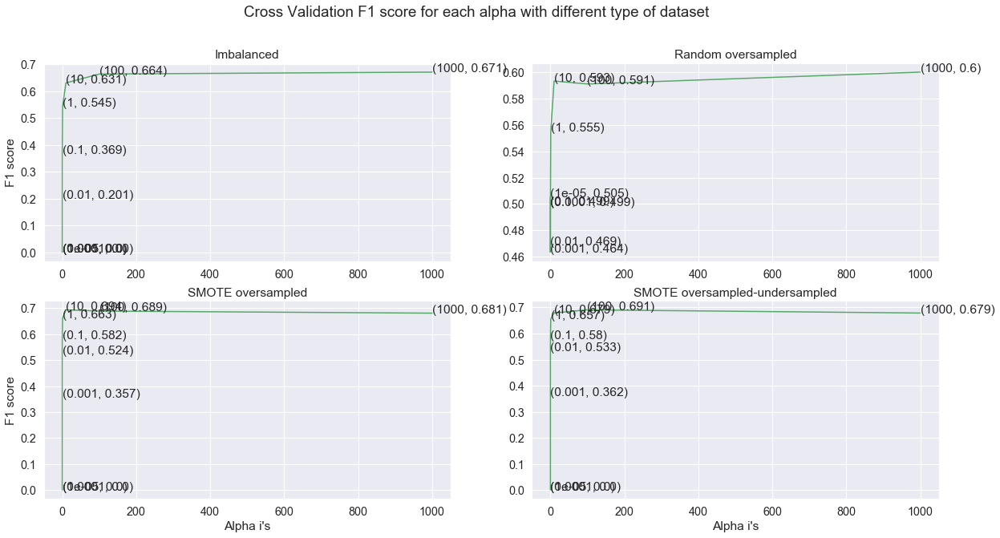

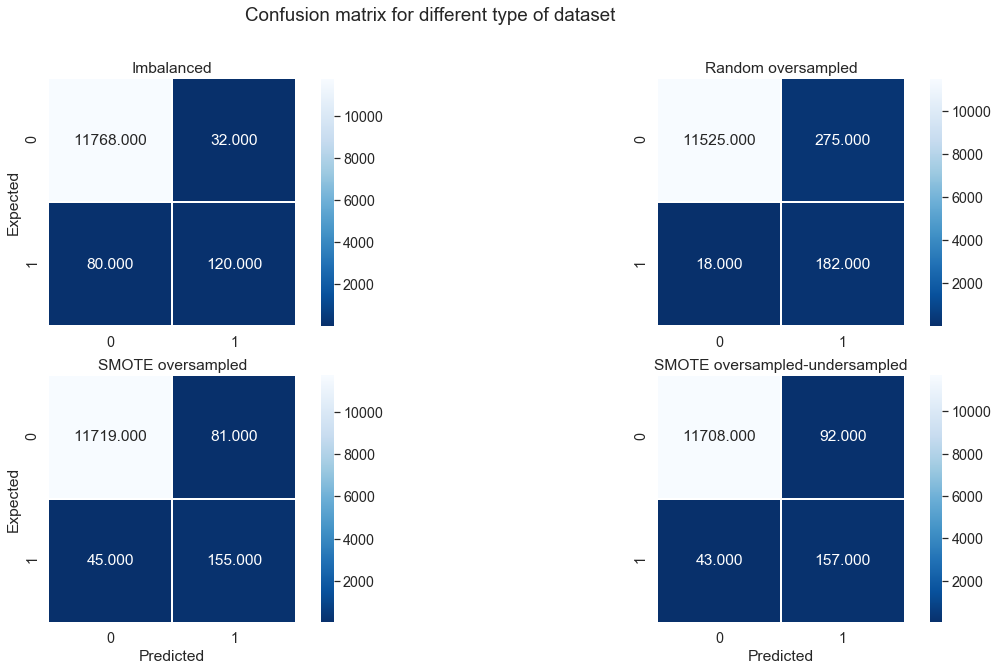

In [157]:
# plot F1score vs hyper parameter alpha values
plot_error(error_list_log_reg, alpha ,dataset_type)
print("="*127)
# plot confusion matrix
confusion_matrix_plot(clf_list_log_reg, X_test, y_test, dataset_type)

#### Lets print AUC , precision and Recall scores for all datasets.

In [1393]:
# Print AUC, precision, recall and AUC score for all models
test_data_all = other_metric(clf_list_log_reg, dataset, X_cv, y_cv, X_test, y_test, dataset_type)

===== Imbalanced =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 0.84428  |    0.85     | 0.690625 |
| CV     | 0.789354 |    0.794872 | 0.58125  |
| Test   | 0.798644 |    0.789474 | 0.6      |


===== Random oversampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 0.966472 |    0.977215 | 0.955217 |
| CV     | 0.922669 |    0.46     | 0.8625   |
| Test   | 0.943347 |    0.398249 | 0.91     |


===== SMOTE oversampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 0.911163 |     0.92631 | 0.828919 |
| CV     | 0.84428  |     0.69375 | 0.69375  |
| Test   | 0.884068 |     0.65678 | 0.775    |


===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 0.922087 |    0.932075 | 0.850371 |
| CV     | 0.853284 |

In [1391]:
# save the best f1 score 
best_score = {}
best_score['Log_reg'] = [ dataset_type[0], f1_test_list_log_reg[0],test_data_all[0][1],test_data_all[0][2],test_data_all[0][3]]

### Observation:
- Here we have applie logistic regression with grid search on alpha's value for different dataset.
- From the above table we can see best test f1 score (0.68%) we have achived from imbalanced dataset (without any upsampling).
- For Random sampled the train f1 score is very high (0.96) but at same time test f1 score is lowest 0.55. This could be becuase in random sample we will simply increase the same minority datapoints multiple times. Hence our model may have got overfitted.
- For other over sampling using SMOTE we can see test f1 score is 0.71 and 0.69 which is comparitively better than random upsampled dataset but notice the train f1 score is 0.87 and 0.88 hence this is too overfitted. 
- We have good AUC score in SMOTE oversampled-undersampled data set, but as our job is to predict for machine failure, we will focus more on precision, else we need to provide a huge penalty. From precision point of view Imbalanced dataset has performed good than other dataset on test data.
- So we can derive imbalanced datset gives us the best result among all four. 
- Also from the confusion matrix we can see Random over sampled performed worst with highest number of faslse positive and false negative. whereas Imbalanced dataset has lowest (total 80+32 = 112 wrong datapoints) among all four dataset.
- Now lets use some other models and check their performance.

## 7.3 K Nearest Neighbour Classification

In [133]:
def k_nearest(train_df, X_cv, y_cv, X_test, y_test):
    ''' This function will take train, test and cv data and perform k nearest classifier on train data and return 
    prediction of all train, cv and test data for best alpha value using grid search'''
    
    X_train = train_df[0]
    y_train = train_df[1]
    alpha = [x for x in range(1, 15, 2)]
    cv_error_array=[]
    for i in alpha:
        knear = KNeighborsClassifier(n_neighbors=i)
        knear.fit(X_train,y_train)
        predict_y = knear.predict(X_cv)
        cv_error_array.append(f1_score(y_cv, predict_y))

    best_alpha = np.argmax(cv_error_array)

    knear = KNeighborsClassifier(n_neighbors=alpha[best_alpha] )
    knear.fit(X_train,y_train)
    
    predict_y_train = knear.predict(X_train)
    f1_train = f1_score(y_train, predict_y_train)
    predict_y_cv = knear.predict(X_cv)
    f1_cv = f1_score(y_cv, predict_y_cv)
    predict_y_test = knear.predict(X_test)
    f1_test = f1_score(y_test, predict_y_test)

    return knear, alpha, alpha[best_alpha], f1_train, f1_cv, f1_test, cv_error_array

In [134]:
from sklearn.neighbors import KNeighborsClassifier

summary_knear = []
error_list_knear = []
clf_list_knear = []
f1_test_list_knear = []

print("Summary of the K nearest classifier")
print("="*127)
for i,train_df in enumerate(dataset):
    clf, alpha, best_alpha, f1_train, f1_cv, f1_test, error = k_nearest(train_df, X_cv, y_cv, X_test, y_test)
    
    error_list_knear.append(error)
    clf_list_knear.append(clf)
    f1_test_list_knear.append(f1_test)
    
    temp = ['K_nearest',dataset_type[i],best_alpha,f1_train, f1_cv, f1_test]
    summary_knear.append(temp)

print (tabulate(summary_knear,headers=['Model','Dataset_type','Best alpha', 'Train f1 score',
                                 'CV f1 score','Test f1 score'], tablefmt='orgtbl'))
print("="*127)

Summary of the K nearest classifier
| Model     | Dataset_type                   |   Best alpha |   Train f1 score |   CV f1 score |   Test f1 score |
|-----------+--------------------------------+--------------+------------------+---------------+-----------------|
| K_nearest | Imbalanced                     |            1 |         1        |      0.604982 |        0.59726  |
| K_nearest | Random oversampled             |            3 |         0.997675 |      0.642857 |        0.618605 |
| K_nearest | SMOTE oversampled              |            1 |         1        |      0.658892 |        0.64455  |
| K_nearest | SMOTE oversampled-undersampled |            1 |         1        |      0.656891 |        0.654028 |


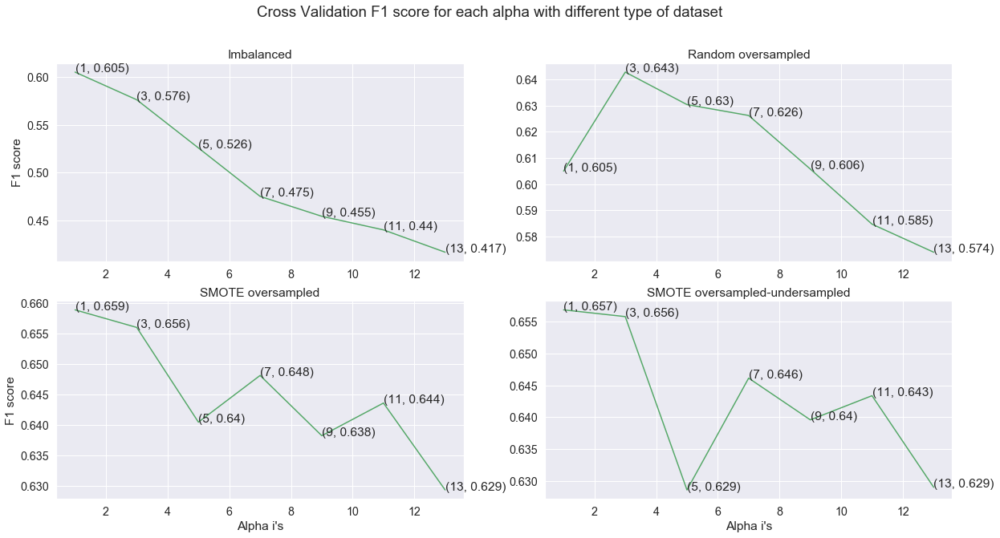

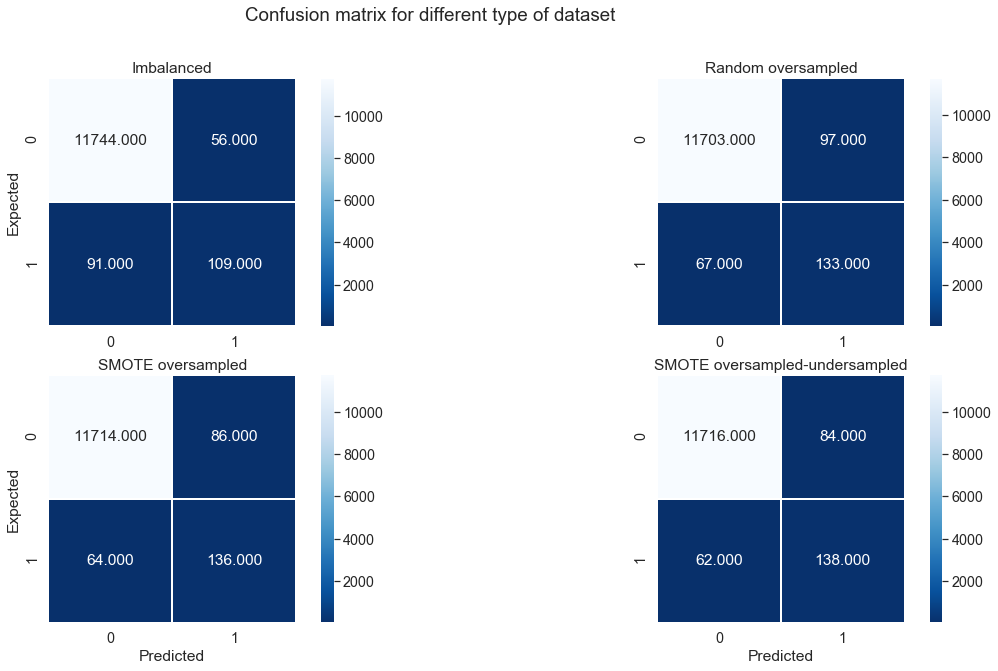

In [135]:
# plot F1score vs hyper parameter alpha values
plot_error(error_list_knear, alpha,dataset_type)
print("="*127)
# plot confusion matrix
confusion_matrix_plot(clf_list_knear, X_test, y_test, dataset_type)

### Observation
- Above K nearest model has performed very poorly.
- For all of thr four dataset training f1 score is 1 that is the best score we have but while looking at cv and test f1 score we can see it is very low, i.e below 65. Hence we can say this is not a good model for our case study as for all four dataset it is highly overfitting. Hence we will ignore k nearest classifier model.

## 7.4 Random Forest

In [1400]:
def random_forest(train_df, X_cv, y_cv, X_test, y_test):
    ''' This function will take train, test and cv data and perform random forest classifier on train data and return 
    prediction of all train, cv and test data for best alpha value using grid search'''
    
    X_train = train_df[0]
    y_train = train_df[1]
    alpha=[10,20,50,100,200]
    cv_error_array=[]
    for i in alpha:
        rf = RandomForestClassifier(n_estimators=i,random_state=32,n_jobs=-1)
        rf.fit(X_train,y_train)
        predict_y = rf.predict(X_cv)
        cv_error_array.append(f1_score(y_cv, predict_y))

    best_alpha = np.argmax(cv_error_array)

    rf = RandomForestClassifier(n_estimators=alpha[best_alpha],random_state=32,n_jobs=-1)
    rf.fit(X_train,y_train)
    
    predict_y_train = rf.predict(X_train)
    f1_train = f1_score(y_train, predict_y_train)
    predict_y_cv = rf.predict(X_cv)
    f1_cv = f1_score(y_cv, predict_y_cv)
    predict_y_test = rf.predict(X_test)
    f1_test = f1_score(y_test, predict_y_test)

    return rf, alpha, alpha[best_alpha], f1_train, f1_cv, f1_test, cv_error_array

In [1397]:
from sklearn.ensemble import RandomForestClassifier

summary_rf = []
error_list_rf = []
clf_list_rf = []
f1_test_list_rf = []

print("Summary of the random forest classifier")
print("="*127)
for i,train_df in enumerate(dataset):
    clf, alpha, best_alpha, f1_train, f1_cv, f1_test, error = random_forest(train_df, X_cv, y_cv, X_test, y_test)
    
    error_list_rf.append(error)
    clf_list_rf.append(clf)
    f1_test_list_rf.append(f1_test)
    
    temp = ['Random_forest',dataset_type[i],best_alpha,f1_train, f1_cv, f1_test]
    summary_rf.append(temp)

print (tabulate(summary_rf,headers=['Model','Dataset_type','Best alpha', 'Train f1 score',
                                 'CV f1 score','Test f1 score'], tablefmt='orgtbl'))
print("="*127)

Summary of the random forest classifier
| Model         | Dataset_type                   |   Best alpha |   Train f1 score |   CV f1 score |   Test f1 score |
|---------------+--------------------------------+--------------+------------------+---------------+-----------------|
| Random_forest | Imbalanced                     |          100 |                1 |      0.772059 |        0.793201 |
| Random_forest | Random oversampled             |         3000 |                1 |      0.767025 |        0.759207 |
| Random_forest | SMOTE oversampled              |          500 |                1 |      0.805112 |        0.800995 |
| Random_forest | SMOTE oversampled-undersampled |         2000 |                1 |      0.801282 |        0.805    |


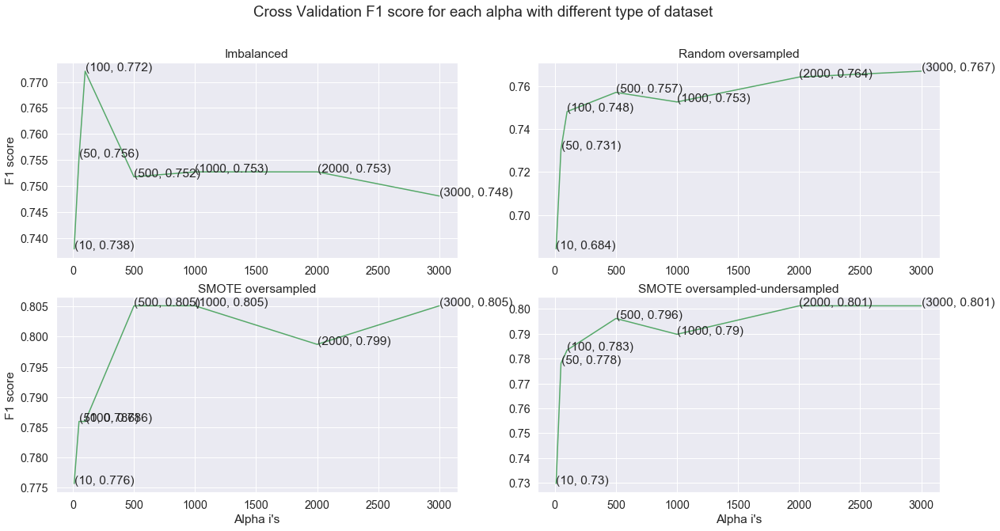

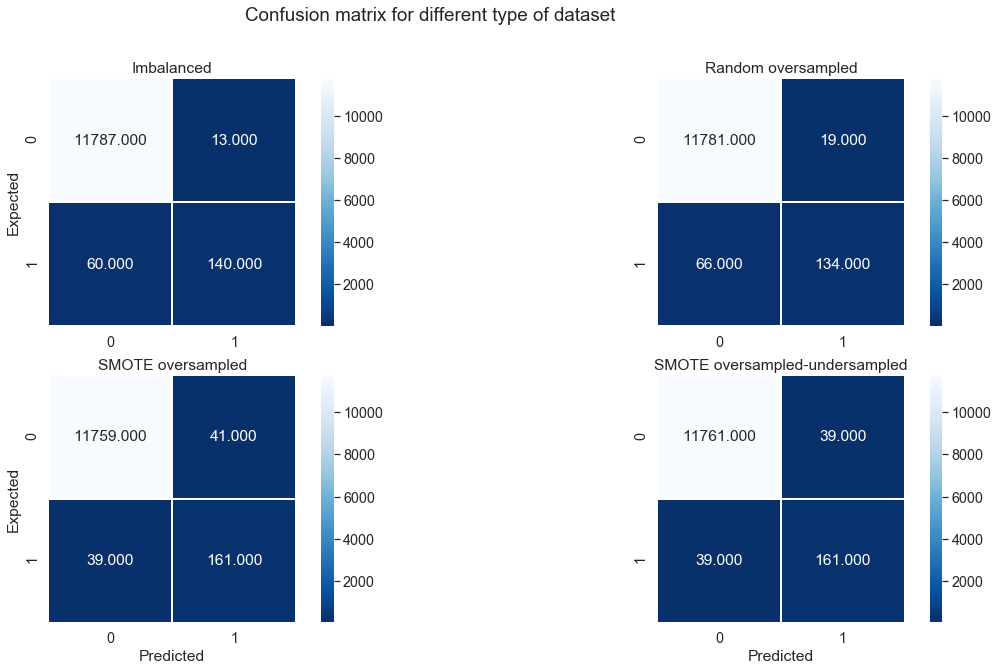

In [160]:
# plot F1score vs hyper parameter alpha values
plot_error(error_list_rf, alpha,dataset_type)
print("="*127)
# plot confusion matrix
confusion_matrix_plot(clf_list_rf, X_test, y_test, dataset_type)

#### Lets print AUC , precision and Recall scores for all datasets.

In [1399]:
# Print AUC, precision, recall and AUC score for all models
test_data_all_rf = other_metric(clf_list_rf, dataset, X_cv, y_cv, X_test, y_test, dataset_type)

===== Imbalanced =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |  1       |
| CV     | 0.827754 |    0.9375   |  0.65625 |
| Test   | 0.849449 |    0.915033 |  0.7     |


===== Random oversampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |  1       |
| CV     | 0.833739 |    0.89916  |  0.66875 |
| Test   | 0.834195 |    0.875817 |  0.67    |


===== SMOTE oversampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |   1      |
| CV     | 0.89232  |    0.823529 |   0.7875 |
| Test   | 0.900763 |    0.79703  |   0.805  |


===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |  1       |
| CV     | 0.889195 |

From the above plots and table we can see that random forest has performed best for 'SMOTE oversampling-undersampling' train dataset. Lets try to perform hyper parameter tunning using random search.

In [146]:
from sklearn.model_selection import RandomizedSearchCV

rf = RandomForestClassifier()
prams={
     'n_estimators':[100,200,500,1000,2000],
     'max_depth':[3,5,10,15],
    'min_samples_split':[2,3,4],
}

random_rf=RandomizedSearchCV(rf,param_distributions=prams,verbose=10,n_jobs=-1,random_state=32)
random_rf.fit(X_train_osus, y_train_osus)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed: 26.3min
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed: 29.6min
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed: 44.1min
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed: 59.5min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed: 63.1min finished


RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [147]:
# Print the best hyper parameter for random forest from randomsearch
print (random_rf.best_params_)

{'n_estimators': 100, 'min_samples_split': 2, 'max_depth': 15}


In [1406]:
print("Summary of the best random forest classifier")
print("="*127)
n_estimators=100
min_samples_split=2
max_depth=15
best_rf = RandomForestClassifier(n_estimators =n_estimators,
                                 min_samples_split=min_samples_split, max_depth=max_depth,n_jobs=-1,random_state=32 )
best_rf.fit(X_train_osus, y_train_osus)
    
predict_y_train = best_rf.predict(X_train_osus)
f1_train = f1_score(y_train_osus, predict_y_train)
predict_y_cv = best_rf.predict(X_cv)
f1_cv = f1_score(y_cv, predict_y_cv)
predict_y_test = best_rf.predict(X_test)
f1_test = f1_score(y_test, predict_y_test)

print('Best Random forest model with SMOTE oversampled-undersampled data ')
print('Train F1 score: ',f1_train)
print('CV F1 score: ',f1_cv)
print('Test F1 score: ',f1_test)
print("="*127)

Summary of the best random forest classifier
Best Random forest model with SMOTE oversampled-undersampled data 
Train F1 score:  0.9902549726338272
CV F1 score:  0.7711598746081505
Test F1 score:  0.8009828009828011


Text(0.5, 27.939999999999984, 'Pred')

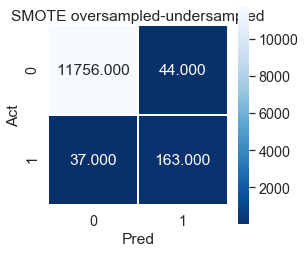

In [151]:
# get the confussion matrix for best randomforest
plt.figure(figsize=(4,4))
conf_mat = confusion_matrix(y_true=y_test, y_pred=predict_y_test)
sns.heatmap(conf_mat, annot=True,fmt=".3f", linewidths=.5, square=True, cmap='Blues_r')
plt.title(dataset_type[3])
plt.ylabel('Act')
plt.xlabel('Pred')

Lets print AUC, precision and recall scores for best random forest model on SMOTE-oversampled-undersampled dataset.

In [1414]:
# Print AUC, precision, recall and AUC score for all models
test_data_all_best_rf = other_metric([best_rf], [[X_train_osus, y_train_osus]], 
                                     X_cv, y_cv, X_test, y_test, [dataset_type[3]])

===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 0.991049 |    0.998385 | 0.982256 |
| CV     | 0.882468 |    0.773585 | 0.76875  |
| Test   | 0.905636 |    0.78744  | 0.815    |




In [1415]:
# save the best f1 score 
best_score['Random_Forest'] = [dataset_type[3], f1_test_list_rf[3],test_data_all_rf[3][1],
                               test_data_all_rf[3][2],test_data_all_rf[3][3]]

### Observation
- Here in random forest we have received better result than logistic regression. 
- Among four dataset, 'SMOTE oversampling-undersampling' dataset has best f1 score on test data. we have achived 0.80 f1 score for cv data and 0.805 for test data.
- total 78 data points are wrongly classified (from confussion matrix).
- NeXt we have performed random search on same dataset 'SMOTE oversampling-undersampling' and achived f1 score of 0.77 on cv data and 0.80 on test data.
- Looking at the AUC, precision and recall we have achived 0.90 test AUC score and 0.805 precision and 0.805 recall on test data.
- After Random search we have achived good score but precision is reduced little than our previous model on SMOTE-oversampled-donwsamppled. Hence we will take the earlier model stored in clf_list_rf[3] as best RF model.

## 7.5 XgBoost Classifier

In [164]:
def xgboost(train_df, X_cv, y_cv, X_test, y_test):
    ''' This function will take train, test and cv data and perform XgBoost classifier on train data and return 
    prediction of all train, cv and test data for best alpha value using grid search'''
    
    X_train = train_df[0]
    y_train = train_df[1]
    alpha=[10,50,100,500,1000,2000,3000]
    cv_error_array=[]
    for i in alpha:
        xgb = XGBClassifier(n_estimators=i,nthread=-1,random_state = 32)
        xgb.fit(X_train,y_train)
        predict_y = xgb.predict(X_cv)
        cv_error_array.append(f1_score(y_cv, predict_y))

    best_alpha = np.argmax(cv_error_array)

    xgb = XGBClassifier(n_estimators=alpha[best_alpha],nthread=-1,random_state = 32)
    xgb.fit(X_train,y_train)
    
    predict_y_train = xgb.predict(X_train)
    f1_train = f1_score(y_train, predict_y_train)
    predict_y_cv = xgb.predict(X_cv)
    f1_cv = f1_score(y_cv, predict_y_cv)
    predict_y_test = xgb.predict(X_test)
    f1_test = f1_score(y_test, predict_y_test)

    return xgb, alpha, alpha[best_alpha], f1_train, f1_cv, f1_test, cv_error_array

In [165]:
from xgboost import XGBClassifier

summary_xgb = []
error_list_xgb = []
clf_list_xgb = []
f1_test_list_xgb = []

print("Summary of the XgBoost classifier")
print("="*127)
for i,train_df in enumerate(dataset):
    clf, alpha, best_alpha, f1_train, f1_cv, f1_test, error = xgboost(train_df, X_cv, y_cv, X_test, y_test)
    error_list_xgb.append(error)
    clf_list_xgb.append(clf)
    f1_test_list_xgb.append(f1_test)
    temp = ['XgBoost',dataset_type[i],best_alpha,f1_train, f1_cv, f1_test]
    summary_xgb.append(temp)

print (tabulate(summary_xgb,headers=['Model','Dataset_type','Best alpha', 'Train f1 score',
                                 'CV f1 score','Test f1 score'], tablefmt='orgtbl'))
print("="*127)

Summary of the XgBoost classifier
| Model   | Dataset_type                   |   Best alpha |   Train f1 score |   CV f1 score |   Test f1 score |
|---------+--------------------------------+--------------+------------------+---------------+-----------------|
| XgBoost | Imbalanced                     |         1000 |                1 |      0.8      |        0.846995 |
| XgBoost | Random oversampled             |         2000 |                1 |      0.828947 |        0.825065 |
| XgBoost | SMOTE oversampled              |         1000 |                1 |      0.797342 |        0.848168 |
| XgBoost | SMOTE oversampled-undersampled |         3000 |                1 |      0.811881 |        0.854881 |


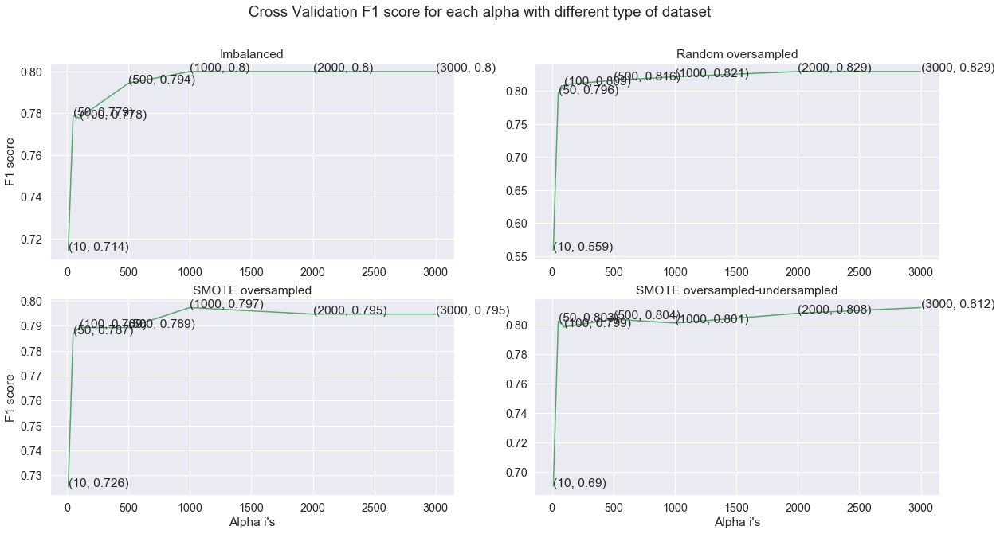

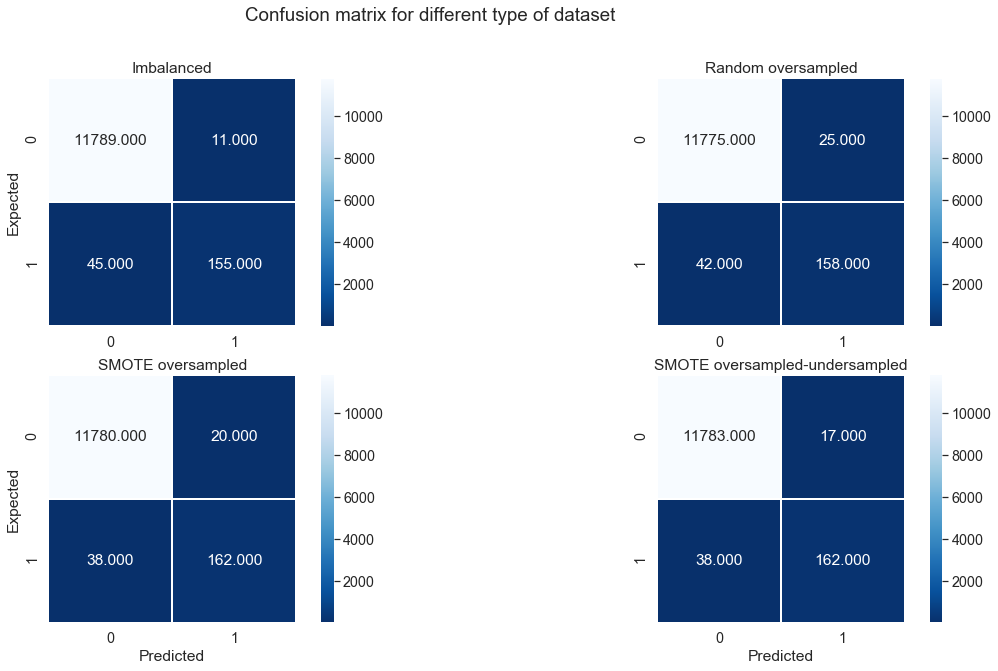

In [167]:
# plot F1score vs hyper parameter alpha values
plot_error(error_list_xgb, alpha,dataset_type)
print("="*127)
# plot confusion matrix
confusion_matrix_plot(clf_list_xgb, X_test, y_test, dataset_type)

#### Lets print AUC , precision and Recall scores for all datasets.

In [1418]:
# Print AUC, precision, recall and AUC score for all models
test_data_all_xgb = other_metric(clf_list_xgb, dataset, X_cv, y_cv, X_test, y_test, dataset_type)

===== Imbalanced =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |    1     |
| CV     | 0.861758 |    0.892308 |    0.725 |
| Test   | 0.887034 |    0.933735 |    0.775 |


===== Random oversampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |   1      |
| CV     | 0.892797 |    0.875    |   0.7875 |
| Test   | 0.893941 |    0.863388 |   0.79   |


===== SMOTE oversampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |     1    |
| CV     | 0.873888 |    0.851064 |     0.75 |
| Test   | 0.904153 |    0.89011  |     0.81 |


===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |  1       |
| CV     | 0.883316 |

From the above plots and table we can see that XgBoost has performed best for 'SMOTE oversampling-undersampling' train dataset. Lets try to perform hyper parameter tunning using random search.

In [168]:
# https://www.analyticsvidhya.com/blog/2016/03/complete-guide-parameter-tuning-xgboost-with-codes-python/
xgb=XGBClassifier()

prams={
    'learning_rate':[0.01,0.03,0.05,0.1,0.15,0.2],
     'n_estimators':[10,50,100,500,1000,2000,3000],
     'max_depth':[3,5,10],
    'colsample_bytree':[0.1,0.3,0.5,1],
    'subsample':[0.1,0.3,0.5,1]
}
random_xgb=RandomizedSearchCV(xgb,param_distributions=prams,verbose=10,n_jobs=-1,random_state = 32)
random_xgb.fit(X_train_osus, y_train_osus)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 31.3min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 45.7min
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed: 69.6min
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed: 97.0min
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed: 122.1min
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed: 147.7min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed: 158.0min finished


RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, gamma=None,
                                           gpu_id=None, importance_type='gain',
                                           interaction_constraints=None,
                                           learning_rate=None,
                                           max_delta_step=None, max_depth=None,
                                           min_child_weight=None, missing=nan,
                                           monotone_constraints=Non...
                                           verbosity=None),
                   iid='deprecated', n_iter=10, n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.1, 0.3, 0.5, 1],
                         

In [169]:
# Print the best parameter from random search
print (random_xgb.best_params_)

{'subsample': 1, 'n_estimators': 3000, 'max_depth': 10, 'learning_rate': 0.15, 'colsample_bytree': 0.5}


In [1419]:
print("Summary of the best Xgboost classifier")
print("="*127)
subsample=1
n_estimators=3000
learning_rate=0.15
colsample_bytree=0.5
max_depth=10
best_xgb = XGBClassifier(n_estimators =n_estimators, learning_rate=learning_rate, colsample_bytree=colsample_bytree,
                                 subsample=subsample, max_depth=max_depth, n_jobs=-1,random_state=32 )
best_xgb.fit(X_train_osus, y_train_osus)
    
predict_y_train = best_xgb.predict(X_train_osus)
f1_train = f1_score(y_train_osus, predict_y_train)
predict_y_cv = best_xgb.predict(X_cv)
f1_cv = f1_score(y_cv, predict_y_cv)
predict_y_test = best_xgb.predict(X_test)
f1_test = f1_score(y_test, predict_y_test)

print('Best xgboost model with SMOTE oversampled-undersampled data ')
print('Train F1 score: ',f1_train)
print('CV F1 score: ',f1_cv)
print('Test F1 score: ',f1_test)
print("="*127)

Summary of the best Xgboost classifier
Best xgboost model with SMOTE oversampled-undersampled data 
Train F1 score:  1.0
CV F1 score:  0.7986348122866894
Test F1 score:  0.8459530026109661


Text(0.5, 27.939999999999984, 'Pred')

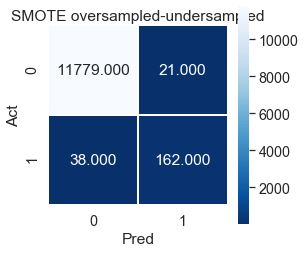

In [172]:
plt.figure(figsize=(4,4))
conf_mat = confusion_matrix(y_true=y_test, y_pred=predict_y_test)
sns.heatmap(conf_mat, annot=True,fmt=".3f", linewidths=.5, square=True, cmap='Blues_r')
plt.title(dataset_type[3])
plt.ylabel('Act')
plt.xlabel('Pred')

Lets print AUC, precision and recall scores for best XgBoost model on SMOTE-oversampled-undersampled dataset.

In [1420]:
# Print AUC, precision, recall and AUC score for all models
test_data_all_best_xgb = other_metric([best_xgb], [[X_train_osus, y_train_osus]], 
                                     X_cv, y_cv, X_test, y_test, [dataset_type[3]])

===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |  1       |
| CV     | 0.864778 |    0.879699 |  0.73125 |
| Test   | 0.90411  |    0.885246 |  0.81    |




In [1421]:
# save the best f1 score 
best_score['XgBoost'] = [dataset_type[3], f1_test_list_xgb[3],test_data_all_xgb[3][1],
                               test_data_all_xgb[3][2],test_data_all_xgb[3][3]]

### Observation
- Here in XgBoost we have received better result than logistic regression and random forest. 
- Among four dataset, 'SMOTE oversampling-undersampling' dataset has best f1 score on test data. we have achived 0.81 f1 score for cv data and 0.85 for test data.
- total 55 (38+17) data points are wrongly classified (from confussion matrix).
- NeXt we have performed random search on same dataset 'SMOTE oversampling-undersampling' and achived f1 score of 0.79 on cv data and 0.84 on test data.
- Looking at the AUC, precision and recall we have achived 0.90 test AUC score and 0.90 precision and 0.81 recall on test data on SMOTE-oversampled-downsampled dataset.
- After Random search we have achived good score but precision is reduced little than our previous model on SMOTE-oversampled-donwsamppled. Hence we will take the earlier model stored in clf_list_xgb[3] as best XgBoost model.

## 7.6 Stacking of best models (Logistic Regression, Random forest and XgBoost)

Lets stack our three models - Logistic regression, Random Forest and XgBoost.

In [178]:
# Best logistic regression Model --- > clf_list_log_reg[0]
# Best Random forest Model ---- > best_rf
# Best XgBoost Model --- > best_xgb
from mlxtend.classifier import StackingClassifier

f1_s_list = []
stack_clf_list = []
alpha = [0.0001,0.001,0.01,0.1,1,10] 
for i in alpha:
    lr = LogisticRegression(C=i)
    stack_clf = StackingClassifier(classifiers=[clf_list_log_reg[0], best_rf, best_xgb], meta_classifier=lr)
    stack_clf.fit(X_train_osus, y_train_osus)
    predict_y_cv = stack_clf.predict(X_cv)
    f1_s = f1_score(y_cv, predict_y_cv)
    print("Stacking Classifer : for the value of alpha: %f and cv f1 Score : %0.3f" % (i, f1_s))
    stack_clf_list.append(stack_clf)
    f1_s_list.append(f1_s)

Stacking Classifer : for the value of alpha: 0.000100 and cv f1 Score : 0.000
Stacking Classifer : for the value of alpha: 0.001000 and cv f1 Score : 0.740
Stacking Classifer : for the value of alpha: 0.010000 and cv f1 Score : 0.797
Stacking Classifer : for the value of alpha: 0.100000 and cv f1 Score : 0.799
Stacking Classifer : for the value of alpha: 1.000000 and cv f1 Score : 0.799
Stacking Classifer : for the value of alpha: 10.000000 and cv f1 Score : 0.799


In [180]:
best_alpha = np.argmax(f1_s_list)

stacked_clf = stack_clf_list[best_alpha]
predict_y_train = stacked_clf.predict(X_train_osus)
f1_train = f1_score(y_train_osus, predict_y_train)
predict_y_cv = stacked_clf.predict(X_cv)
f1_cv = f1_score(y_cv, predict_y_cv)
predict_y_test = stacked_clf.predict(X_test)
f1_test = f1_score(y_test, predict_y_test)
print("="*127)
print('Stacked model with SMOTE oversampled-undersampled data ')
print('Train F1 score: ',f1_train)
print('CV F1 score: ',f1_cv)
print('Test F1 score: ',f1_test)
print("="*127)

Stacked model with SMOTE oversampled-undersampled data 
Train F1 score:  1.0
CV F1 score:  0.7986348122866894
Test F1 score:  0.8459530026109661


Text(0.5, 27.939999999999984, 'Pred')

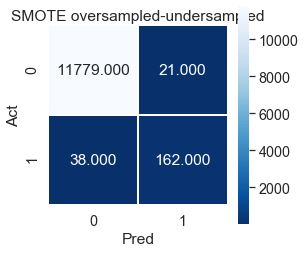

In [183]:
plt.figure(figsize=(4,4))
conf_mat = confusion_matrix(y_true=y_test, y_pred=predict_y_test)
sns.heatmap(conf_mat, annot=True,fmt=".3f", linewidths=.5, square=True, cmap='Blues_r')
plt.title(dataset_type[3])
plt.ylabel('Act')
plt.xlabel('Pred')

Lets print AUC, precision and recall scores for stacked model on SMOTE-oversampled-undersampled dataset.

In [1422]:
# Print AUC, precision, recall and AUC score for all models
test_data_all_best_stack = other_metric([stacked_clf], [[X_train_osus, y_train_osus]], 
                                     X_cv, y_cv, X_test, y_test, [dataset_type[3]])

===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |  1       |
| CV     | 0.864778 |    0.879699 |  0.73125 |
| Test   | 0.90411  |    0.885246 |  0.81    |




In [1431]:
# save the best f1 score 
best_score['Stacked Classifier'] = [dataset_type[3], f1_test, test_data_all_best_stack[0][1],
                               test_data_all_best_stack[0][2],test_data_all_best_stack[0][3]]


### Observation
- Here in Stacked model we have stacked all three model (logistic regression, Random forest and XgBoost) and used logistic regression as meta classifier. 
- We have used 'SMOTE oversampling-undersampling' as our dataset for stacked model. 
- This model has same performace as our XgB model. test AUC is 0.90 and test precision and recall are 0.88 and 0.81 respectively.
- In this stacked model we have achived 0.79 cv f1 score and 0.845 f1 score.
- Total (21+38) 59 data points has been wrongly classified (from confussion matrix).

## 7.7 Best scores from Machine learning classifer

In [1427]:
summary_score= []
print("Summary of the All machine learning Models")
print("="*127)
for model in best_score:
    temp = [model, best_score[model][0],best_score[model][1],best_score[model][2],best_score[model][3],best_score[model][4]]
    summary_score.append(temp)

print (tabulate(summary_score,headers=['Model','Dataset_type','test f1 score','test AUC','test precision','test recall'], tablefmt='orgtbl'))
print("="*127)

Summary of the All machine learning Models
| Model              | Dataset_type                   |   test f1 score |   test AUC |   test precision |   test recall |
|--------------------+--------------------------------+-----------------+------------+------------------+---------------|
| Log_reg            | Imbalanced                     |        0.681818 |   0.798644 |         0.789474 |         0.6   |
| Random_Forest      | SMOTE oversampled-undersampled |        0.805    |   0.900847 |         0.805    |         0.805 |
| XgBoost            | SMOTE oversampled-undersampled |        0.854881 |   0.90428  |         0.905028 |         0.81  |
| Stacked Classifier | SMOTE oversampled-undersampled |        0.845953 |   0.90411  |         0.933735 |         0.775 |


Lets save Xgboost model (with best test f1 score).

In [191]:
# Save the best XgBoost model from clf_list_xgb saved list. In this list 3rd param is our 'SMOTE oversampled-undersampled'.
# Hence save clf_list_xgb[3] as best XgBoost model.

with open("XgBoost_model.pkl", "wb") as f:
    pkl.dump(clf_list_xgb[3], f)

In [1587]:
init_columns = list(project_data.columns[2:].values)

In [1588]:
# save all required feature sets 
pkl.dump((init_columns, drop_columns, hist_sensor_sort, hist_col, non_TB_feature),open('feature_list.pkl','wb'))
pkl.dump(scaler, open('norm_scaler.pkl','wb'))

# 8. Deep learing Model

As we have static and dynamic features we will try out different technique (using LSTM to get the temporal nature of our dataset) as below to check if these model performs better than machine learning model.
- Ensemble Model
- Hybrid Model

Below implementation is based on <a href='https://arxiv.org/pdf/1712.08160.pdf'>this</a> research paper.

## 8.1 Ensemble Model using LSTM and Random Forest

In this we will try to implement an ensemble model using LSTM and Random Forest.
- This model has two steps. In first step a RF classifier is built on static data and a LSTM model built on dynamic data. The output prediction of these models are then applied to a general classifier RF to train our final model. Below figure is for reference.
- Also we will train this model on our 'SMOTE oversampling-undersampling'.

<img src='Ensemble.png' width="500" height="500" />

In [212]:
# First get the static data columns from our dataset.
col_name  = [x for x in list(processed_data.columns.values) if x not in hist_col]

# Static features from 'SMOTE oversampling-undersampling' dataset
static_train_data = X_train_osus[col_name]
static_cv_data = X_cv[col_name]
static_test_data = X_test[col_name]

# Dynamic features from 'SMOTE oversampling-undersampling' dataset
dynamic_train_data = X_train_osus[hist_col]
dynamic_cv_data = X_cv[hist_col]
dynamic_test_data = X_test[hist_col]

In [213]:
print('Total feature count : ', X_train_osus.shape[1])
print('Total static feature count : ', static_train_data.shape[1])
print('Total dynamic feature count : ', dynamic_train_data.shape[1])

Total feature count :  176
Total static feature count :  106
Total dynamic feature count :  70


In [378]:
# Prepare input data for LSTM

col_sen_7 = ['sensor7_histogram_bin0','sensor7_histogram_bin1','sensor7_histogram_bin2','sensor7_histogram_bin3',
             'sensor7_histogram_bin4','sensor7_histogram_bin5','sensor7_histogram_bin6', 'sensor7_histogram_bin7',
             'sensor7_histogram_bin8','sensor7_histogram_bin9']
col_sen_24 = ['sensor24_histogram_bin0','sensor24_histogram_bin1','sensor24_histogram_bin2','sensor24_histogram_bin3',
             'sensor24_histogram_bin4','sensor24_histogram_bin5','sensor24_histogram_bin6', 'sensor24_histogram_bin7',
             'sensor24_histogram_bin8','sensor24_histogram_bin9']
col_sen_25 = ['sensor25_histogram_bin0','sensor25_histogram_bin1','sensor25_histogram_bin2','sensor25_histogram_bin3',
             'sensor25_histogram_bin4','sensor25_histogram_bin5','sensor25_histogram_bin6', 'sensor25_histogram_bin7',
             'sensor25_histogram_bin8','sensor25_histogram_bin9']
col_sen_26 = ['sensor26_histogram_bin0','sensor26_histogram_bin1','sensor26_histogram_bin2','sensor26_histogram_bin3',
             'sensor26_histogram_bin4','sensor26_histogram_bin5','sensor26_histogram_bin6', 'sensor26_histogram_bin7',
             'sensor26_histogram_bin8','sensor26_histogram_bin9']
col_sen_64 = ['sensor64_histogram_bin0','sensor64_histogram_bin1','sensor64_histogram_bin2','sensor64_histogram_bin3',
             'sensor64_histogram_bin4','sensor64_histogram_bin5','sensor64_histogram_bin6', 'sensor64_histogram_bin7',
             'sensor64_histogram_bin8','sensor64_histogram_bin9']
col_sen_69 = ['sensor69_histogram_bin0','sensor69_histogram_bin1','sensor69_histogram_bin2','sensor69_histogram_bin3',
             'sensor69_histogram_bin4','sensor69_histogram_bin5','sensor69_histogram_bin6', 'sensor69_histogram_bin7',
             'sensor69_histogram_bin8','sensor69_histogram_bin9']
col_sen_105 = ['sensor105_histogram_bin0','sensor105_histogram_bin1','sensor105_histogram_bin2','sensor105_histogram_bin3',
             'sensor105_histogram_bin4','sensor105_histogram_bin5','sensor105_histogram_bin6', 'sensor105_histogram_bin7',
             'sensor105_histogram_bin8','sensor105_histogram_bin9']

def get_tensor(dynamic_data):
    ''' This function will take all dynamic features and build it for input to LSTM'''
    all_row = []
    for d in range(len(dynamic_data)):
        single_row = []
        single_row.append(list(dynamic_data.iloc[d][col_sen_7].values))
        single_row.append(list(dynamic_data.iloc[d][col_sen_24].values))
        single_row.append(list(dynamic_data.iloc[d][col_sen_25].values))
        single_row.append(list(dynamic_data.iloc[d][col_sen_26].values))
        single_row.append(list(dynamic_data.iloc[d][col_sen_64].values))
        single_row.append(list(dynamic_data.iloc[d][col_sen_69].values))
        single_row.append(list(dynamic_data.iloc[d][col_sen_105].values))
        all_row.append(single_row)
    
    return tf.convert_to_tensor(all_row, dtype=tf.float32)

In [277]:
# Convert the input data to tensor
dynamic_train_lstm_data = get_tensor(dynamic_train_data)

# Prepare onehot vector for target variable
from tensorflow.keras.utils import to_categorical
y_train_osus_one = to_categorical(y_train_osus)
y_cv_one = to_categorical(y_cv)

In [317]:
# Perform stage1 preprocessing steps for X_cv and X_test --- Both dynamic model(LSTM) and static model(RF)

#*************************Dynamic features*******************************
# Convert the input data to tensor
dynamic_cv_lstm_data = get_tensor(dynamic_cv_data)
dynamic_test_lstm_data = get_tensor(dynamic_test_data)

In [1520]:
# Build LSTM on the dynamic features
import tensorflow as tf
from tensorflow.keras.models import Model

input_lstm_en = tf.keras.layers.Input(shape=(7,10))
l = tf.keras.layers.LSTM(100) (input_lstm_en)
l = tf.keras.layers.Flatten() (l)
l = tf.keras.layers.Dense(16,activation='relu') (l)
l = tf.keras.layers.Dropout(0.4) (l)
l = tf.keras.layers.Dense(8,activation='relu') (l)

lstm_output_en = tf.keras.layers.Dense(2,activation='softmax') (l)

lstm_model_en = Model(inputs=input_lstm_en ,outputs= lstm_output_en)

print(lstm_model_en.summary())

Model: "model_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_14 (InputLayer)        [(None, 7, 10)]           0         
_________________________________________________________________
lstm_16 (LSTM)               (None, 100)               44400     
_________________________________________________________________
flatten_6 (Flatten)          (None, 100)               0         
_________________________________________________________________
dense_25 (Dense)             (None, 16)                1616      
_________________________________________________________________
dropout_5 (Dropout)          (None, 16)                0         
_________________________________________________________________
dense_26 (Dense)             (None, 8)                 136       
_________________________________________________________________
dense_27 (Dense)             (None, 2)                 18 

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


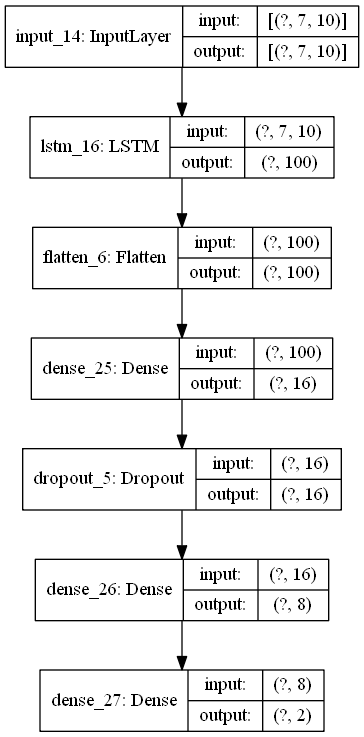

In [1545]:
%load_ext tensorboard
from keras.utils.vis_utils import plot_model

tf.keras.utils.plot_model(lstm_model_en, "model_plot_lstm_en.png",show_shapes=True )

In [1521]:
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import auc, f1_score, roc_auc_score
from tensorflow.keras.callbacks import ModelCheckpoint
import datetime

## Save model if the validation accuracy is improved from previos epoch
filepath="best_LSTM_model_en_1.h5"
checkpoint = ModelCheckpoint(filepath=filepath, monitor='val_f1_score',  verbose=1, save_best_only=True, mode='max')

# here we are creating a list with all the callbacks we want
callback_list = [checkpoint]

In [1522]:
import tensorflow_addons as tfa

epoch = 50
batch_size = 64
lstm_model_en.compile(loss='categorical_crossentropy',optimizer='adam',
                      metrics=[tfa.metrics.F1Score(num_classes=2, average="micro")])
lstm_model_en.fit(dynamic_train_lstm_data, y_train_osus_one,
                  batch_size=batch_size,
                  validation_data=(dynamic_cv_lstm_data, y_cv_one),
                  callbacks = callback_list,
                  epochs=epoch,
                  verbose=1)

Epoch 1/50
649/649 [==============================] - ETA: 0s - loss: 0.1760 - f1_score: 0.9389
Epoch 00001: val_f1_score improved from -inf to 0.97510, saving model to best_LSTM_model_en_1.h5
649/649 [==============================] - 33s 50ms/step - loss: 0.1760 - f1_score: 0.9389 - val_loss: 0.0513 - val_f1_score: 0.9751
Epoch 2/50
649/649 [==============================] - ETA: 0s - loss: 0.1428 - f1_score: 0.9458
Epoch 00002: val_f1_score did not improve from 0.97510
649/649 [==============================] - 33s 50ms/step - loss: 0.1428 - f1_score: 0.9458 - val_loss: 0.0719 - val_f1_score: 0.9685
Epoch 3/50
648/649 [============================>.] - ETA: 0s - loss: 0.1368 - f1_score: 0.9459
Epoch 00003: val_f1_score did not improve from 0.97510
649/649 [==============================] - 31s 47ms/step - loss: 0.1369 - f1_score: 0.9459 - val_loss: 0.0666 - val_f1_score: 0.9711
Epoch 4/50
649/649 [==============================] - ETA: 0s - loss: 0.1355 - f1_score: 0.9482 ETA: 1s
Ep

Epoch 29/50
649/649 [==============================] - ETA: 0s - loss: 0.0925 - f1_score: 0.9717
Epoch 00029: val_f1_score did not improve from 0.98979
649/649 [==============================] - 33s 50ms/step - loss: 0.0925 - f1_score: 0.9717 - val_loss: 0.0774 - val_f1_score: 0.9891
Epoch 30/50
649/649 [==============================] - ETA: 0s - loss: 0.0916 - f1_score: 0.9715
Epoch 00030: val_f1_score did not improve from 0.98979
649/649 [==============================] - 36s 55ms/step - loss: 0.0916 - f1_score: 0.9715 - val_loss: 0.0662 - val_f1_score: 0.9834
Epoch 31/50
648/649 [============================>.] - ETA: 0s - loss: 0.0908 - f1_score: 0.9720 ETA: 1s - loss: 0.0901 - f1_score - ETA: 1s - loss: 0.0
Epoch 00031: val_f1_score did not improve from 0.98979
649/649 [==============================] - 37s 57ms/step - loss: 0.0908 - f1_score: 0.9720 - val_loss: 0.0822 - val_f1_score: 0.9865
Epoch 32/50
649/649 [==============================] - ETA: 0s - loss: 0.0916 - f1_score:

In [1523]:
# Load the best model
lstm_model_en.load_weights('best_LSTM_model_en_1.h5')

# Here is the output from LSTM for our train cv and test data
lstm_train_output = lstm_model_en.predict(dynamic_train_lstm_data)
lstm_cv_output = lstm_model_en.predict(dynamic_cv_lstm_data)
lstm_test_output = lstm_model_en.predict(dynamic_test_lstm_data)

- In above cell we have got the prediction from our LSTM model (2 class classification model) for dynamic train data. 
- Next we have to build random forest on our static data and get the predictions.

In [293]:
# train Random forest on static data
rf_en_stage1 = RandomForestClassifier(n_estimators =100, n_jobs=-1,random_state=32 )
rf_en_stage1.fit(static_train_data, y_train_osus)
    
# Get output prediction of train data from random forest model
rf_en_train_stage1_output = rf_en_stage1.predict_proba(static_train_data)
rf_en_cv_stage1_output = rf_en_stage1.predict_proba(static_cv_data)
rf_en_test_stage1_output = rf_en_stage1.predict_proba(static_test_data)

Lets merge both the prediction (from LSTM and RF) and build another random forest on top of the data.

In [1524]:
temp1 = pd.DataFrame(lstm_train_output, columns=['dynamic_f1','dynamic_f2'])
temp2 = pd.DataFrame(rf_en_train_stage1_output, columns=['static_f1','static_f2'])
en_train_stage2 = pd.concat([temp1, temp2], axis=1)
en_train_stage2.head(2)

,dynamic_f1,dynamic_f2,static_f1,static_f2
0,0.959938,0.040062,1.0,0.0
1,0.960459,0.039541,1.0,0.0


In [1525]:
#************************Merge dynamic and static model output***********
temp1 = pd.DataFrame(lstm_cv_output, columns=['dynamic_f1','dynamic_f2'])
temp2 = pd.DataFrame(rf_en_cv_stage1_output, columns=['static_f1','static_f2'])
en_cv_stage2 = pd.concat([temp1, temp2], axis=1)

temp1 = pd.DataFrame(lstm_test_output, columns=['dynamic_f1','dynamic_f2'])
temp2 = pd.DataFrame(rf_en_test_stage1_output, columns=['static_f1','static_f2'])
en_test_stage2 = pd.concat([temp1, temp2], axis=1)

In [314]:
# Perform random search in stage 2 random forest model
rf = RandomForestClassifier()
prams={
     'n_estimators':[100,200,500,1000,2000,3000],
     'max_depth':[3,5,10,15],
}

random_rf_stage2=RandomizedSearchCV(rf,param_distributions=prams,verbose=10,n_jobs=-1,random_state=32)
random_rf_stage2.fit(en_train_stage2, y_train_osus)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  3.8min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:  4.1min finished


RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [316]:
# check the best params from random search
random_rf_stage2.best_params_

{'n_estimators': 2000, 'max_depth': 10}

In [1526]:
print("Summary of the ensemble model using LSTM")
print("="*127)
n_estimators=2000
max_depth=10
best_en_rf = RandomForestClassifier(n_estimators =n_estimators,
                                 max_depth=max_depth,n_jobs=-1,random_state=32 )
best_en_rf.fit(en_train_stage2, y_train_osus)
    
predict_y_train = best_en_rf.predict(en_train_stage2)
f1_train = f1_score(y_train_osus, predict_y_train)

predict_y_cv = best_en_rf.predict(en_cv_stage2)
f1_cv = f1_score(y_cv, predict_y_cv)

predict_y_test = best_en_rf.predict(en_test_stage2)
f1_test = f1_score(y_test, predict_y_test)

print('Best ensemble model using LSTM with SMOTE oversampled-undersampled data ')
print('Train F1 score: ',f1_train)
print('CV F1 score: ',f1_cv)
print('Test F1 score: ',f1_test)
print("="*127)

Summary of the ensemble model using LSTM
Best ensemble model using LSTM with SMOTE oversampled-undersampled data 
Train F1 score:  1.0
CV F1 score:  0.7358490566037736
Test F1 score:  0.7699757869249395


Text(0.5, 27.939999999999984, 'Pred')

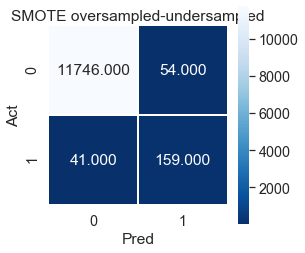

In [1527]:
plt.figure(figsize=(4,4))
conf_mat = confusion_matrix(y_true=y_test, y_pred=predict_y_test)
sns.heatmap(conf_mat, annot=True,fmt=".3f", linewidths=.5, square=True, cmap='Blues_r')
plt.title(dataset_type[3])
plt.ylabel('Act')
plt.xlabel('Pred')

Lets print AUC, precision and recall scores for ensambled model on SMOTE-oversampled-undersampled dataset.

In [1528]:
# Print AUC, precision, recall and AUC score for all models
test_data_all_best_en = other_metric([best_en_rf], [[en_train_stage2, y_train_osus]], 
                                     en_cv_stage2, y_cv, en_test_stage2, y_test, [dataset_type[3]])

===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 1        |    1        |  1       |
| CV     | 0.863453 |    0.740506 |  0.73125 |
| Test   | 0.895212 |    0.746479 |  0.795   |




In [1529]:
# save the best f1 score 
best_score['Ensemble(LSTM and RF)'] = [dataset_type[3], f1_test, test_data_all_best_en[0][1],
                               test_data_all_best_en[0][2],test_data_all_best_en[0][3]]


### Observation
- In the above model we have tried to take advantages of the dynamic features(time based sensors).
- We have trained this above model on 'SMOTE oversampled-undersampled' data.
- Here first we have splited our features into static and dynamic feature set for train data.
- Next we have converted our dynamic feature to tensors uisng get_tensor funtion. This tensor shape will be (datapoints,10,7).
here 10 is no of time based bins for each sensors and 7 is number of sensor which has tiem based bins.
- Build a deep LSTM model of 100 units with 2 class softmax at last dense layer with the tensor input data as input.
- This LSTM model will give output of shape (datapoints, 2).
- Here i have used checkpoints to store the best LSTM model and loaded it after my tranning and converted my train, cv and test data as input to my stage 2 model (RF).
- Next build a Random forest model on our static features. use predict_proba function to get the probablity values of both classes. The out put from this model will be (datapoints,2)
- Now we will concat both the output data from LSTM and RF. This data shape will be (datapoints,4)
- Now use these new 4 feature as our feature set and try to build a Random forest model. Using Random search CV we tried to get the best f1 score.
- This ensamble model achived 0.73 f1 score on CV data and 0.76 f1 score on test data.
- This model achived test AUC of 0.89 0.74 precision and 0.79 recall.
- This model's performace is not that good as we achived from XgBoost or Simple Random forest model. This could be because of the very small time bins for each sensors i.e only 10 time bins per sensor. As per the research paper in case dynamic feature does not hold a good information on temporal nature of the dataset in that case model may not perform good.

## 8.2 Hybrid Model using LSTM and Random Forest

In this we will try to implement an hybrid model using LSTM and Random Forest.
- This model has two steps. In first step we will build a LSTM layer on dynamic data. This layer will be used to get some important features. This extracted feature we will concat with static data and perform Random forest on top of it. .
- Also we will train this model on our 'SMOTE oversampling-undersampling'.
- Below is the architecture.

<img src='Hybrid.png' width="500" height="500" />

In [1502]:
# Build LSTM on the dynamic features of train data

input_lstm_hy = tf.keras.layers.Input(shape=(7,10))

l1 = tf.keras.layers.LSTM(100) (input_lstm_hy)
l1 = tf.keras.layers.Flatten() (l1)
l1 = tf.keras.layers.Dense(32,activation='relu') (l1)
l1 = tf.keras.layers.Dropout(0.4) (l1)
lstm_output_hy1 = tf.keras.layers.Dense(10,activation='relu') (l1)

lstm_output_hy2 = tf.keras.layers.Dense(2,activation='softmax') (lstm_output_hy1)



lstm_model_hy = Model(inputs=input_lstm_hy ,outputs= lstm_output_hy2)

print(lstm_model_hy.summary())

Model: "model_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_13 (InputLayer)        [(None, 7, 10)]           0         
_________________________________________________________________
lstm_15 (LSTM)               (None, 100)               44400     
_________________________________________________________________
flatten_5 (Flatten)          (None, 100)               0         
_________________________________________________________________
dense_22 (Dense)             (None, 32)                3232      
_________________________________________________________________
dropout_4 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_23 (Dense)             (None, 10)                330       
_________________________________________________________________
dense_24 (Dense)             (None, 2)                 22 

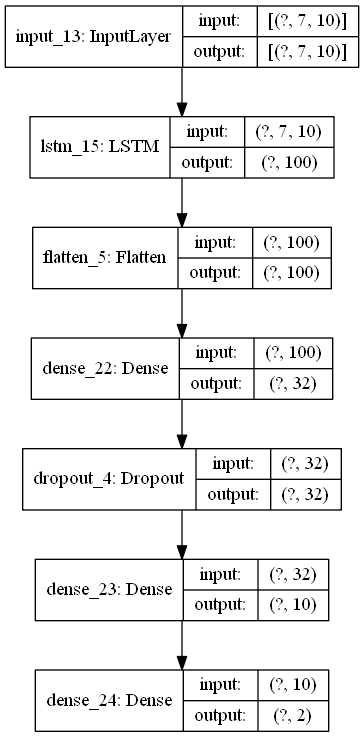

In [1546]:
%reload_ext tensorboard
from keras.utils.vis_utils import plot_model

tf.keras.utils.plot_model(lstm_model_hy, "model_plot_lstm_hy.png",show_shapes=True )

In [1504]:
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import auc, f1_score, roc_auc_score
from tensorflow.keras.callbacks import ModelCheckpoint
import datetime

## Save model if the validation accuracy is improved from previos epoch
filepath="best_LSTM_model_hy_1.h5"
checkpoint = ModelCheckpoint(filepath=filepath, monitor='val_f1_score',  verbose=1, save_best_only=True, mode='max')

# here we are creating a list with all the callbacks we want
callback_list = [checkpoint]

In [1505]:
import tensorflow_addons as tfa

epoch = 50
batch_size = 64
lstm_model_hy.compile(loss='categorical_crossentropy',optimizer='adam',
                      metrics=[tfa.metrics.F1Score(num_classes=2, average="micro")])
lstm_model_hy.fit(dynamic_train_lstm_data, y_train_osus_one,
                  batch_size=batch_size,
                  validation_data=(dynamic_cv_lstm_data, y_cv_one),
                  callbacks = callback_list,
                  epochs=epoch,
                  verbose=1)

Epoch 1/50
649/649 [==============================] - ETA: 0s - loss: 0.1778 - f1_score: 0.9501
Epoch 00001: val_f1_score improved from -inf to 0.97198, saving model to best_LSTM_model_hy_1.h5
649/649 [==============================] - 35s 53ms/step - loss: 0.1778 - f1_score: 0.9501 - val_loss: 0.0692 - val_f1_score: 0.9720
Epoch 2/50
649/649 [==============================] - ETA: 0s - loss: 0.1382 - f1_score: 0.9538
Epoch 00002: val_f1_score improved from 0.97198 to 0.97490, saving model to best_LSTM_model_hy_1.h5
649/649 [==============================] - 31s 48ms/step - loss: 0.1382 - f1_score: 0.9538 - val_loss: 0.0640 - val_f1_score: 0.9749
Epoch 3/50
649/649 [==============================] - ETA: 0s - loss: 0.1314 - f1_score: 0.9556
Epoch 00003: val_f1_score improved from 0.97490 to 0.98354, saving model to best_LSTM_model_hy_1.h5
649/649 [==============================] - 31s 48ms/step - loss: 0.1314 - f1_score: 0.9556 - val_loss: 0.0583 - val_f1_score: 0.9835
Epoch 4/50
649/6

In [1508]:
lstm_model_hy.layers

In [1509]:
# lets load the best model weights
lstm_model_hy.load_weights('best_LSTM_model_hy_1.h5')

# Lets get the last activations from last dense layer (10 dim vector) (previous layer of softmax)
def dense_output(lstm_model_hy, input):
    for i in range(1,6):
        input = lstm_model_hy.layers[i](input)
    return input

LSTM_actives_hy = dense_output(lstm_model_hy, dynamic_train_lstm_data)

In [1511]:
LSTM_actives_hy.shape

TensorShape([41536, 10])

In [1512]:
# Convert the LSTM extraction to a temp dataframe
temp1 = pd.DataFrame(LSTM_actives_hy.numpy())

# Concat this LSTM extracted data with Static data
hy_train_stage2 = pd.concat([temp1, static_train_data], axis=1)

hy_train_stage2.head(3)

,0,1,2,3,4,5,6,7,8,9,sensor1_measure,sensor3_measure,sensor4_measure,sensor5_measure,sensor6_measure,sensor8_measure,sensor9_measure,sensor10_measure,sensor11_measure,sensor12_measure,sensor13_measure,sensor14_measure,sensor15_measure,sensor16_measure,sensor17_measure,sensor18_measure,sensor19_measure,sensor20_measure,sensor21_measure,sensor22_measure,sensor23_measure,sensor27_measure,sensor28_measure,sensor29_measure,sensor30_measure,sensor31_measure,sensor32_measure,sensor33_measure,sensor34_measure,sensor35_measure,sensor36_measure,sensor37_measure,sensor44_measure,sensor45_measure,sensor46_measure,sensor47_measure,sensor48_measure,sensor49_measure,sensor50_measure,sensor51_measure,sensor52_measure,sensor53_measure,sensor55_measure,sensor56_measure,sensor57_measure,sensor58_measure,sensor59_measure,sensor60_measure,sensor61_measure,sensor62_measure,sensor63_measure,sensor65_measure,sensor66_measure,sensor67_measure,sensor70_measure,sensor71_measure,sensor72_measure,sensor73_measure,sensor74_measure,sensor75_measure,sensor76_measure,sensor77_measure,sensor78_measure,sensor79_measure,sensor80_measure,sensor81_measure,sensor82_measure,sensor83_measure,sensor84_measure,sensor85_measure,sensor86_measure,sensor87_measure,sensor88_measure,sensor89_measure,sensor90_measure,sensor91_measure,sensor92_measure,sensor93_measure,sensor94_measure,sensor95_measure,sensor96_measure,sensor97_measure,sensor98_measure,sensor99_measure,sensor100_measure,sensor101_measure,sensor102_measure,sensor103_measure,sensor104_measure,sensor106_measure,sensor107_measure,sensor7_MaxC,sensor24_MaxC,sensor25_MaxC,sensor26_MaxC,sensor64_MaxC,sensor69_MaxC,sensor105_MaxC,sensor7_MoveAvg,sensor24_MoveAvg,sensor25_MoveAvg,sensor26_MoveAvg,sensor64_MoveAvg,sensor69_MoveAvg,sensor105_MoveAvg,AvgChangeNT
0,0.608208,0.610217,0.0,0.0,0.277527,0.835881,0.540809,0.0,1.751084,0.0,0.000711,1.0,2.096852e-09,0.0,0.0,0.000616,0.0,0.0,0.0,0.0,0.0,0.000730,0.000757,0.000210,0.000312,0.0,0.0,0.0,0.0,0.000048,0.000189,0.000618,0.00000,0.000013,0.000002,0.000039,0.000616,0.000521,0.000112,0.000248,0.160723,0.169787,0.015503,0.000711,0.000618,0.000618,0.000659,0.000422,0.0,0.097341,0.098386,0.000761,0.000852,2.329835e-10,0.000093,0.0,0.000725,0.0,0.000172,0.0,0.000218,0.000000e+00,0.000008,0.000618,0.000024,0.000106,0.001262,0.000008,0.0,0.000000e+00,0.0,0.000830,0.000853,0.000243,0.000159,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000248,0.000575,0.001637,0.0,0.0,0.000517,0.001066,0.000703,0.000254,0.000000,0.000000,0.0,0.0,0.000721,0.000508,0.000676,0.0,0.0,0.000766,0.000668,0.000238,0.000321,0.000497,0.001585,0.000513,0.000122,0.000087,0.000038,0.000160,0.000091,0.000294,0.000214,0.000589
1,0.627234,0.619441,0.0,0.0,0.281642,0.840722,0.560398,0.0,1.771560,0.0,0.000703,1.0,5.125638e-09,0.0,0.0,0.000660,0.0,0.0,0.0,0.0,0.0,0.000723,0.000734,0.000248,0.000380,0.0,0.0,0.0,0.0,0.000078,0.000360,0.000629,0.00004,0.000033,0.000158,0.000000,0.000660,0.000499,0.000228,0.000198,0.160723,0.169787,0.018414,0.000703,0.000629,0.000629,0.000655,0.000446,0.0,0.098747,0.100056,0.000761,0.000714,2.329835e-10,0.000187,0.0,0.000726,0.0,0.000193,0.0,0.000300,2.329835e-10,0.000012,0.000629,0.000097,0.000218,0.001261,0.001361,0.0,0.000000e+00,0.0,0.001245,0.000853,0.000301,0.000193,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000298,0.000048,0.000414,0.0,0.0,0.000262,0.001130,0.001389,0.000503,0.000000,0.000000,0.0,0.0,0.000703,0.000733,0.000797,0.0,0.0,0.001055,0.000334,0.000235,0.000480,0.000440,0.000941,0.001132,0.000120,0.000048,0.000029,0.000111,0.000078,0.000156,0.000174,0.000600
2,0.576393,0.596964,0.0,0.0,0.269887,0.828316,0.509126,0.0,1.713927,0.0,0.000680,1.0,1.211514e-08,0.0,0.0,0.000600,0.0,0.0,0.0,0.0,0.0,0.000717,0.000739,0.000222,0.000321,0.0,0.0,0.0,0.0,0.000076,0.000274,0.000613,0.00001,0.000033,0.000360,0.000000,0.000600,0.000393,0.000232,0.000150,0.160723,0.169787,0.016409,0.000680,0.000613,0.000613,0.000651,0.000421,0.0,0.096349,0.097592,0.000746,0.000508,2.329835e-10,0.000000,0.0,0.000712,0.0,0.000

In [370]:
# Perform random search in stage 2 -- random forest model
rf = RandomForestClassifier()
prams={
     'n_estimators':[100,200,500,1000,2000,3000],
     'max_depth':[3,5,10,15],
}

random_rf_stage2_hy = RandomizedSearchCV(rf,param_distributions=prams,verbose=10,n_jobs=-1,random_state=32)
random_rf_stage2_hy.fit(hy_train_stage2, y_train_osus)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 12.1min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 15.0min
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed: 20.8min
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed: 37.4min
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed: 43.5min
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed: 48.0min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed: 50.3min finished


RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [371]:
# check the best params from random search
random_rf_stage2_hy.best_params_

{'n_estimators': 500, 'max_depth': 15}

In [1513]:
# Perform stage1 preprocessing steps for X_cv and X_test --- dynamic model(LSTM) and concat that with static features

#*************************Dynamic features*******************************
# Lets get the last activations from last dense layer (10 dim vector) (previous layer of softmax)
LSTM_actives_hy_cv = dense_output(lstm_model_hy, dynamic_cv_lstm_data)
LSTM_actives_hy_test = dense_output(lstm_model_hy, dynamic_test_lstm_data)
        
# Convert the LSTM extraction to a temp dataframe
temp1 = pd.DataFrame(LSTM_actives_hy_cv.numpy())
temp2 = pd.DataFrame(LSTM_actives_hy_test.numpy())

# Concat this LSTM extracted data with Static data
static_cv_data_hy = static_cv_data.copy()
static_test_data_hy = static_test_data.copy()

static_cv_data_hy.reset_index(drop=True, inplace=True)
static_test_data_hy.reset_index(drop=True, inplace=True)

hy_cv_stage2 = pd.concat([temp1, static_cv_data_hy], axis=1)
hy_test_stage2 = pd.concat([temp2, static_test_data_hy ], axis=1)

In [1514]:
print("Summary of the hybrid model using LSTM")
print("="*127)
n_estimators=500
max_depth=15
best_hy_rf = RandomForestClassifier(n_estimators =n_estimators,
                                 max_depth=max_depth,n_jobs=-1,random_state=32 )
best_hy_rf.fit(hy_train_stage2, y_train_osus)
    
predict_y_train = best_hy_rf.predict(hy_train_stage2)
f1_train = f1_score(y_train_osus, predict_y_train)

predict_y_cv = best_hy_rf.predict(hy_cv_stage2)
f1_cv = f1_score(y_cv, predict_y_cv)

predict_y_test = best_hy_rf.predict(hy_test_stage2)
f1_test = f1_score(y_test, predict_y_test)

print('Best hybrid model using LSTM with SMOTE oversampled-undersampled data ')
print('Train F1 score: ',f1_train)
print('CV F1 score: ',f1_cv)
print('Test F1 score: ',f1_test)
print("="*127)

Summary of the hybrid model using LSTM
Best hybrid model using LSTM with SMOTE oversampled-undersampled data 
Train F1 score:  0.9917355371900826
CV F1 score:  0.7515923566878983
Test F1 score:  0.7894736842105263


Text(0.5, 27.939999999999984, 'Pred')

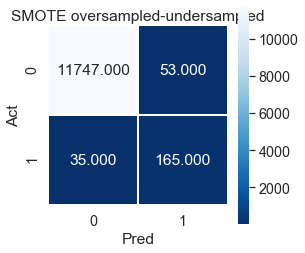

In [1515]:
plt.figure(figsize=(4,4))
conf_mat = confusion_matrix(y_true=y_test, y_pred=predict_y_test)
sns.heatmap(conf_mat, annot=True,fmt=".3f", linewidths=.5, square=True, cmap='Blues_r')
plt.title(dataset_type[3])
plt.ylabel('Act')
plt.xlabel('Pred')

Lets print AUC, precision and recall scores for hybrid model on SMOTE-oversampled-undersampled dataset.

In [1516]:
# Print AUC, precision, recall and AUC score for all models
test_data_all_best_hy = other_metric([best_hy_rf], [[hy_train_stage2, y_train_osus]], 
                                     hy_cv_stage2, y_cv, hy_test_stage2, y_test, [dataset_type[3]])

===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 0.992505 |    0.99839  | 0.985169 |
| CV     | 0.866843 |    0.766234 | 0.7375   |
| Test   | 0.910254 |    0.756881 | 0.825    |




In [1517]:
# save the best f1 score 
best_score['Hybrid (LSTM and RF)'] = [dataset_type[3], f1_test, test_data_all_best_hy[0][1],
                               test_data_all_best_hy[0][2],test_data_all_best_hy[0][3]]


### Observation
- Similar to ensemble model here We have trained this above model on 'SMOTE oversampled-undersampled' data.
- Here first we have splited our features into static and dynamic feature set for train data.
- Next we have converted our dynamic feature to tensors uisng get_tensor funtion. This tensor shape will be (datapoints,10,7).
here 10 is no of time based bins for each sensors and 7 is number of sensor which has tiem based bins.
- Build a LSTM model with 2 class softmax at last dense layer with the tensor input data as input.
- After the model is trained we have used only the trained LSTM layer. We passed the dynamic features of tran data and generated 10 new features.
- Next we have concated these new extracted features with exsting static features and build a Random forest model on this dataset. Using Random search CV we tried to get the best f1 score.
- This hybrid model achived 0.75 f1 score on CV data and 0.76 f1 score on test data.
- This model performed better than ensemble model.
- This model has achived 0.89 test AUC and precision as 0.72 and test recall as 0.805.
- This model's performace is not that good as we achived from XgBoost or Simple Random forest model. This could be because of the very small time bins for each sensors i.e only 10 time bins per sensor. As per the research paper in case dynamic feature does not hold a good information on temporal nature of the dataset in that case model may not perform good.

## 8.3 Convolution LSTM model

In this we will try to implement full neural network model. We will use convolution layer conv1D for our static dataset and LSTM on dynamic data. We will concat both the layer output and train our model with binary cross entropy loss and f1 score as metrics.

In [1538]:
# convert all our static data to tensor for Conv1D input
static_train_conv1d_data = tf.convert_to_tensor(static_train_data, dtype=tf.float32)
static_cv_conv1d_data = tf.convert_to_tensor(static_cv_data, dtype=tf.float32)
static_test_conv1d_data = tf.convert_to_tensor(static_test_data, dtype=tf.float32)

In [1539]:
static_train_conv1d_data.shape, static_cv_conv1d_data.shape, static_test_conv1d_data.shape

(TensorShape([41536, 106]),
 TensorShape([9600, 106]),
 TensorShape([12000, 106]))

In [1543]:
# Build LSTM on the dynamic features and Conv1D on static features of train data
from tensorflow.keras import regularizers

input_lstm_en = tf.keras.layers.Input(shape=(7,10))
l1 = tf.keras.layers.LSTM(100) (input_lstm_en)
l1 = tf.keras.layers.Flatten() (l1)


input_conv_en = tf.keras.layers.Input(shape=(106,1))
l2 = tf.keras.layers.Conv1D(16,3,activation='relu') (input_conv_en)
l2 = tf.keras.layers.Conv1D(16,4,activation='relu') (l2)
l2 = tf.keras.layers.Flatten() (l2)

# Concat all three Conv1D layer
concat = tf.keras.layers.Concatenate(name='Concat1', axis=1)  ([l1,l2])

l = tf.keras.layers.Dense(128,activation='relu',kernel_regularizer=regularizers.l2(1e-3), kernel_initializer='he_normal') (concat)
l = tf.keras.layers.Dropout(0.5, name='Dropout1') (l)
l = tf.keras.layers.Dense(128,activation='relu', name='Dense2',kernel_regularizer=regularizers.l2(1e-3), kernel_initializer='he_normal') (l)
l = tf.keras.layers.Dropout(0.5, name='Dropout2') (l)
l = tf.keras.layers.Dense(16,activation='relu', name='Dense5',kernel_initializer='he_normal') (l)
out = tf.keras.layers.Dense(2,activation='softmax', name ='OutputLayer')     (l)


lstm_conv_model_en = Model(inputs=(input_lstm_en,input_conv_en) ,outputs= out)

print(lstm_conv_model_en.summary())

Model: "model_13"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_22 (InputLayer)           [(None, 106, 1)]     0                                            
__________________________________________________________________________________________________
input_21 (InputLayer)           [(None, 7, 10)]      0                                            
__________________________________________________________________________________________________
conv1d_6 (Conv1D)               (None, 104, 16)      64          input_22[0][0]                   
__________________________________________________________________________________________________
lstm_20 (LSTM)                  (None, 100)          44400       input_21[0][0]                   
___________________________________________________________________________________________

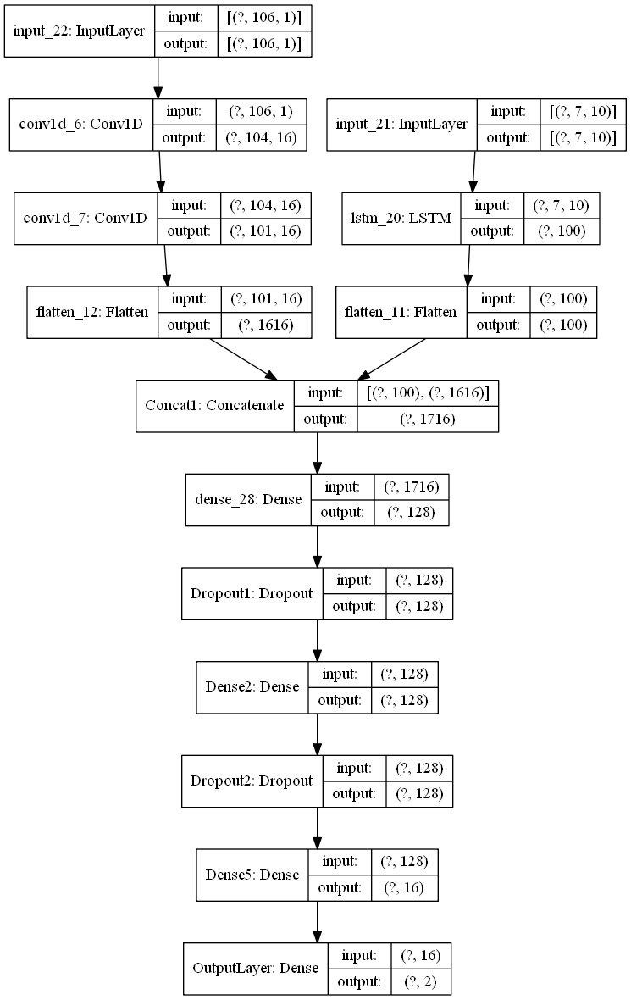

In [1544]:
%load_ext tensorboard
from keras.utils.vis_utils import plot_model

tf.keras.utils.plot_model(lstm_conv_model_en, "model_plot_lstm_conv.png",show_shapes=True )

In [1547]:
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import auc, f1_score, roc_auc_score
from tensorflow.keras.callbacks import ModelCheckpoint
import datetime

## Save model if the validation accuracy is improved from previos epoch
filepath="best_LSTM_conv_model_1.h5"
checkpoint = ModelCheckpoint(filepath=filepath, monitor='val_f1_score',  verbose=1, save_best_only=True, mode='max')

# here we are creating a list with all the callbacks we want
callback_list = [checkpoint]

In [1548]:
import tensorflow_addons as tfa

epoch = 50
batch_size = 64
lstm_conv_model_en.compile(loss='categorical_crossentropy',optimizer='adam',
                          metrics=[tfa.metrics.F1Score(num_classes=2, average="micro")])
lstm_conv_model_en.fit([dynamic_train_lstm_data,static_train_conv1d_data], y_train_osus_one,
                      batch_size=batch_size,
                      validation_data=([dynamic_cv_lstm_data,static_cv_conv1d_data], y_cv_one),
                      callbacks = callback_list,
                      epochs=epoch,
                      verbose=1)

Epoch 1/50
649/649 [==============================] - ETA: 0s - loss: 0.2116 - f1_score: 0.9567
Epoch 00001: val_f1_score improved from -inf to 0.98000, saving model to best_LSTM_conv_model_1.h5
649/649 [==============================] - 69s 107ms/step - loss: 0.2116 - f1_score: 0.9567 - val_loss: 0.0667 - val_f1_score: 0.9800
Epoch 2/50
649/649 [==============================] - ETA: 0s - loss: 0.1083 - f1_score: 0.9672
Epoch 00002: val_f1_score improved from 0.98000 to 0.98406, saving model to best_LSTM_conv_model_1.h5
649/649 [==============================] - 56s 86ms/step - loss: 0.1083 - f1_score: 0.9672 - val_loss: 0.0547 - val_f1_score: 0.9841
Epoch 3/50
649/649 [==============================] - ETA: 0s - loss: 0.0938 - f1_score: 0.9713 ETA: 0s - loss: 0.0936 - f1_s
Epoch 00003: val_f1_score did not improve from 0.98406
649/649 [==============================] - 60s 93ms/step - loss: 0.0938 - f1_score: 0.9713 - val_loss: 0.0720 - val_f1_score: 0.9716
Epoch 4/50
649/649 [======

Epoch 28/50
649/649 [==============================] - ETA: 0s - loss: 0.0629 - f1_score: 0.9822 ETA: 0s - loss: 0.0631 - f1_score - ETA: 0s - loss: 0.0630 - f1_score: 0.
Epoch 00028: val_f1_score did not improve from 0.99052
649/649 [==============================] - 53s 82ms/step - loss: 0.0629 - f1_score: 0.9822 - val_loss: 0.0478 - val_f1_score: 0.9856
Epoch 29/50
649/649 [==============================] - ETA: 0s - loss: 0.0620 - f1_score: 0.9829
Epoch 00029: val_f1_score did not improve from 0.99052
649/649 [==============================] - 49s 76ms/step - loss: 0.0620 - f1_score: 0.9829 - val_loss: 0.0388 - val_f1_score: 0.9904
Epoch 30/50
649/649 [==============================] - ETA: 0s - loss: 0.0623 - f1_score: 0.9826
Epoch 00030: val_f1_score did not improve from 0.99052
649/649 [==============================] - 49s 75ms/step - loss: 0.0623 - f1_score: 0.9826 - val_loss: 0.0437 - val_f1_score: 0.9890
Epoch 31/50
649/649 [==============================] - ETA: 0s - loss: 

In [1549]:
y_test_one = to_categorical(y_test)

# print f1 score for train , cv and test data
lstm_conv_model_en.load_weights('best_LSTM_conv_model_1.h5')
train_score = lstm_conv_model_en.evaluate([dynamic_train_lstm_data,static_train_conv1d_data], 
                                          y_train_osus_one, verbose=0, batch_size=batch_size)

cv_score = lstm_conv_model_en.evaluate([dynamic_cv_lstm_data,static_cv_conv1d_data], 
                                          y_cv_one, verbose=0, batch_size=batch_size)

test_score = lstm_conv_model_en.evaluate([dynamic_test_lstm_data,static_test_conv1d_data], 
                                          y_test_one, verbose=0, batch_size=batch_size)


print("Summary of the hybrid model using LSTM")
print("="*127)
print('Best convolution LSTM model with SMOTE oversampled-undersampled data ')
print('Train F1 score: ',train_score[1])
print('CV F1 score: ',cv_score[1])
print('Test F1 score: ',test_score[1])
print("="*127)

Summary of the hybrid model using LSTM
Best convolution LSTM model with SMOTE oversampled-undersampled data 
Train F1 score:  0.9837971925735474
CV F1 score:  0.9915624856948853
Test F1 score:  0.9908333420753479


In [1557]:
# Get class labls from the output of our deep NN
temp = lstm_conv_model_en.predict([dynamic_test_lstm_data,static_test_conv1d_data])
predict_y_test = np.argmax(temp, axis=-1)

temp = lstm_conv_model_en.predict([dynamic_train_lstm_data,static_train_conv1d_data])
predict_y_train = np.argmax(temp, axis=-1)

temp = lstm_conv_model_en.predict([dynamic_cv_lstm_data,static_cv_conv1d_data])
predict_y_cv = np.argmax(temp, axis=-1)

Text(0.5, 27.939999999999984, 'Pred')

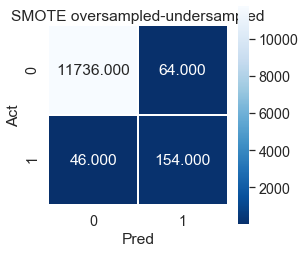

In [1558]:
plt.figure(figsize=(4,4))
conf_mat = confusion_matrix(y_true=y_test, y_pred=predict_y_test)
sns.heatmap(conf_mat, annot=True,fmt=".3f", linewidths=.5, square=True, cmap='Blues_r')
plt.title(dataset_type[3])
plt.ylabel('Act')
plt.xlabel('Pred')

Lets print AUC, precision and recall scores for convolution LSTM model on SMOTE-oversampled-undersampled dataset.

In [1561]:
from sklearn.metrics import precision_score, recall_score

data_val = ['Data','AUC','Precision','Recall']
test_data_all_best_lstm_conv =[]
train_data = []
cv_data=[]
test_data=[]
final=[]
print("="*5+' '+dataset_type[3]+' '+"="*5)

train_data.append('Train')
train_data.append(roc_auc_score(y_train_osus, predict_y_train))
train_data.append(precision_score(y_train_osus, predict_y_train, average='binary'))
train_data.append(recall_score(y_train_osus, predict_y_train, average='binary'))

cv_data.append('CV')
cv_data.append(roc_auc_score(y_cv, predict_y_cv))
cv_data.append(precision_score(y_cv, predict_y_cv, average='binary'))
cv_data.append(recall_score(y_cv, predict_y_cv, average='binary'))

test_data.append('Test')
test_auc = roc_auc_score(y_test, predict_y_test)
test_pre = precision_score(y_test, predict_y_test, average='binary')
test_rec = recall_score(y_test, predict_y_test, average='binary')

test_data.append(test_auc)
test_data.append(test_pre)
test_data.append(test_rec)

final.append(train_data)
final.append(cv_data)
final.append(test_data)

print (tabulate(final,headers=data_val, tablefmt='orgtbl'))
print('\n')
test_data_all_best_lstm_conv.append(test_data)


===== SMOTE oversampled-undersampled =====
| Data   |      AUC |   Precision |   Recall |
|--------+----------+-------------+----------|
| Train  | 0.933289 |    0.945961 | 0.871557 |
| CV     | 0.86054  |    0.75817  | 0.725    |
| Test   | 0.882288 |    0.706422 | 0.77     |




In [1562]:
# save the best f1 score 
best_score['Deep NN (LSTM and Conv1D)'] = [dataset_type[3], test_score[1], test_data_all_best_lstm_conv[0][1],
                               test_data_all_best_lstm_conv[0][2],test_data_all_best_lstm_conv[0][3]]


### Observation
- In the above model we have implemented a deep neural network using LSTM and Convolution layer.
- We have trained this above model on 'SMOTE oversampled-undersampled' data.
- Here first we have splited our features into static and dynamic feature set for train data.
- Next we have converted our dynamic feature to tensors uisng get_tensor funtion. This tensor shape will be (datapoints,10,7).
here 10 is no of time based bins for each sensors and 7 is number of sensor which has time based bins.
- Also we converted our static features (total 106) to a tensor which is used as input to our Convolution layer Conv1D.
- Next we hve concatinated the output of our LSTM and Conv1D and added few dense layer.
- Here i have used checkpoints to store the best convolution LSTM model and loaded it after my tranning. And predicted the target variable using this model.
- This NN model achived 0.99 f1 score on CV and test data.
- But considering AUC score this model achived test AUC of 0.88,and 0.70 precision and 0.77 recall. So we can see where my f1 score got very high my AUC, precision and recall score reduced than my ensamble and hybrif model.

# 9. Observation and Best performed model

In [1563]:
summary_score= []
print("Summary of the All machine learning, Ensemble and Hybrid Models")
print("="*127)
for model in best_score:
    temp = [model, best_score[model][0],best_score[model][1],best_score[model][2],best_score[model][3],best_score[model][4]]
    summary_score.append(temp)

print (tabulate(summary_score,headers=['Model','Dataset_type','test f1 score','test AUC','test precision','test recall'], tablefmt='orgtbl'))
print("="*127)

Summary of the All machine learning, Ensemble and Hybrid Models
| Model                     | Dataset_type                   |   test f1 score |   test AUC |   test precision |   test recall |
|---------------------------+--------------------------------+-----------------+------------+------------------+---------------|
| Log_reg                   | Imbalanced                     |        0.681818 |   0.798644 |         0.789474 |         0.6   |
| Random_Forest             | SMOTE oversampled-undersampled |        0.805    |   0.900847 |         0.805    |         0.805 |
| XgBoost                   | SMOTE oversampled-undersampled |        0.854881 |   0.90428  |         0.905028 |         0.81  |
| Stacked Classifier        | SMOTE oversampled-undersampled |        0.845953 |   0.90411  |         0.885246 |         0.81  |
| Ensemble(LSTM and RF)     | SMOTE oversampled-undersampled |        0.769976 |   0.895212 |         0.746479 |         0.795 |
| Hybrid (LSTM and RF)      | SMO

### Observation
- From all our model performace we have achived various test f1 scores.
- In Logistic regression we achived 0.68 f1 score on Imbalanced data (given data without any upsampling and downsampling).
- We have tried with different imbalanced dataset handling technique as well Also we have ignored those models which were highly overfitted.
- In other all machine learning models (Random forest, XgBoost and stacked classifier) we found that 'SMOTE oversampled-undersampled' dataset got the highest f1 score. In Random forest we achived 0.80 and in XgBoost we achived 0.85 f1 score on test data.
- Also if we look at AUC score we can see XgBoost model achived highest AUC on test data 0.904. Also it has highest precision and recall among all models.
- Next we tried Stacked classifier where we used our previous best models (Logistic reg, RF and XgBoost). This model achived 0.84 f1 score.
- In Ensemble and Hybrid model we have tried to use LSTM to handle dynamic data(sensor data with time bins). These models got f1 score of 0.76. These model's performace may not be good because our dynamic features were very less. Only 10 features per sensor. 
- In model we have implemented a convolution LSTM model. Here we used f1_score as moedel metrics and achived a very high f1 score of 0.99 on test data. But at the same time we could see the AUC,precision and recall scrore is reduces lot than our simple xgboost model.
- From above all the models we can conclude Xgboost model is performed best with 0.85 f1 score and 0.90 test AUC on 'SMOTE oversampled-undersampled' dataset. 